In [1]:
import utils.display as display
import numpy as np
import matplotlib.pyplot as plt
from utils.signature import lead_matrix
import os
import pandas as pd
from scipy.sparse import csr_matrix

%load_ext autoreload
%autoreload 2

In [2]:
data_folder = '../datasets/data_parviz'

# iterate through data directory
sessions = [f for f in os.listdir(data_folder) if os.path.isdir(os.path.join(data_folder, f))]
for session in sessions:
    session_path = os.path.join(data_folder, session)
    cluster_info = pd.read_csv(os.path.join(session_path, 'cluster_info'), sep=',')
    print(f"{session} {set(cluster_info['area'])}")

PG019_20200904 {'wS2'}
PG019_20200906 {'wS1'}
PG027_20210403 {'wS1', 'unassigned_area'}
PG027_20210404 {'wS1', 'unassigned_area'}
PG028_20210318 {'wS2', 'wS1'}
PG028_20210319 {'wS2', 'wS1'}
PG030_20210405 {'wS2', 'wS1'}
PG030_20210406 {'wS2', 'wS1'}
PG030_20210407 {'ALM', 'unassigned_area'}
PG030_20210408 {'ALM', 'wM2'}
PG030_20210410 {'ALM', 'unassigned_area'}
PG032_20210711 {'wS2', 'wS1'}
PG032_20210712 {'wS2', 'wS1'}
PG032_20210715 {'ALM', 'wM2'}
PG038_20210316 {'wS2', 'wS1'}
PG038_20210317 {'wS2', 'unassigned_area'}
PG061_20220211 {'tjM1', 'wM2', 'wS2', 'wS1'}
PG061_20220212 {'tjM1', 'wM2', 'A1', 'wS2'}
PG062_20220206 {'tjM1', 'wM2', 'wS2'}
PG062_20220207 {'tjM1', 'wM2', 'A1', 'wS1'}
PG064_20220209 {'tjM1', 'unassigned_area'}
PG064_20220210 {'tjM1', 'unassigned_area'}
PG076_20220502 {'unassigned_area'}
PG082_20221113 {'ALM', 'A1', 'wS2', 'wM2', 'wS1'}
PG082_20221114 {'ALM', 'A1', 'wS2', 'wM2', 'wS1'}
PG082_20221120 {'ALM', 'A1', 'wS2', 'wM2', 'wS1'}
PG083_20221125 {'ALM', 'A1', 'wS

In [7]:
data_folder = '../datasets/data_parviz'
session = 'PG085_20221215'
session_path = os.path.join(data_folder, session)

cluster_info = pd.read_csv(os.path.join(session_path, 'cluster_info'), sep=',')
trial_info = pd.read_csv(os.path.join(session_path, 'trial_info'), sep=',')

# iterate through session directory
neuron_files = [f for f in os.listdir(session_path) if f.endswith('.npy')]

timestep = 0.002  # 2 ms

# create raster tensor Time x Neuron
spike_times, spike_clusters = [], []
for i, neuron_file in enumerate(neuron_files):
    spike_times.append(np.load(os.path.join(session_path, neuron_file), allow_pickle=True))
    spike_clusters.append(np.ones_like(spike_times[-1]) * i)
spike_times = (np.concatenate(spike_times) // timestep).astype(int)
spike_clusters = np.concatenate(spike_clusters).astype(int)
data = np.ones_like(spike_clusters).astype(int)
raster = csr_matrix(  # go from sparse array to dense array
    (data, (spike_times, spike_clusters)),
    (spike_times.max() + 1, spike_clusters.max() + 1),
)

# create spikes tensor Trial x Neurons x Time
trial_duration = 2  # 2 s
time_span = int(trial_duration // timestep)
spikes = np.zeros((trial_info.shape[0], raster.shape[1], time_span))
spikes = spikes.astype(np.float32)

trial_onsets = trial_info['trial_onset'].values[:]
trial_type = trial_info['trial_type'].values[:]
lick = trial_info['lick'].values[:]

for i, trial_onset in enumerate(trial_onsets):
    start = int(np.round((trial_onset) // timestep))
    stop = start + time_span
    if raster[start:stop].shape[0] != time_span:  # checking if slicing outside
        break
    spikes[i] = raster[start:stop].toarray().T


In [8]:
spikes.shape

(477, 759, 999)

Text(0.5, 1.0, 'Example Trial (type = 5.0, lick = True)')

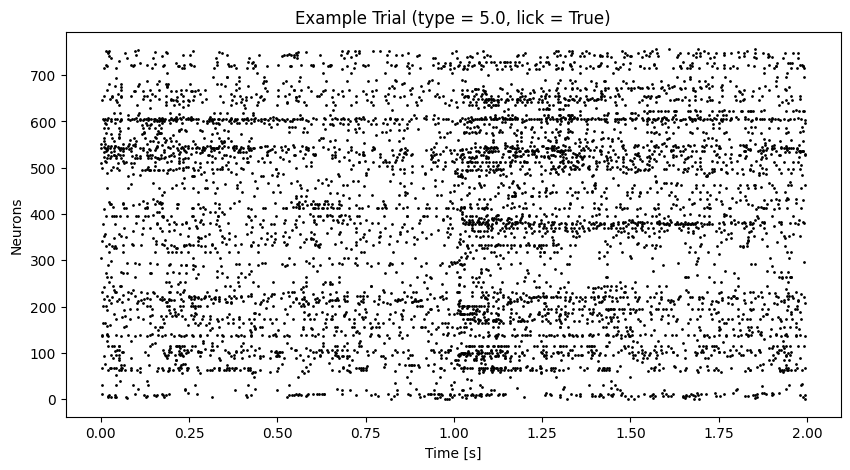

In [9]:
plt.figure(figsize=(10, 5))
sptns, sptms = np.where(spikes[0] == 1)
plt.scatter(sptms*0.002, sptns, s=1, c="k")
plt.xlabel("Time [s]")
plt.ylabel("Neurons")
plt.title(f"Example Trial (type = {trial_type[0]}, lick = {lick[0]})")

In [19]:
def running_average(tensor, window_size):
    """
    Compute the running average for the spike tensor

    Parameters:
    tensor (np.ndarray): Spike tensor
    window_size (int): Size of the moving window
    """
    cumsum = np.cumsum(tensor, axis=2)
    # cumsum = np.insert(cumsum, 0, 0, axis=2)
    return (cumsum[..., window_size:] - cumsum[..., :-window_size]) / window_size

In [24]:
window_time = 0.1 # 100 ms
window = int(window_time // timestep)
spikes_time_avg = running_average(spikes, window)

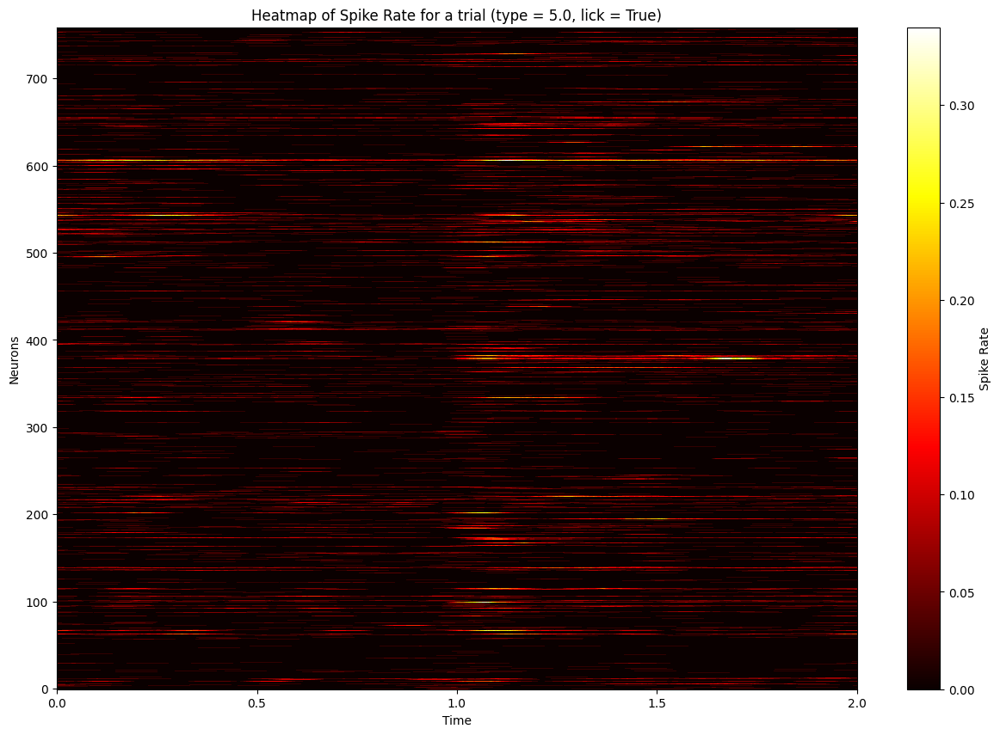

In [25]:
plt.figure(figsize=(15, 10))
plt.imshow(spikes_time_avg[0], aspect='auto', cmap='hot', interpolation='nearest')
plt.colorbar(label='Spike Rate')
plt.xlabel('Time')
plt.ylabel('Neurons')
plt.title(f'Heatmap of Spike Rate for a trial (type = {trial_type[0]}, lick = {lick[0]})')
plt.xticks(ticks=np.linspace(0, spikes_time_avg.shape[2], num=5), labels=np.linspace(0, 2, num=5))
plt.gca().invert_yaxis()
plt.show()

Area: A1, Excitatory: True


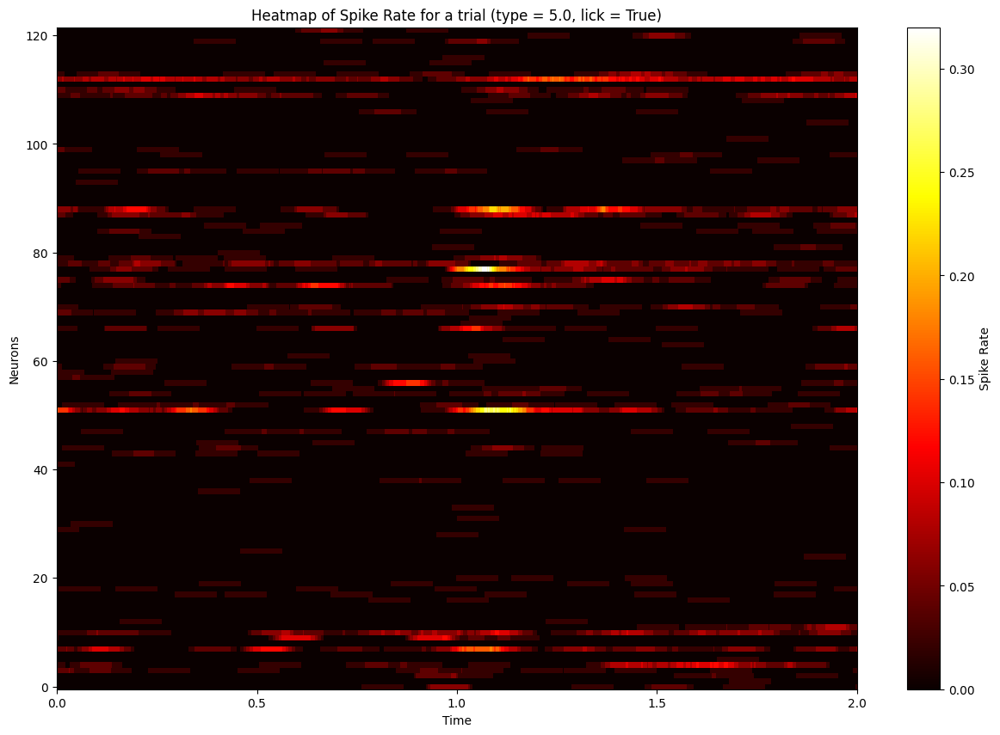

Area: A1, Excitatory: False


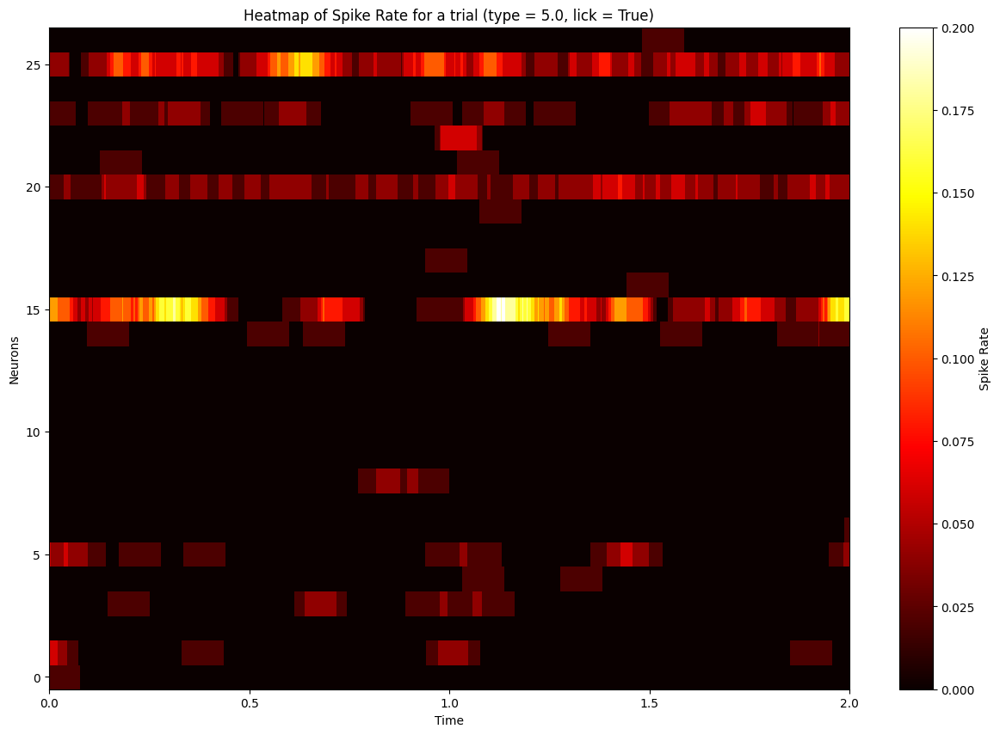

Area: ALM, Excitatory: True


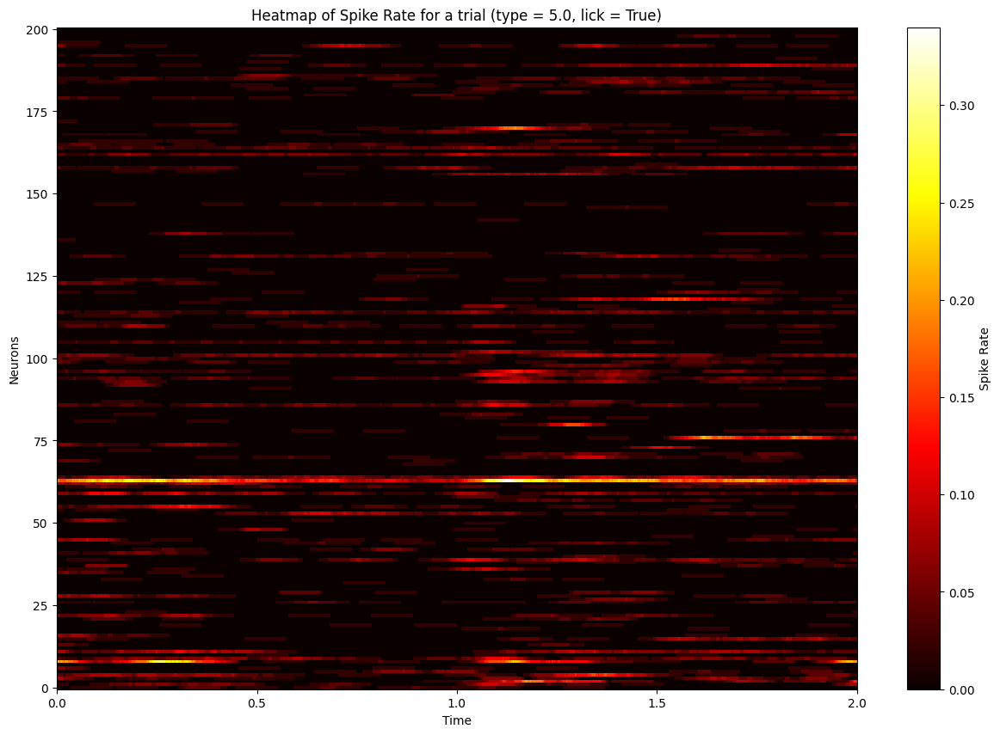

Area: ALM, Excitatory: False


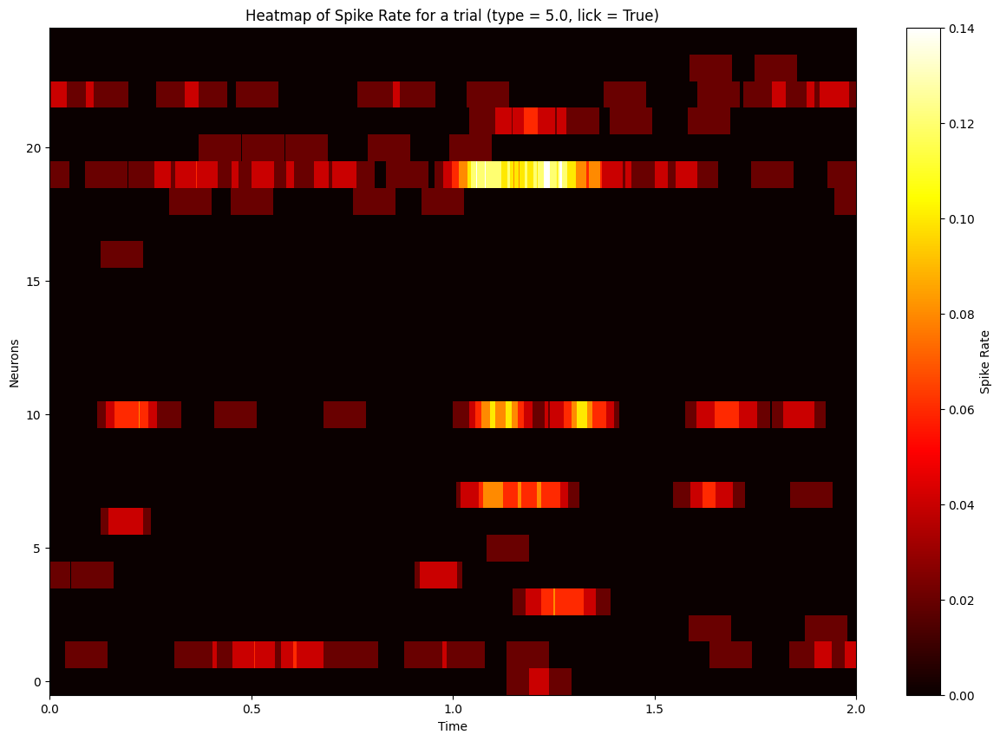

Area: wM2, Excitatory: True


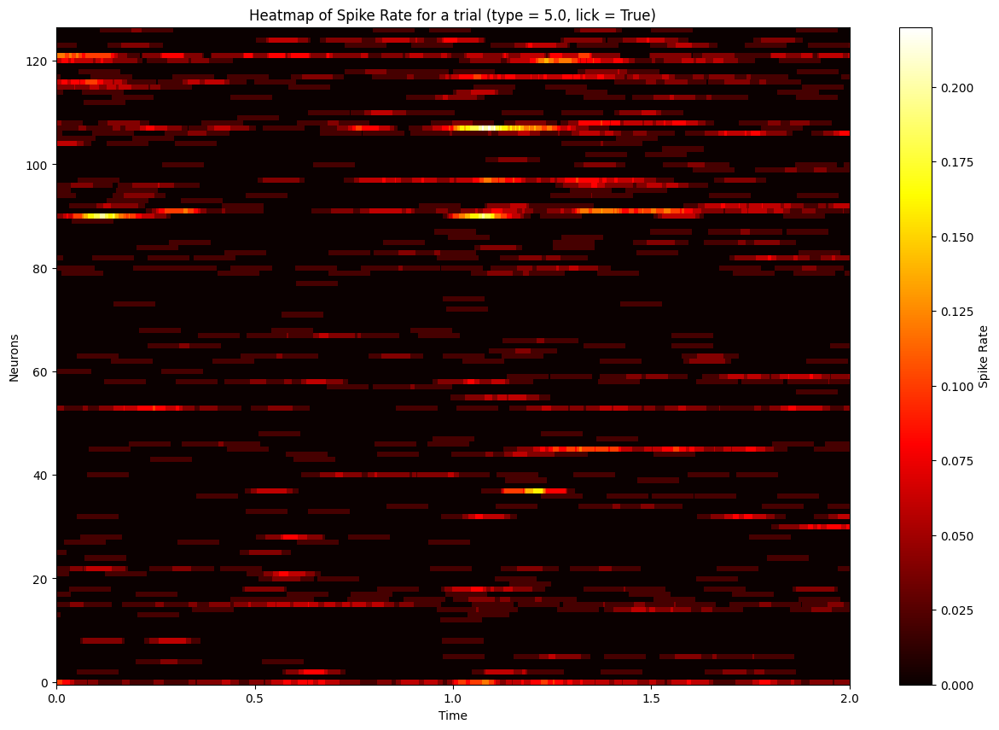

Area: wM2, Excitatory: False


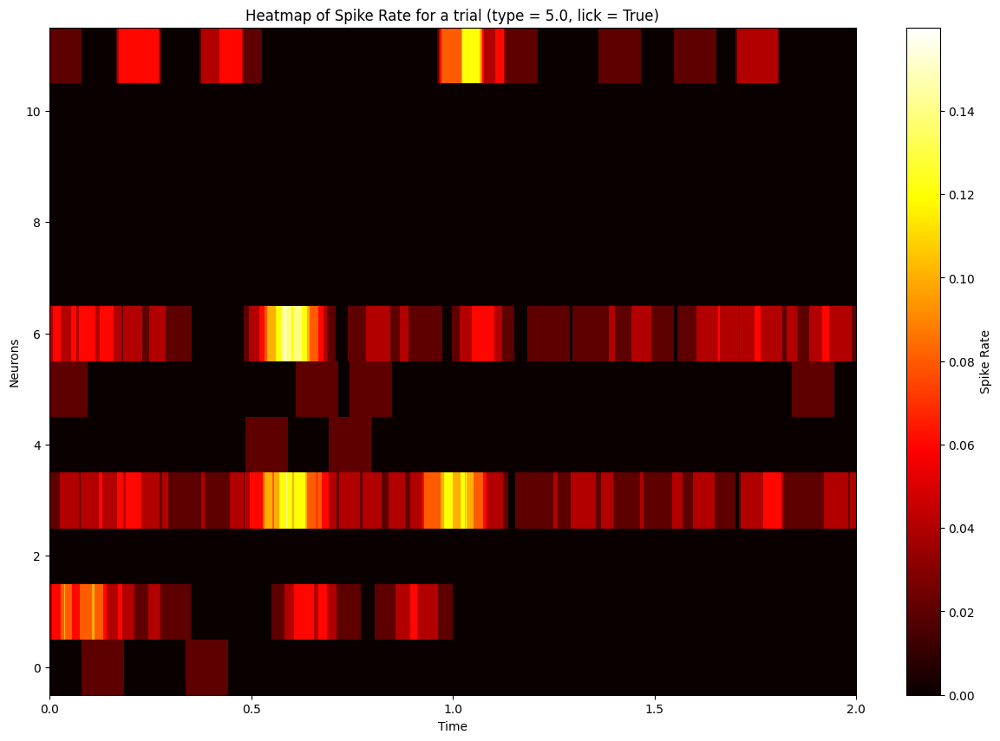

Area: wS1, Excitatory: True


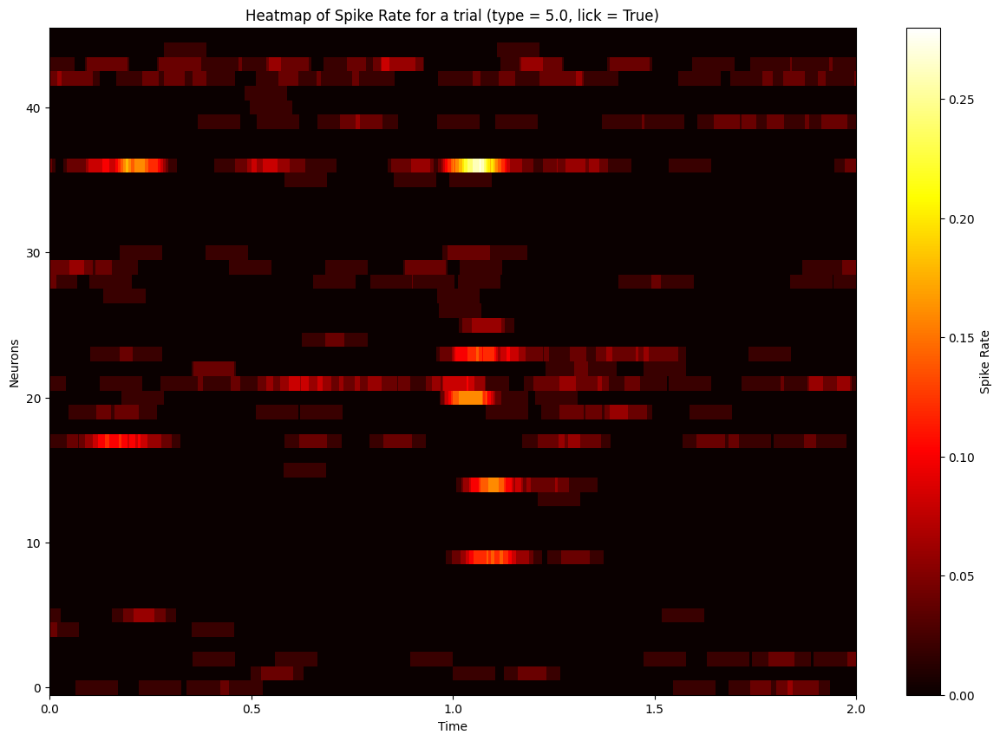

Area: wS1, Excitatory: False


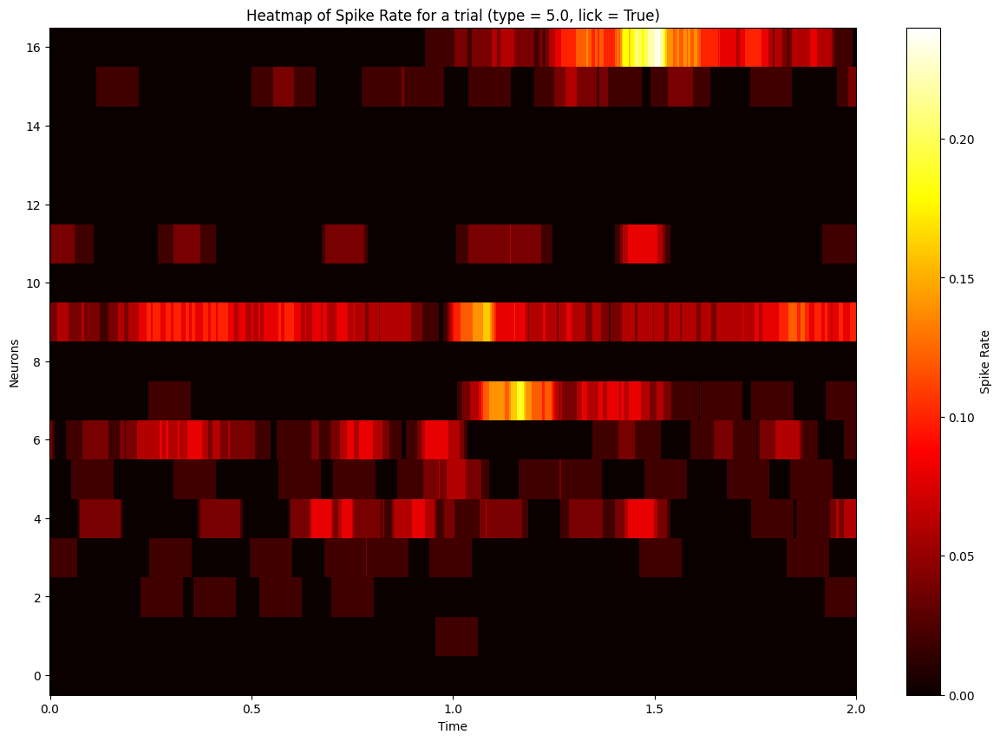

Area: wS2, Excitatory: True


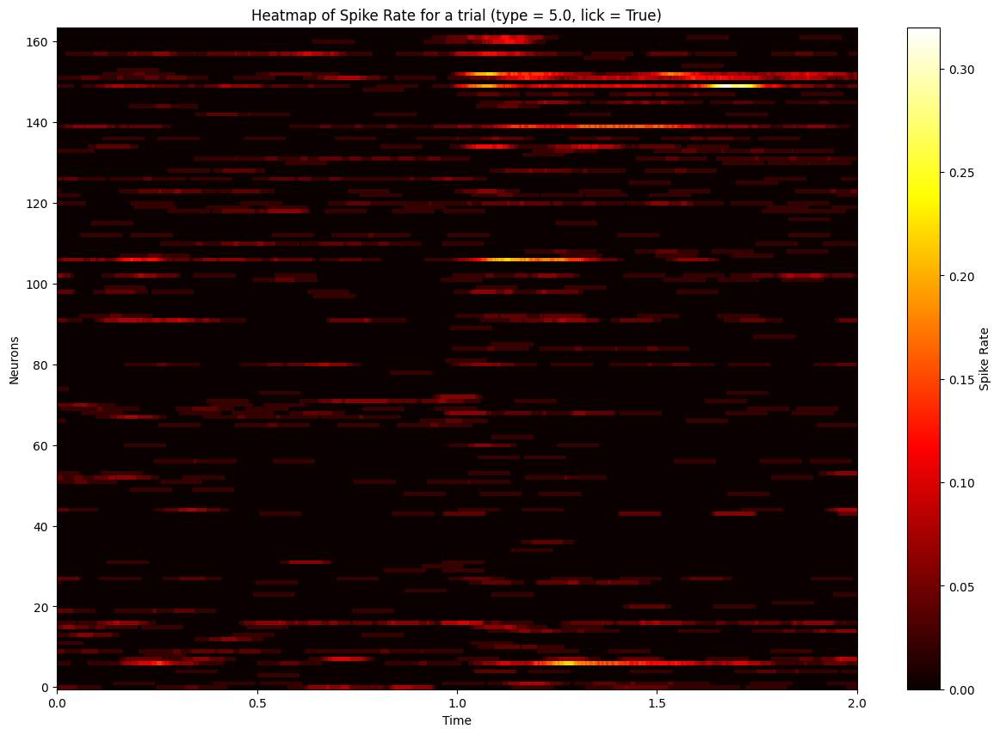

Area: wS2, Excitatory: False


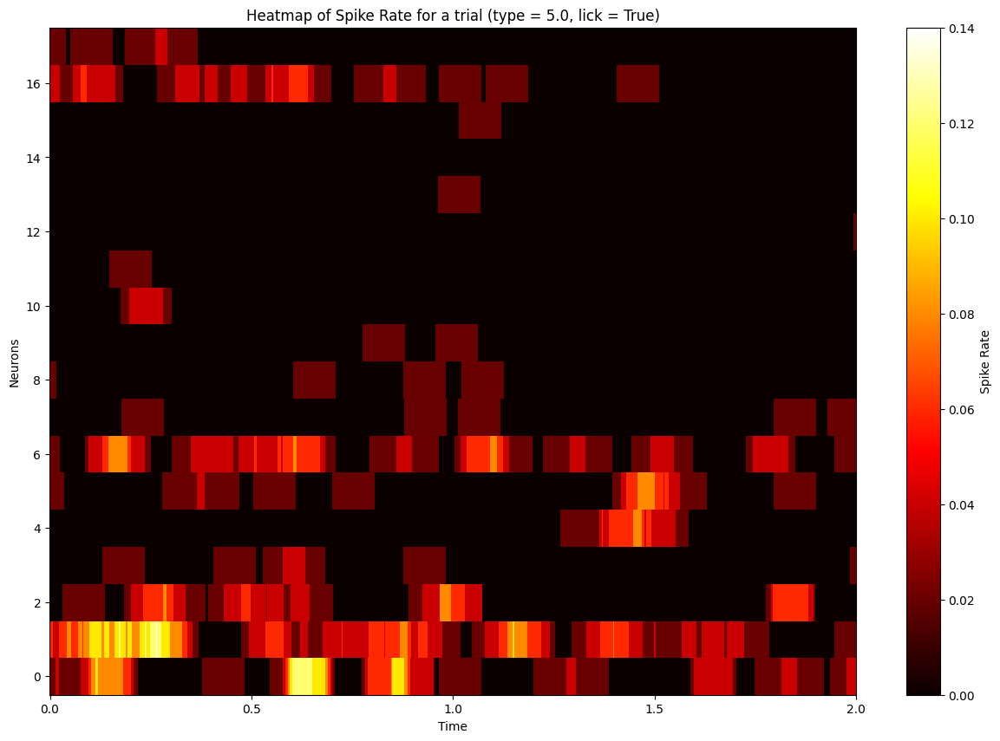

In [27]:
trial_index = 0
areas = np.unique(cluster_info['area'])
for area in areas:
    area_mask = cluster_info['area'] == area
    for excitatory in [True, False]:
        mask = area_mask & (cluster_info['excitatory'] == excitatory)
        if np.sum(mask) == 0:
            continue
        print(f"Area: {area}, Excitatory: {excitatory}")
        plt.figure(figsize=(15, 10))
        plt.imshow(spikes_time_avg[trial_index][mask], aspect='auto', cmap='hot', interpolation='nearest')
        plt.colorbar(label='Spike Rate')
        plt.xlabel('Time')
        plt.ylabel('Neurons')
        plt.title(f'Heatmap of Spike Rate for a trial (type = {trial_type[0]}, lick = {lick[0]})')
        plt.xticks(ticks=np.linspace(0, spikes_time_avg.shape[2], num=5), labels=np.linspace(0, 2, num=5))
        plt.gca().invert_yaxis()
        plt.show()

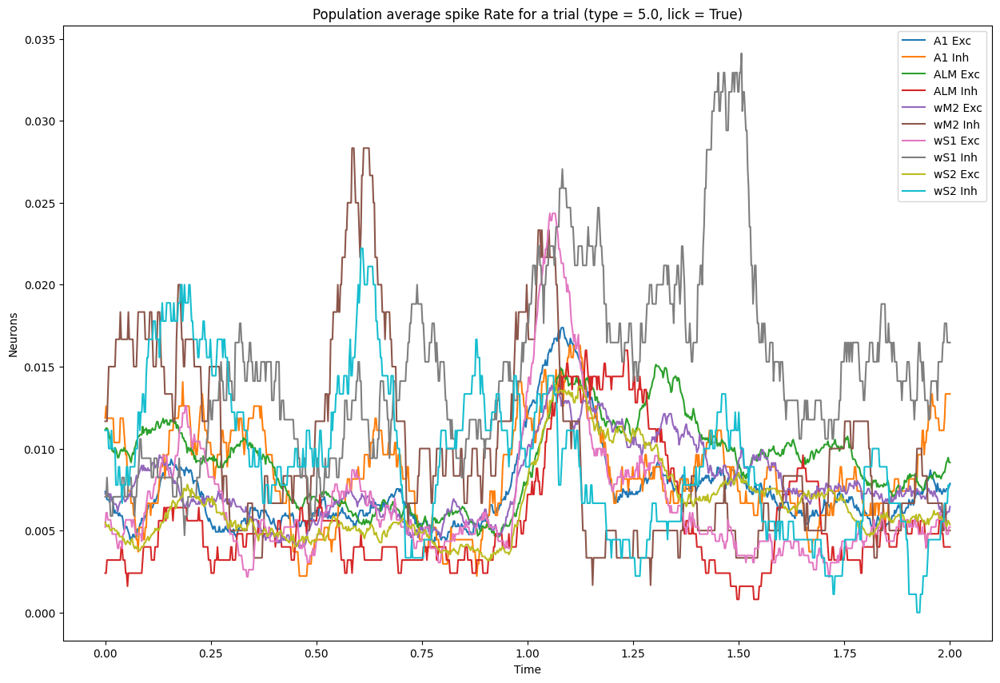

In [31]:
trial_index = 0
areas = np.unique(cluster_info['area'])
plt.figure(figsize=(15, 10))
for area in areas:
    area_mask = cluster_info['area'] == area
    for excitatory in [True, False]:
        mask = area_mask & (cluster_info['excitatory'] == excitatory)
        if np.sum(mask) == 0:
            continue
        plt.plot(np.linspace(0, 2, spikes_time_avg.shape[2]), np.mean(spikes_time_avg[trial_index][mask], axis=0), label=f"{area} {'Exc' if excitatory else 'Inh'}")
        
plt.xlabel('Time')
plt.ylabel('Neurons')
plt.title(f'Population average spike Rate for a trial (type = {trial_type[0]}, lick = {lick[0]})')
plt.legend()
plt.show()

In [34]:
def display_trial(trial_index):
    areas = np.unique(cluster_info['area'])
    plt.figure(figsize=(15, 10))
    for area in areas:
        area_mask = cluster_info['area'] == area
        for excitatory in [True, False]:
            mask = area_mask & (cluster_info['excitatory'] == excitatory)
            if np.sum(mask) == 0:
                continue
            plt.plot(np.linspace(0, 2, spikes_time_avg.shape[2]), np.mean(spikes_time_avg[trial_index][mask], axis=0), label=f"{area} {'Exc' if excitatory else 'Inh'}")
            
    plt.xlabel('Time')
    plt.ylabel('Neurons')
    plt.title(f'Population average spike Rate for a trial (type = {trial_type[trial_index]}, lick = {lick[trial_index]})')
    plt.legend()
    plt.show()

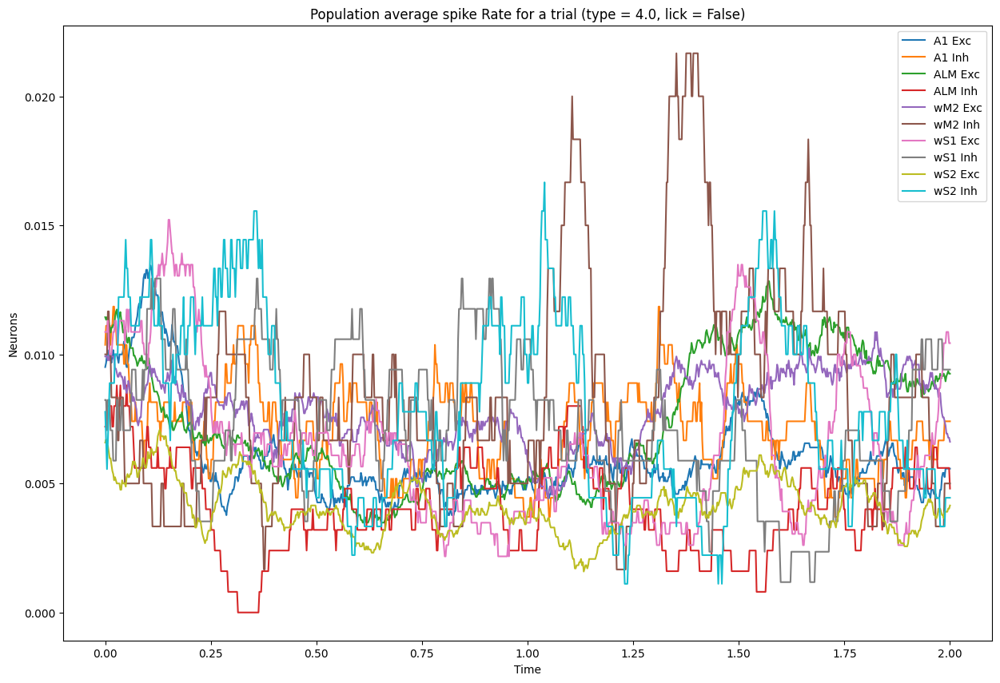

In [36]:
display_trial(1)

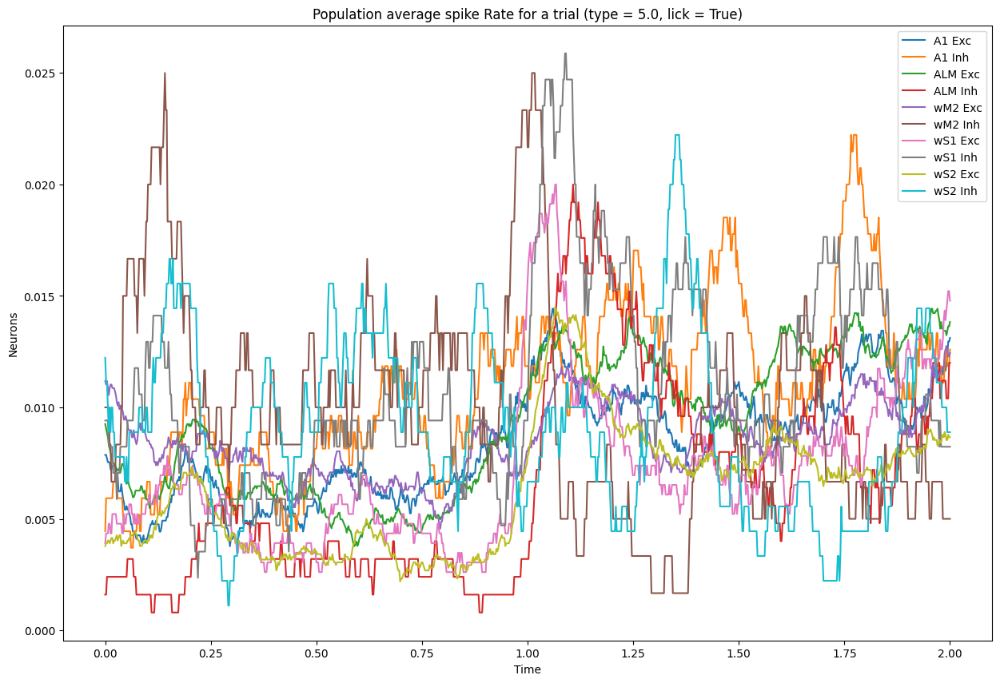

In [37]:
display_trial(2)

In [53]:
def display_trial_with_sd(trial_index, areas=None):
    areas = np.unique(cluster_info['area']) if areas is None else areas
    plt.figure(figsize=(15, 10))
    time = np.linspace(0, 2, spikes_time_avg.shape[2])
    for area in areas:
        area_mask = cluster_info['area'] == area
        for excitatory in [True, False]:
            mask = area_mask & (cluster_info['excitatory'] == excitatory)
            if np.sum(mask) == 0:
                continue
            pop_avg_spike_rate = np.mean(spikes_time_avg[trial_index][mask], axis=0)
            pop_std_spike_rate = np.std(spikes_time_avg[trial_index][mask], axis=0)
            plt.plot(time, pop_avg_spike_rate, label=f"{area} {'Exc' if excitatory else 'Inh'}")
            plt.fill_between(time, np.clip(pop_avg_spike_rate - pop_std_spike_rate, 0, np.infty), pop_avg_spike_rate + pop_std_spike_rate, alpha=0.3)
            
    plt.xlabel('Time')
    plt.ylabel('Neurons')
    plt.title(f'Population average spike Rate for a trial (type = {trial_type[trial_index]}, lick = {lick[trial_index]})')
    plt.legend()
    plt.show()

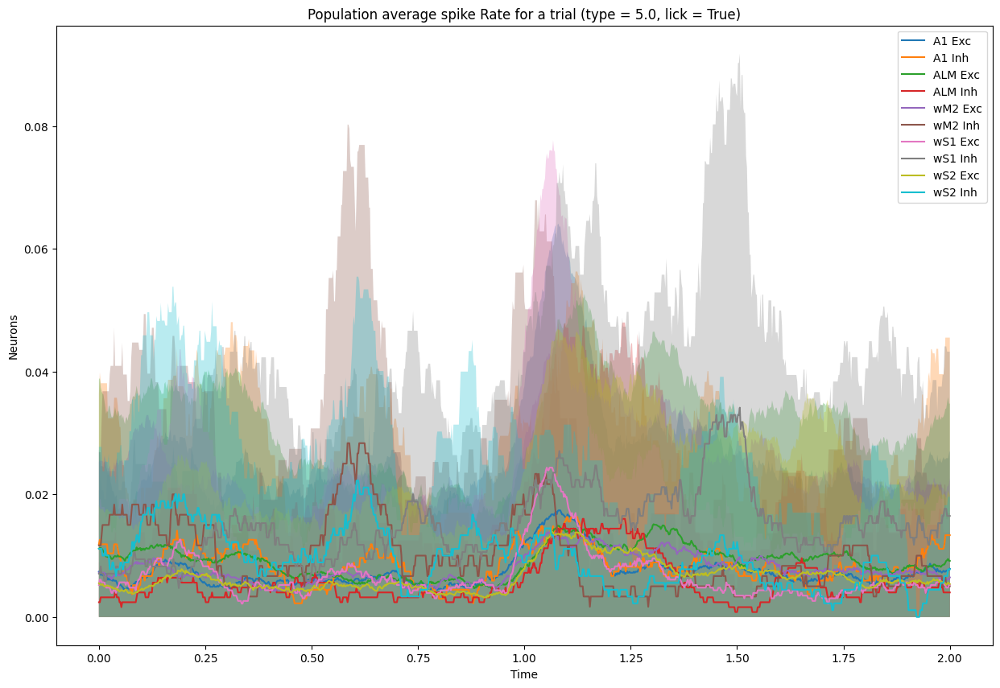

In [54]:
display_trial_with_sd(0)

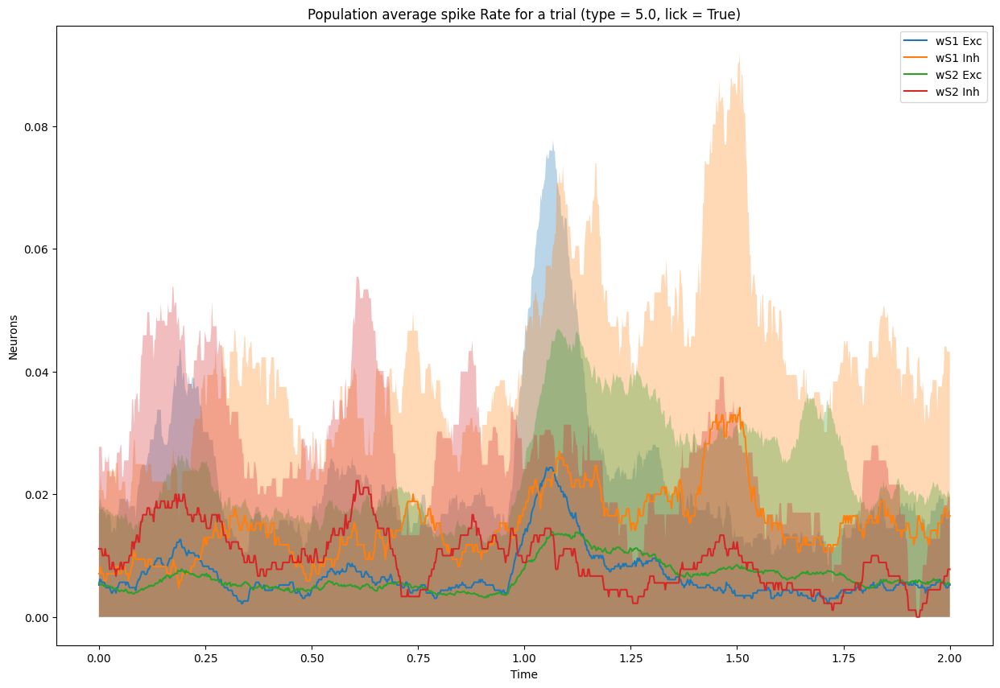

In [55]:
display_trial_with_sd(0, areas=['wS1', 'wS2'])

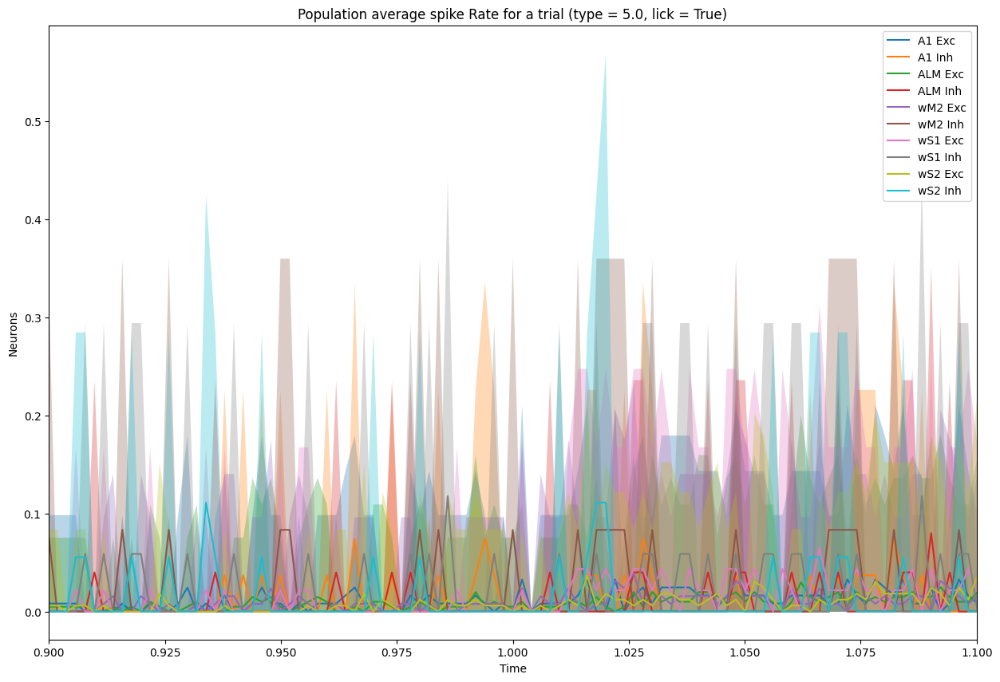

In [59]:
trial_index = 0
plt.figure(figsize=(15, 10))
time = np.linspace(0, 2, spikes.shape[2])
for area in areas:
    area_mask = cluster_info['area'] == area
    for excitatory in [True, False]:
        mask = area_mask & (cluster_info['excitatory'] == excitatory)
        if np.sum(mask) == 0:
            continue
        pop_avg_spike_rate = np.mean(spikes[trial_index][mask], axis=0)
        pop_std_spike_rate = np.std(spikes[trial_index][mask], axis=0)
        plt.plot(time, pop_avg_spike_rate, label=f"{area} {'Exc' if excitatory else 'Inh'}")
        plt.fill_between(time, np.clip(pop_avg_spike_rate - pop_std_spike_rate, 0, np.infty), pop_avg_spike_rate + pop_std_spike_rate, alpha=0.3)
        
plt.xlabel('Time')
plt.ylabel('Neurons')
plt.title(f'Population average spike Rate for a trial (type = {trial_type[trial_index]}, lick = {lick[trial_index]})')
plt.xlim(0.9, 1.1)
plt.legend()
plt.show()

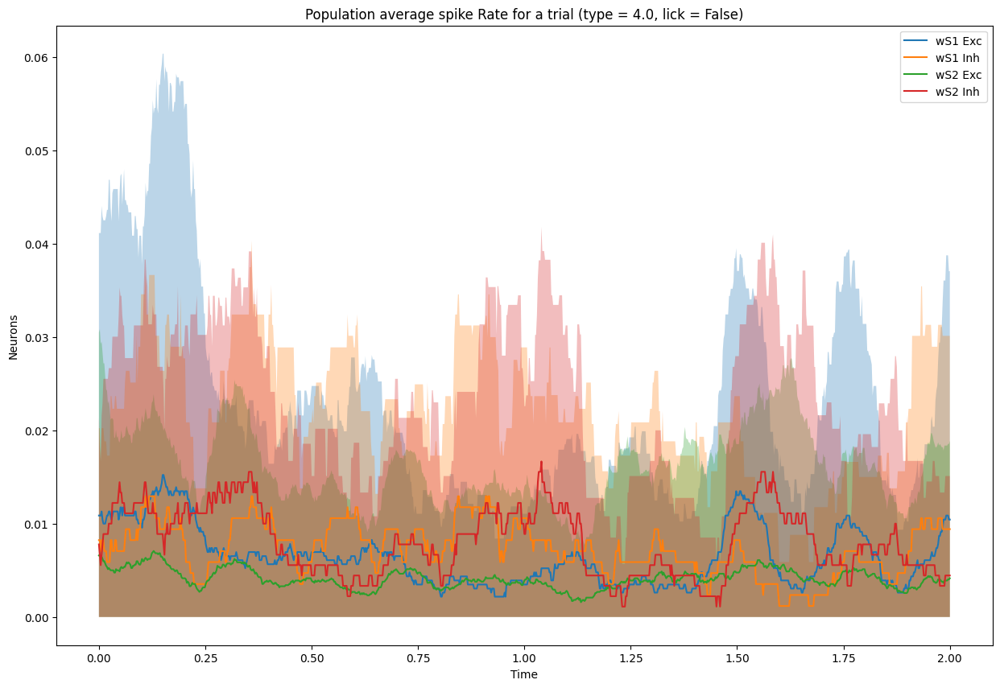

In [60]:
display_trial_with_sd(1, areas=['wS1', 'wS2'])

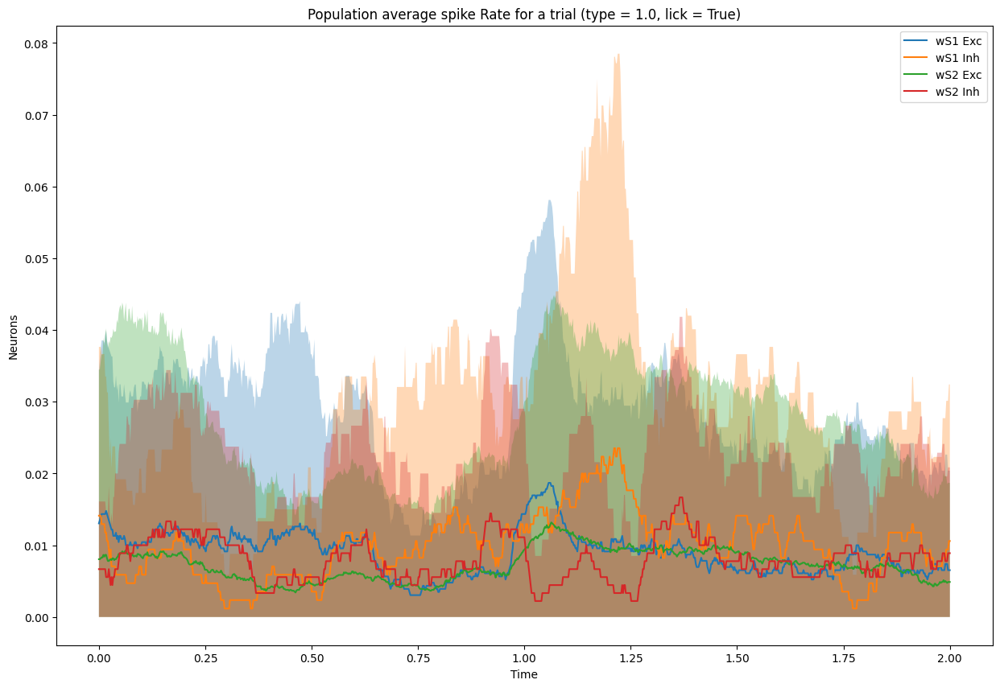

In [63]:
display_trial_with_sd(4, areas=['wS1', 'wS2'])

In [72]:
def display_PSTH(trial_mask=None, areas=None, title_trial=""):
    spikes_trial_avg = np.mean(spikes, axis=0) if trial_mask is None else np.mean(spikes[trial_mask], axis=0)
    areas = np.unique(cluster_info['area']) if areas is None else areas
    plt.figure(figsize=(15, 10))
    time = np.linspace(0, 2, spikes_trial_avg.shape[-1])
    for area in areas:
        area_mask = cluster_info['area'] == area
        for excitatory in [True, False]:
            mask = area_mask & (cluster_info['excitatory'] == excitatory)
            if np.sum(mask) == 0:
                continue
            pop_avg_spike_rate = np.mean(spikes_trial_avg[mask], axis=0)
            pop_std_spike_rate = np.std(spikes_trial_avg[mask], axis=0)
            plt.plot(time, pop_avg_spike_rate, label=f"{area} {'Exc' if excitatory else 'Inh'}")
            plt.fill_between(time, np.clip(pop_avg_spike_rate - pop_std_spike_rate, 0, np.infty), pop_avg_spike_rate + pop_std_spike_rate, alpha=0.3)
            
    plt.xlabel('Time')
    plt.ylabel('Neurons')
    plt.title(f'Population average spike Rate across trials {title_trial}')
    plt.legend()
    plt.show()

## Hit trials

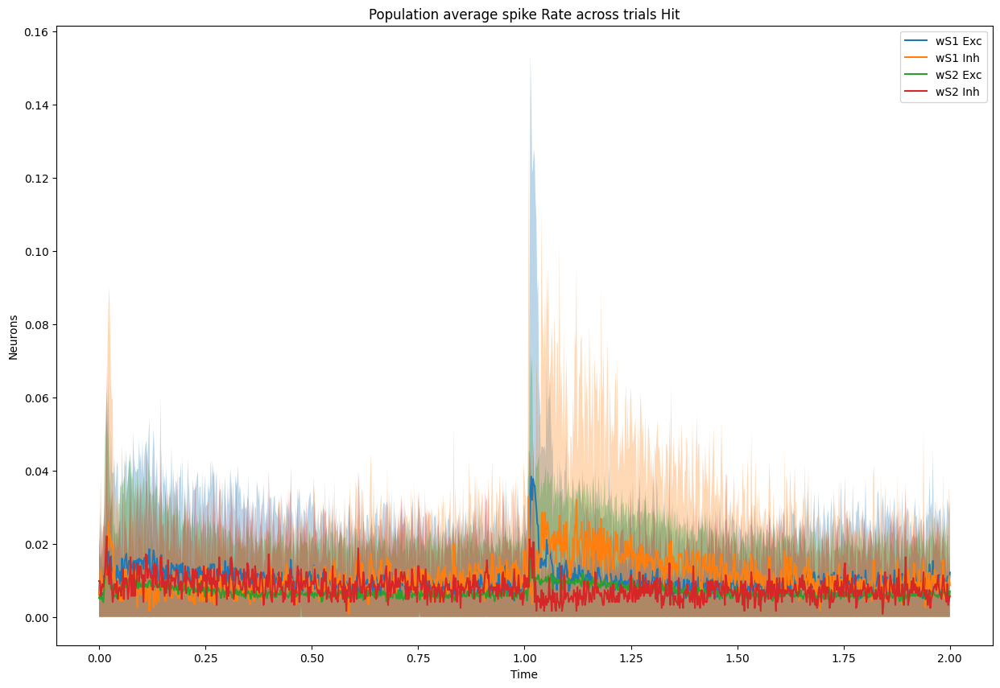

In [73]:
trial_mask = np.logical_and(trial_info['trial_type'] == 1, trial_info['lick'] == 1)
display_PSTH(trial_mask, areas=['wS1', 'wS2'], title_trial="Hit")

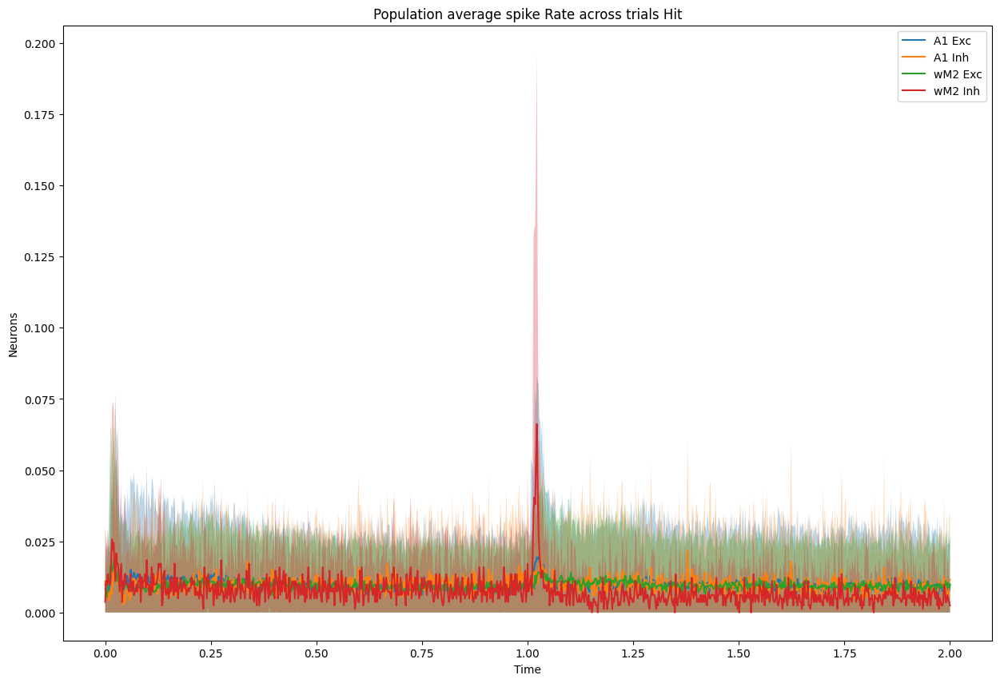

In [75]:
display_PSTH(trial_mask, areas=['A1','wM2'], title_trial="Hit")

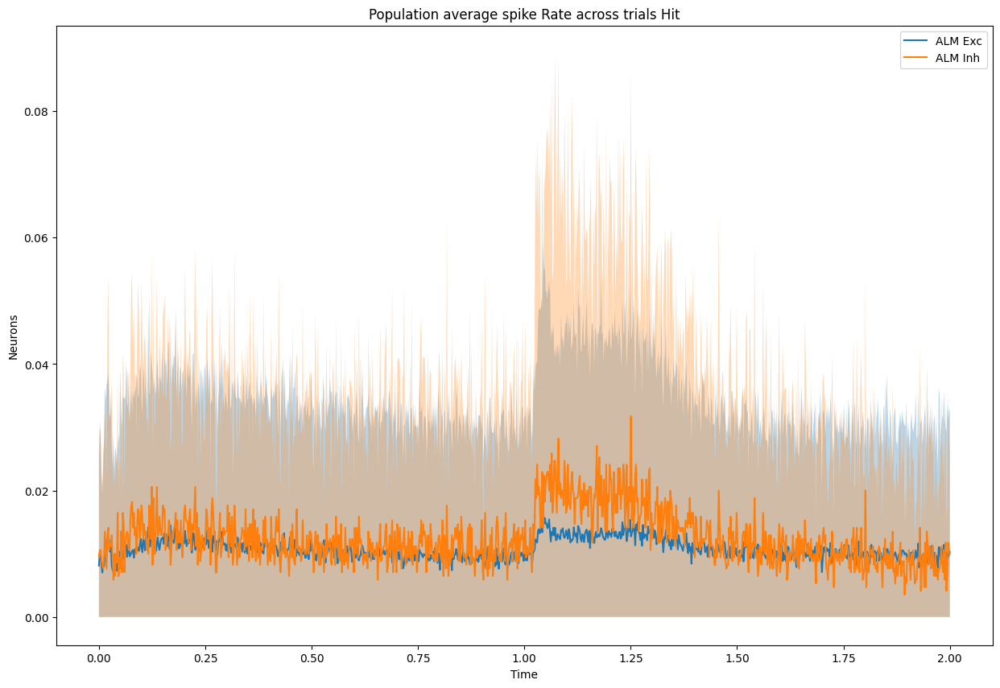

In [76]:
display_PSTH(trial_mask, areas=['ALM'], title_trial="Hit")

## Miss Trials

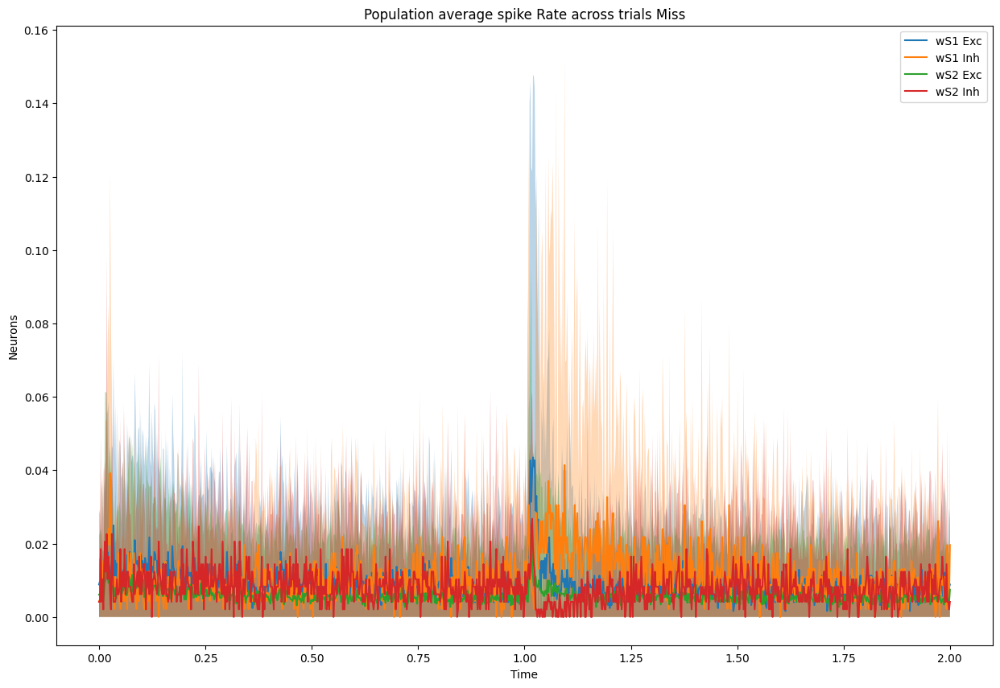

In [80]:
trial_mask = np.logical_and(trial_info['trial_type'] == 1, trial_info['lick'] == 0)
display_PSTH(trial_mask, areas=['wS1', 'wS2'], title_trial="Miss")

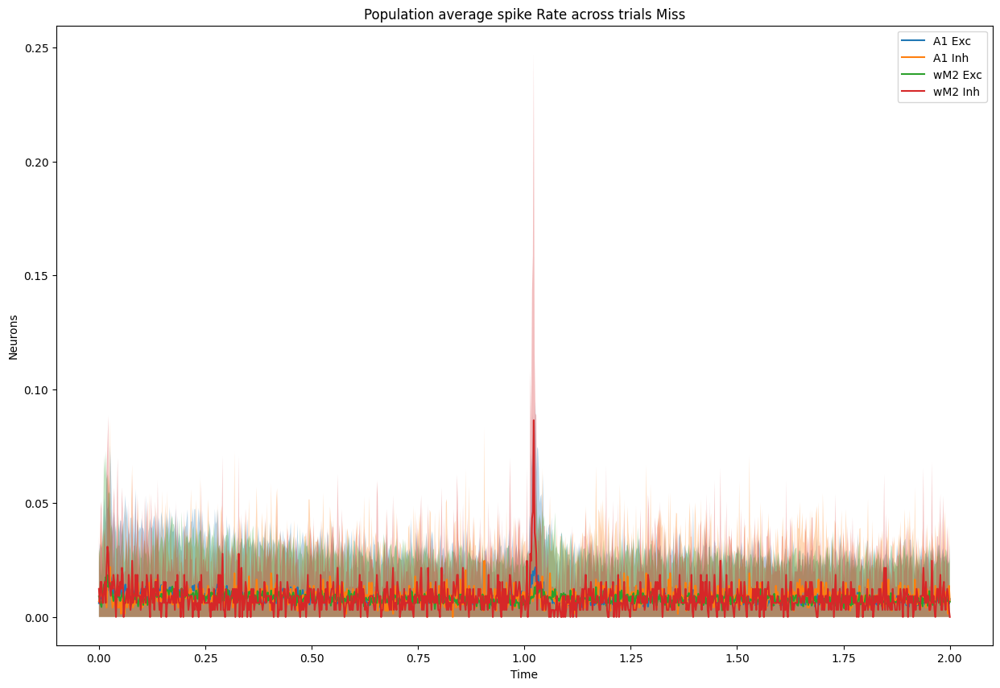

In [81]:
display_PSTH(trial_mask, areas=['A1', 'wM2'], title_trial="Miss")

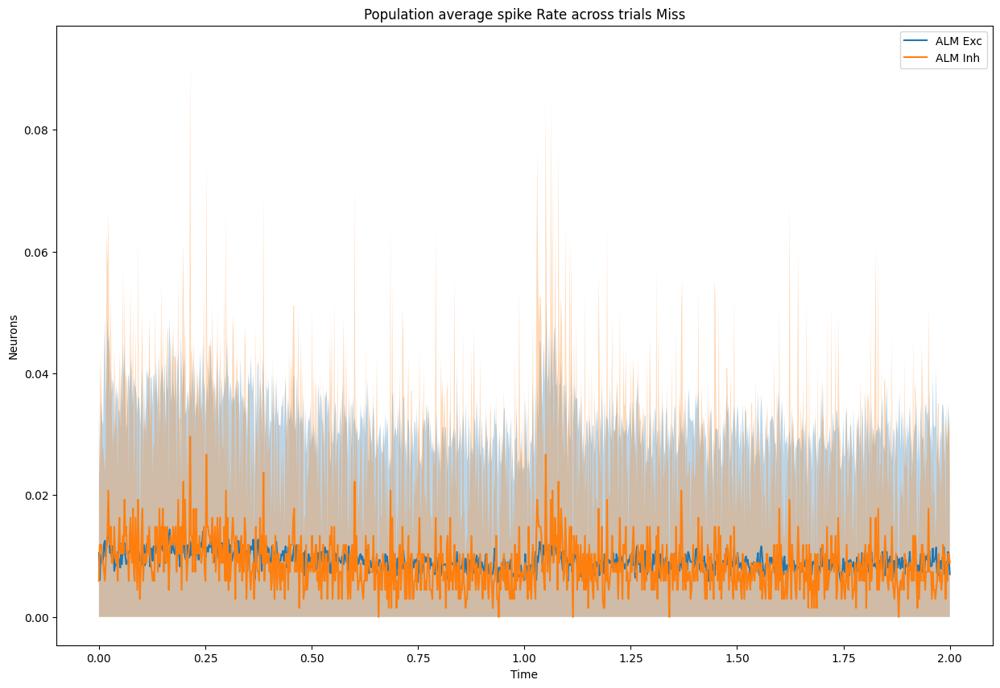

In [82]:
display_PSTH(trial_mask, areas=['ALM'], title_trial="Miss")

## False Alarm (tone + whisker)

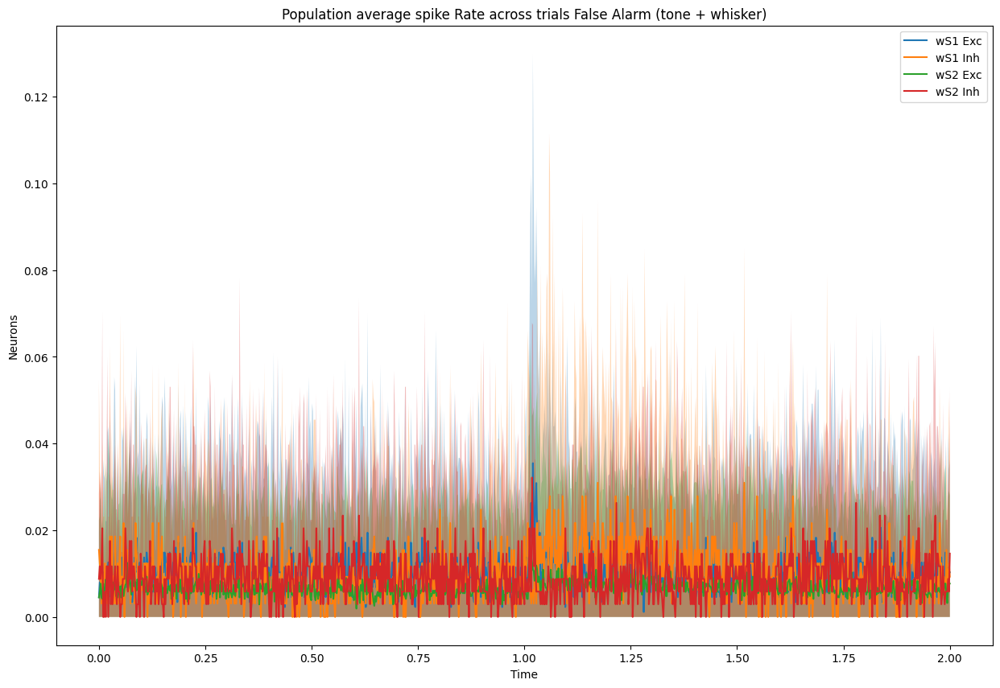

In [83]:
trial_mask = np.logical_and(trial_info['trial_type'] == 3, trial_info['lick'] == 1)
display_PSTH(trial_mask, areas=['wS1', 'wS2'], title_trial="False Alarm (tone + whisker)")

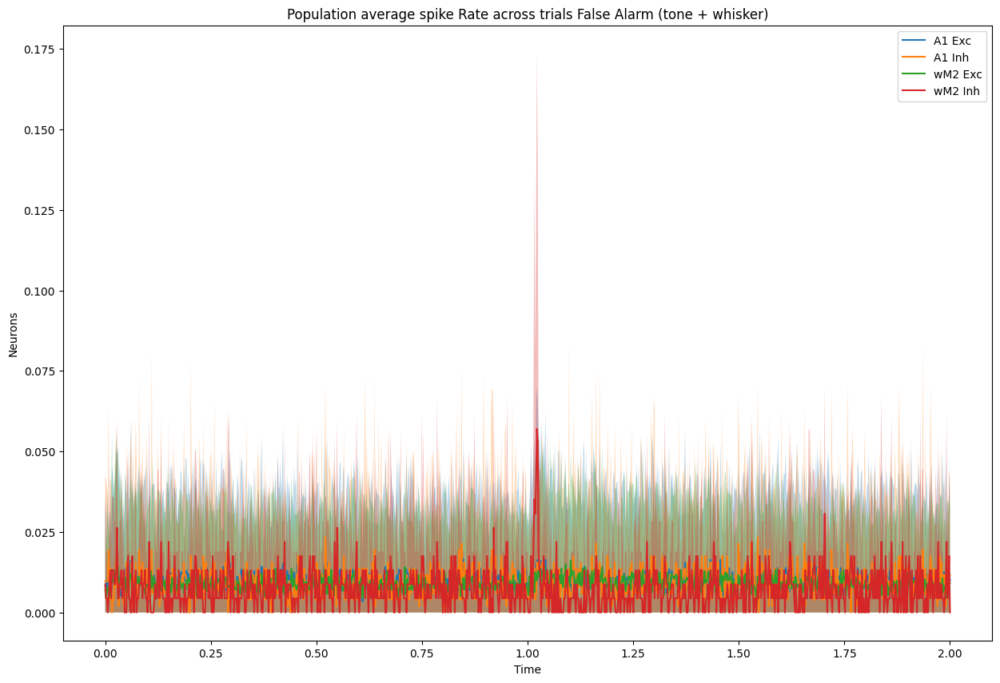

In [84]:
display_PSTH(trial_mask, areas=['A1', 'wM2'], title_trial="False Alarm (tone + whisker)")

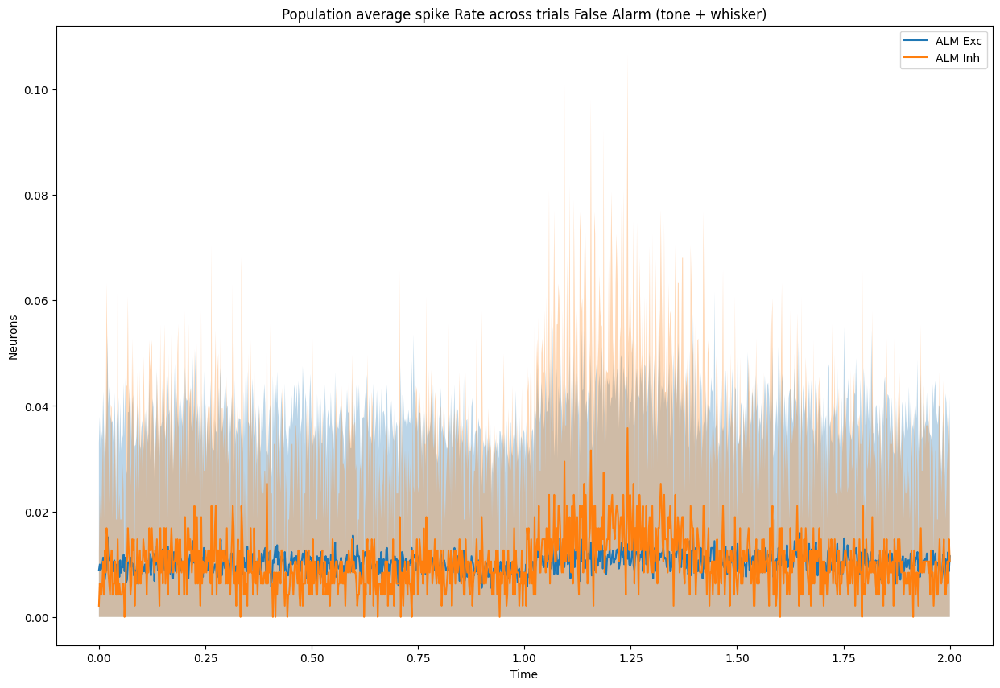

In [85]:
display_PSTH(trial_mask, areas=['ALM'], title_trial="False Alarm (tone + whisker)")

## False Alarm (tone)

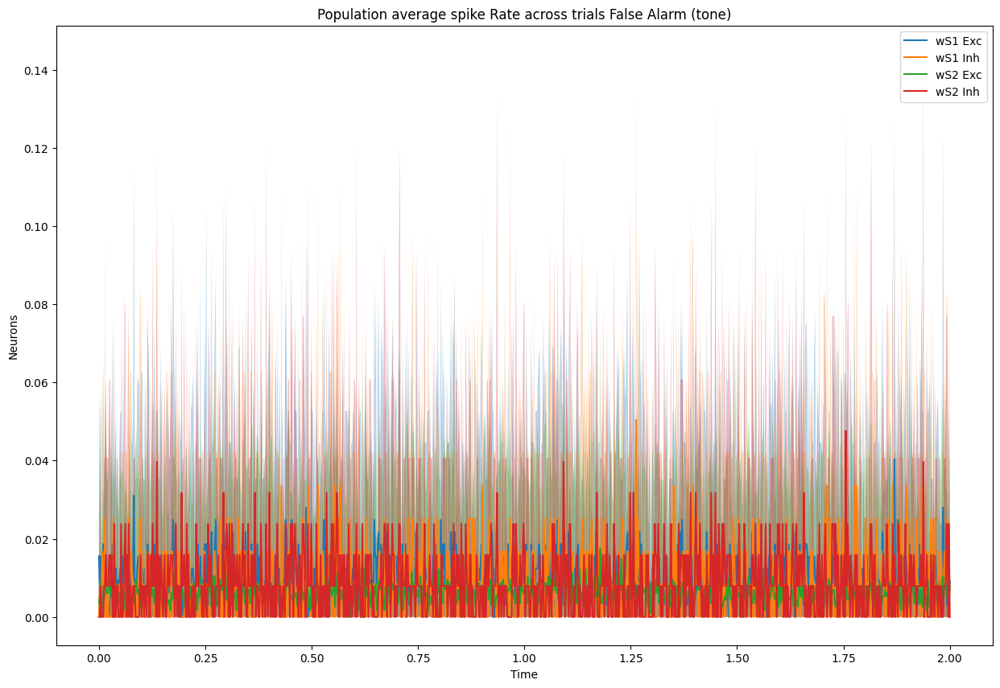

In [86]:
trial_mask = np.logical_and(trial_info['trial_type'] == 4, trial_info['lick'] == 1)
display_PSTH(trial_mask, areas=['wS1', 'wS2'], title_trial="False Alarm (tone)")

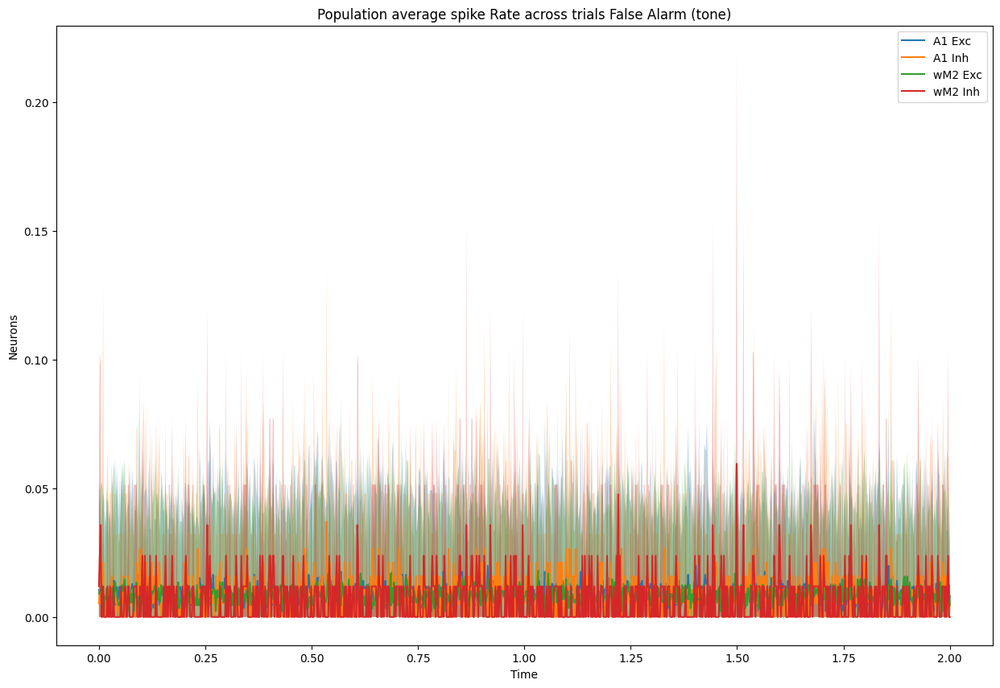

In [87]:
display_PSTH(trial_mask, areas=['A1', 'wM2'], title_trial="False Alarm (tone)")

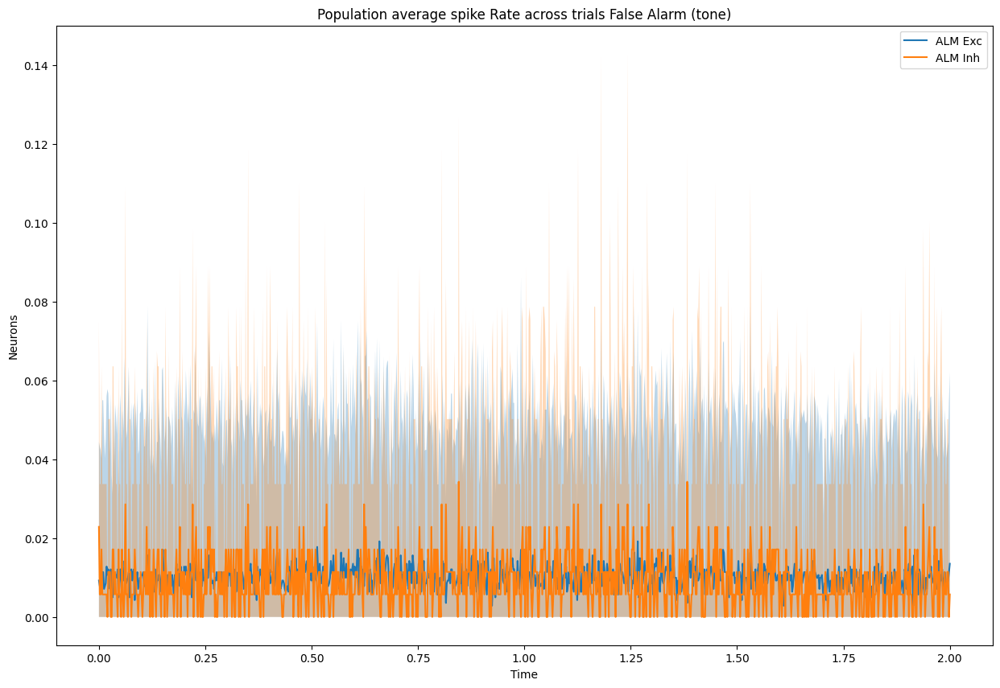

In [88]:
display_PSTH(trial_mask, areas=['ALM'], title_trial="False Alarm (tone)")

## False Alarm (whisker)

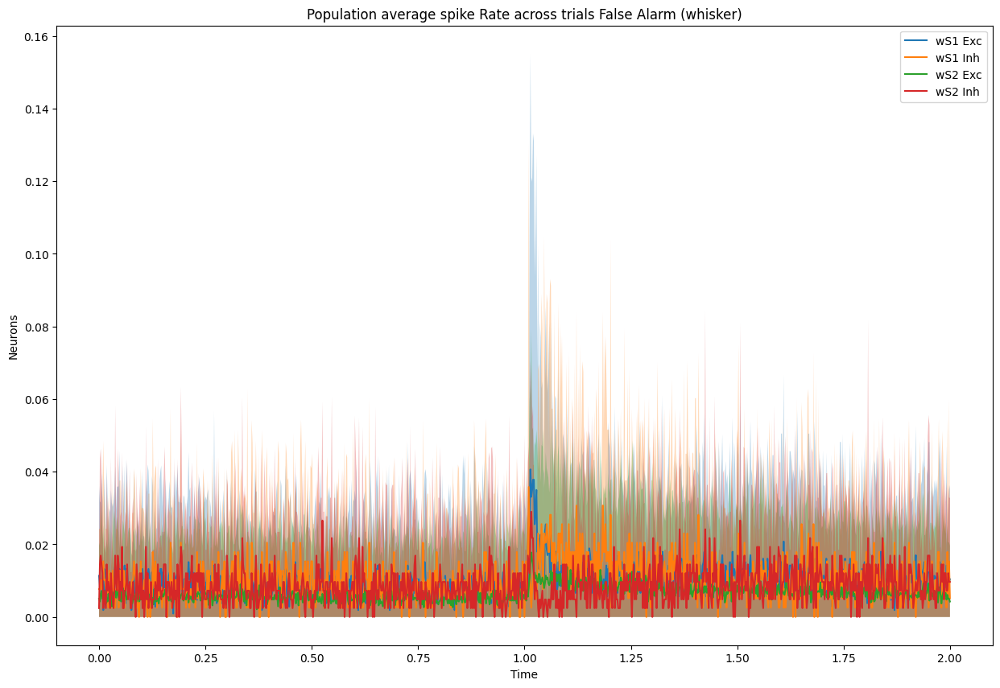

In [89]:
trial_mask = np.logical_and(trial_info['trial_type'] == 5, trial_info['lick'] == 1)
display_PSTH(trial_mask, areas=['wS1', 'wS2'], title_trial="False Alarm (whisker)")

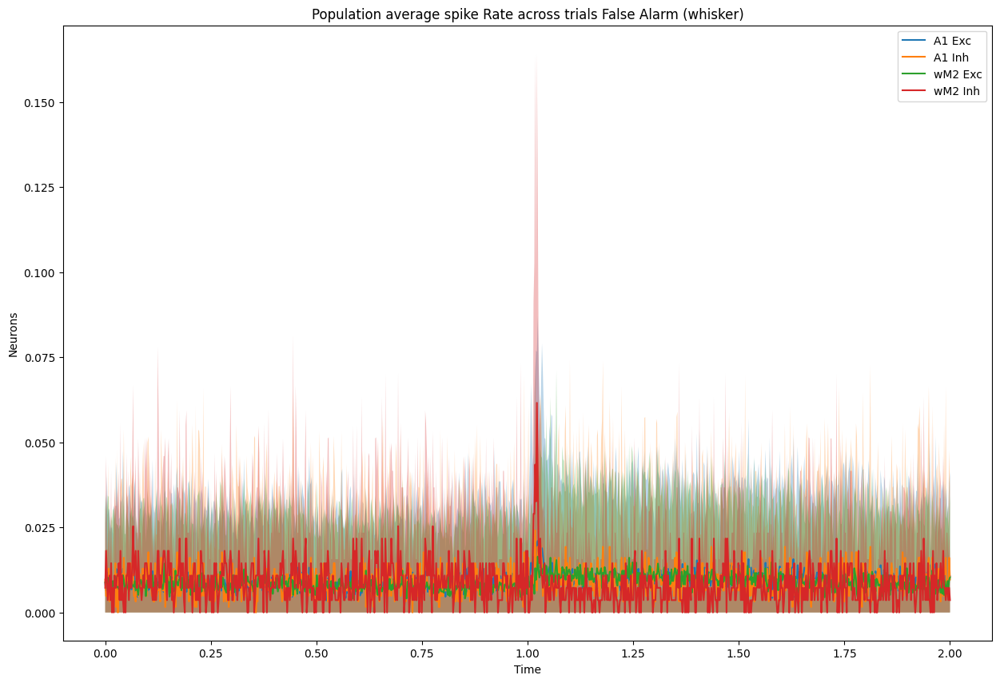

In [90]:
display_PSTH(trial_mask, areas=['A1', 'wM2'], title_trial="False Alarm (whisker)")

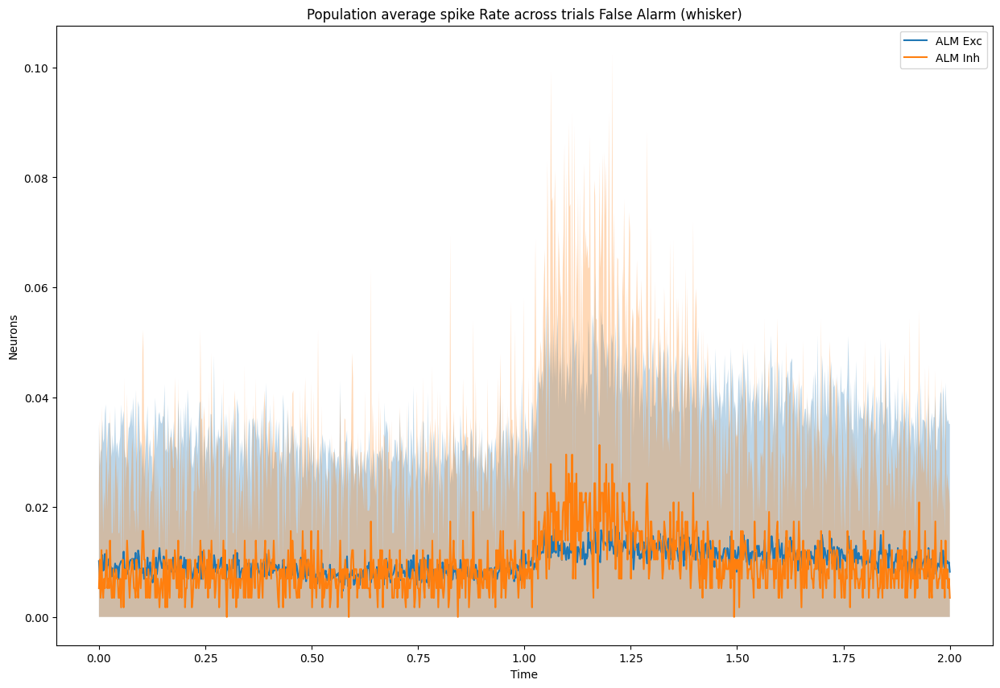

In [91]:
display_PSTH(trial_mask, areas=['ALM'], title_trial="False Alarm (whisker)")

## Correct Rejection (tone + whisker)

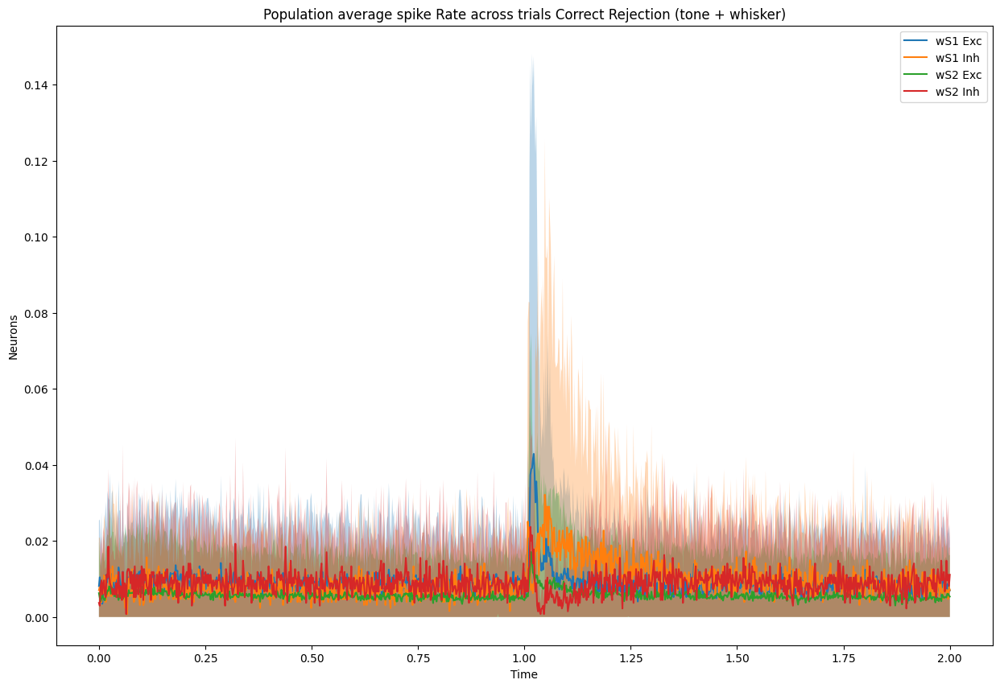

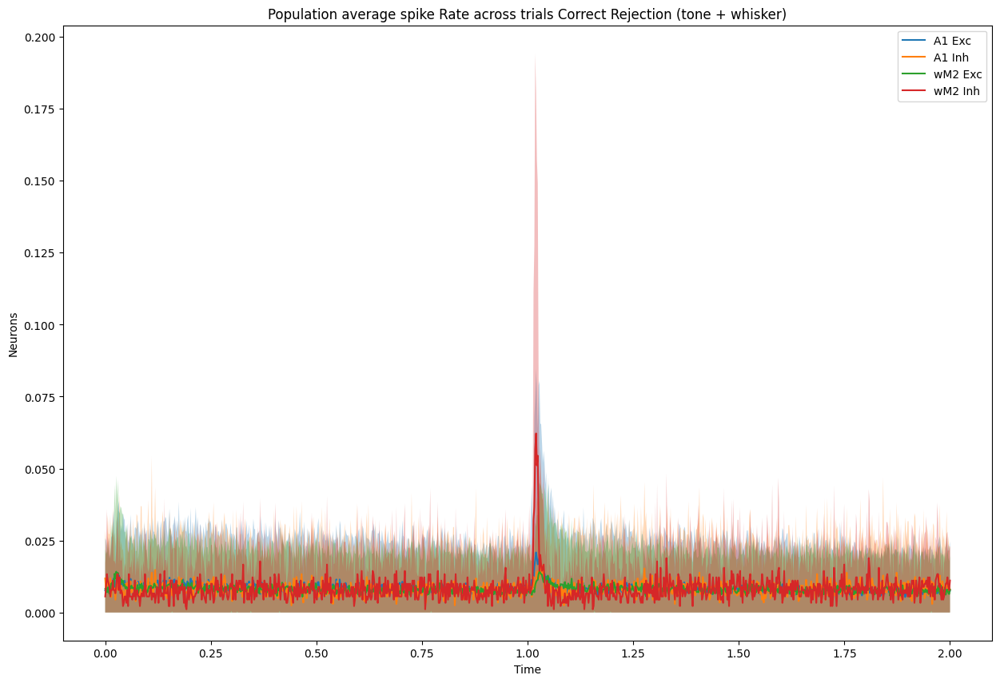

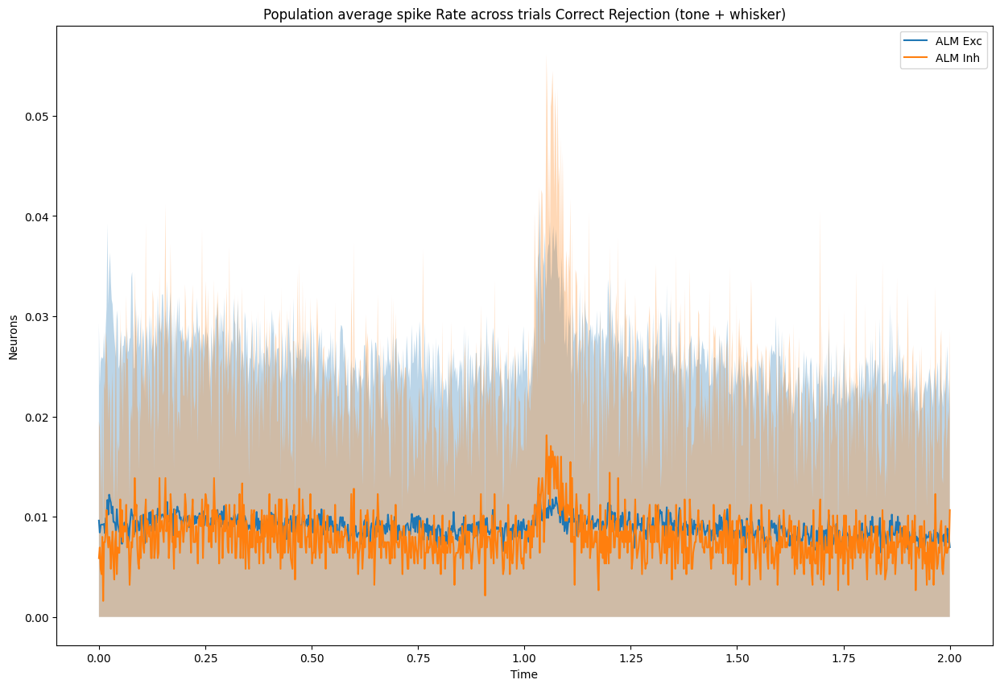

In [92]:
trial_mask = np.logical_and(trial_info['trial_type'] == 3, trial_info['lick'] == 0)
display_PSTH(trial_mask, areas=['wS1', 'wS2'], title_trial="Correct Rejection (tone + whisker)")
display_PSTH(trial_mask, areas=['A1', 'wM2'], title_trial="Correct Rejection (tone + whisker)")
display_PSTH(trial_mask, areas=['ALM'], title_trial="Correct Rejection (tone + whisker)")

## Correct Rejection (tone)

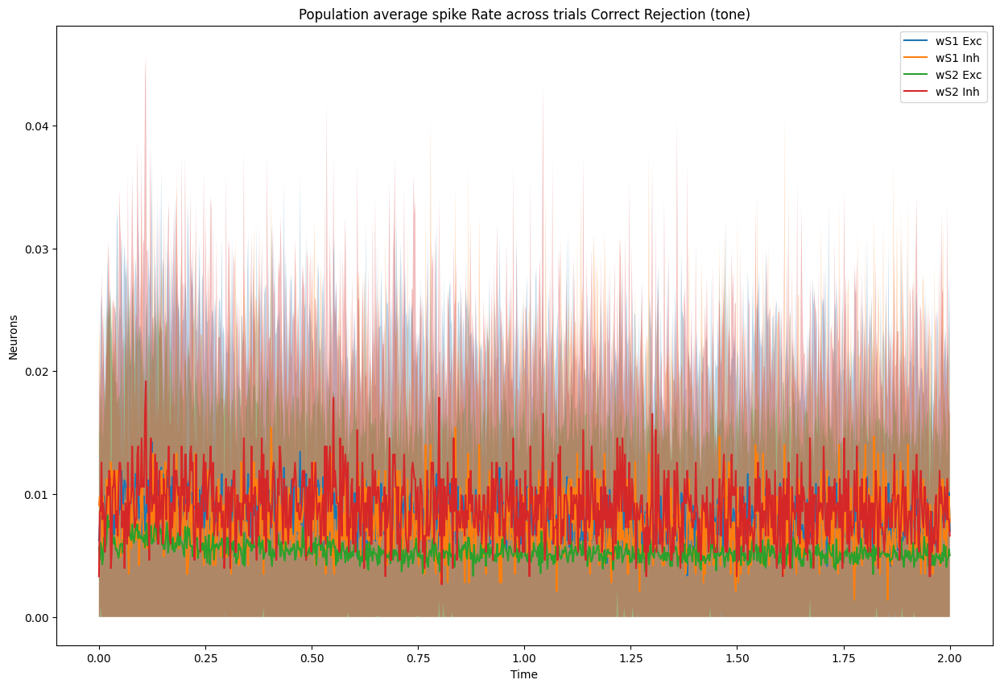

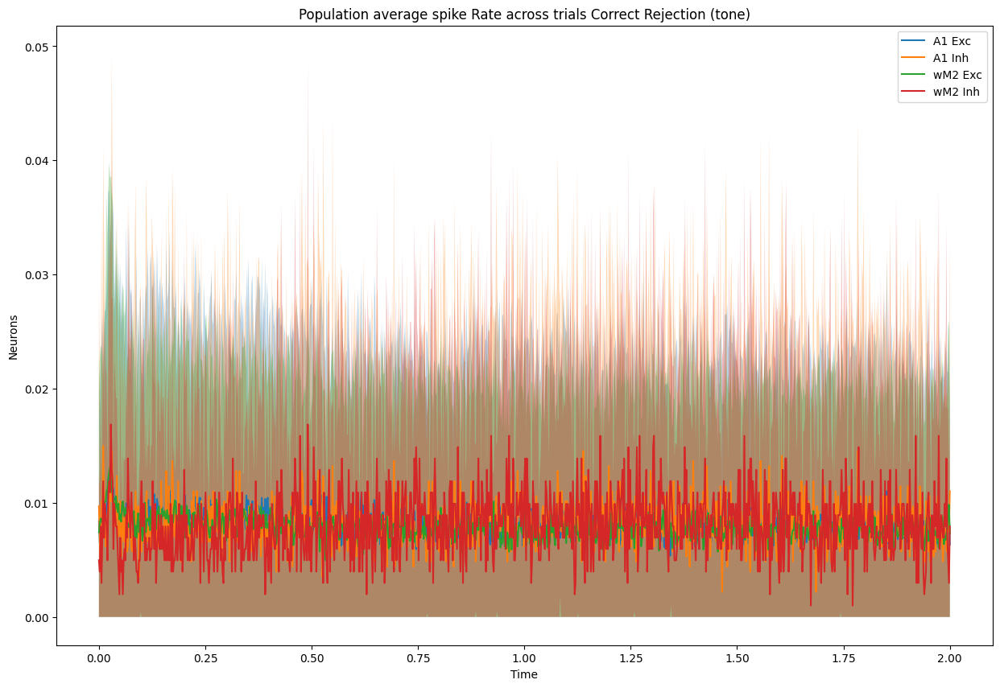

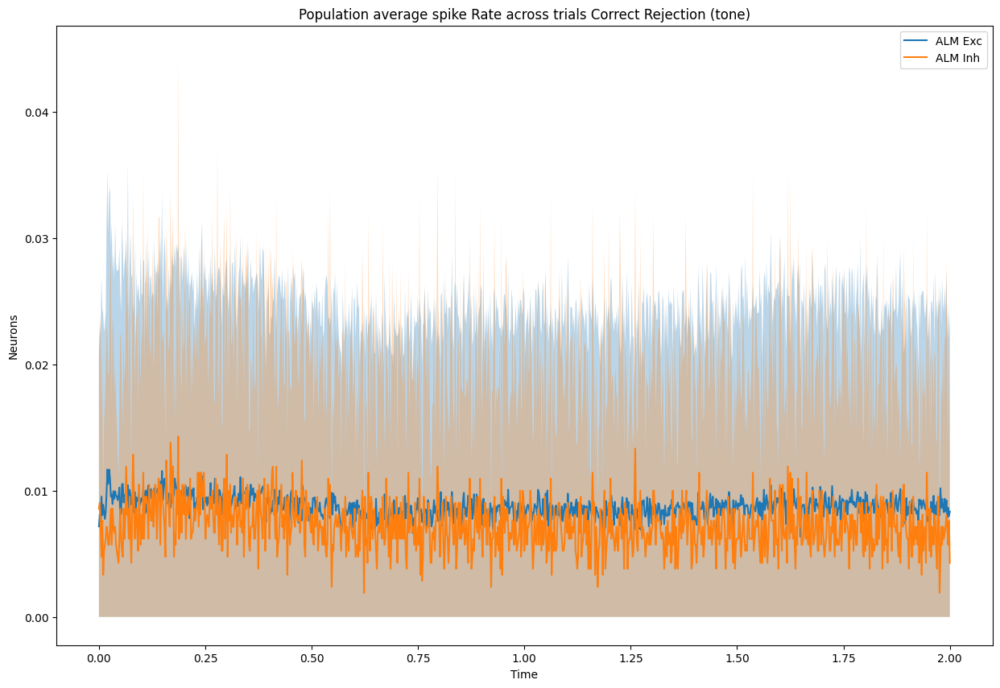

In [93]:
trial_mask = np.logical_and(trial_info['trial_type'] == 4, trial_info['lick'] == 0)
display_PSTH(trial_mask, areas=['wS1', 'wS2'], title_trial="Correct Rejection (tone)")
display_PSTH(trial_mask, areas=['A1', 'wM2'], title_trial="Correct Rejection (tone)")
display_PSTH(trial_mask, areas=['ALM'], title_trial="Correct Rejection (tone)")

## Correct Rejection (whisker)

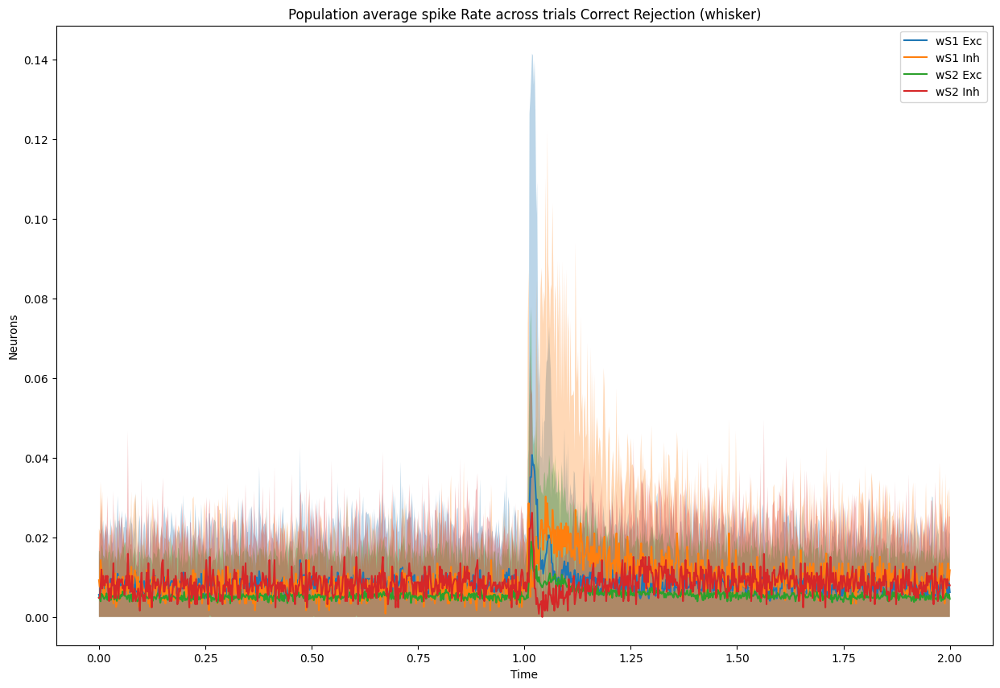

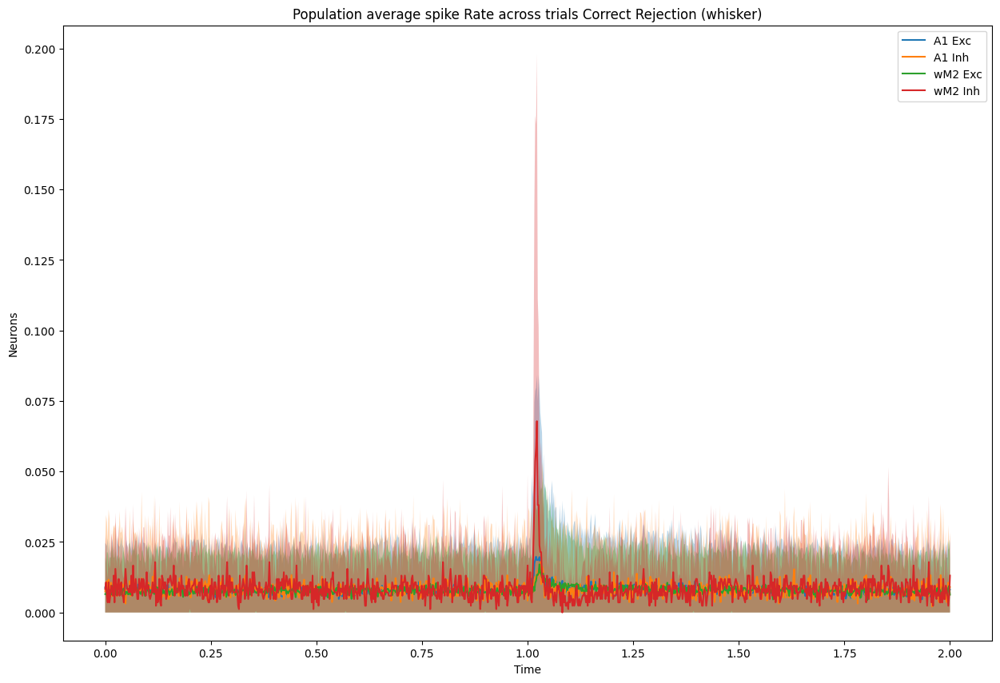

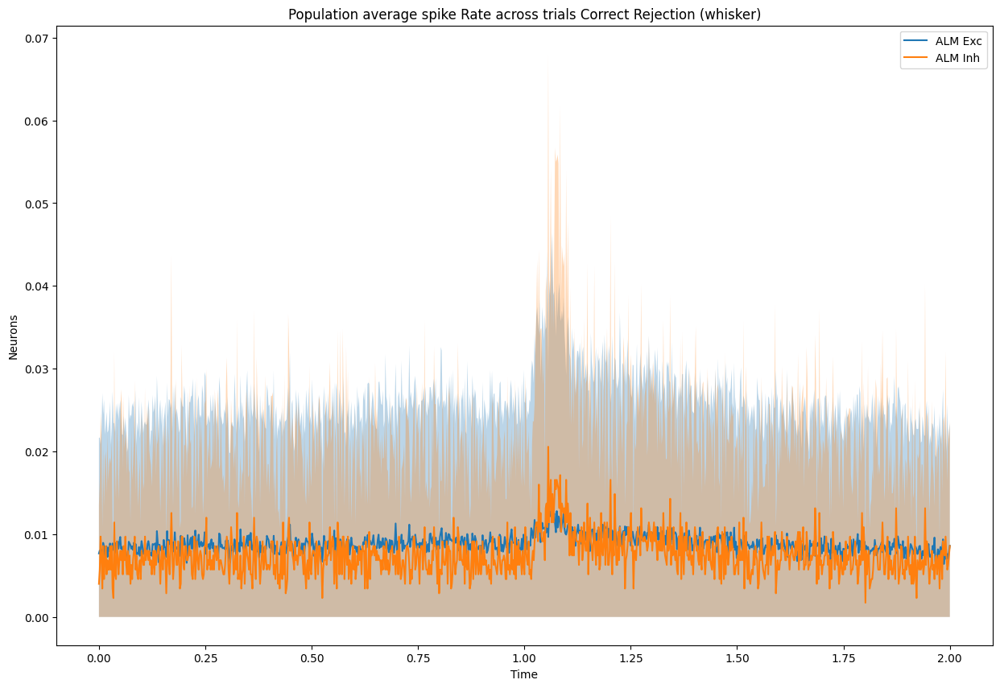

In [95]:
trial_mask = np.logical_and(trial_info['trial_type'] == 5, trial_info['lick'] == 0)
display_PSTH(trial_mask, areas=['wS1', 'wS2'], title_trial="Correct Rejection (whisker)")
display_PSTH(trial_mask, areas=['A1', 'wM2'], title_trial="Correct Rejection (whisker)")
display_PSTH(trial_mask, areas=['ALM'], title_trial="Correct Rejection (whisker)")

# Trial Distribution

In [106]:
K = len(trial_info['trial_type'])
for trial_context, context in zip([[1, 2], [3, 4], [5]], ['go tone', 'no go tone', 'no tone']):
    context_mask = np.isin(trial_info['trial_type'], trial_context)
    K_context = np.sum(context_mask)
    print(f"{context} : {100*K_context/K:.2f} %")
    flag_whisker = True
    for trial_context_whisker in trial_context:
        context_whisker_mask = trial_info['trial_type'] == trial_context_whisker
        K_context_whisker = np.sum(context_whisker_mask)
        print (f"    {'whisker' if flag_whisker else 'no whisker'} : {100*K_context_whisker/K_context:.2f} %")
        K_context_whisker_lick = np.sum(context_whisker_mask & (trial_info['lick'] == 1))
        print(f"        lick : {100*K_context_whisker_lick/K_context:.2f} %")
        print(f"        no lick : {100*(1-K_context_whisker_lick/K_context):.2f} %")
        flag_whisker = False

go tone : 41.72 %
    whisker : 47.74 %
        lick : 34.17 %
        no lick : 65.83 %
    no whisker : 52.26 %
        lick : 7.54 %
        no lick : 92.46 %
no go tone : 38.78 %
    whisker : 50.81 %
        lick : 10.27 %
        no lick : 89.73 %
    no whisker : 49.19 %
        lick : 3.78 %
        no lick : 96.22 %
no tone : 19.50 %
    whisker : 100.00 %
        lick : 24.73 %
        no lick : 75.27 %


## Area Trial-Average Heatmaps

In [116]:
def display_trial_average_heatmap(trial_mask=None, title_trial=""):
    spikes_trial_avg = np.mean(spikes, axis=0) if trial_mask is None else np.mean(spikes[trial_mask], axis=0)
    areas = np.unique(cluster_info['area'])
    for area in areas:
        area_mask = cluster_info['area'] == area
        for excitatory in [True, False]:
            mask = area_mask & (cluster_info['excitatory'] == excitatory)
            if np.sum(mask) == 0:
                continue
            print(f"{area}, {'Exc' if excitatory else 'Inh'}")
            plt.figure(figsize=(5, 5))
            plt.imshow(spikes_trial_avg[mask], aspect='auto', cmap='hot', interpolation='nearest')
            plt.colorbar(label='Spike Rate')
            plt.xlabel('Time')
            plt.ylabel('Neurons')
            plt.title(f'Heatmap of Spike Rate for {title_trial} trials')
            plt.xticks(ticks=np.linspace(0, spikes_trial_avg.shape[-1], num=5), labels=np.linspace(0, 2, num=5))
            plt.gca().invert_yaxis()
            plt.show()

A1, Exc


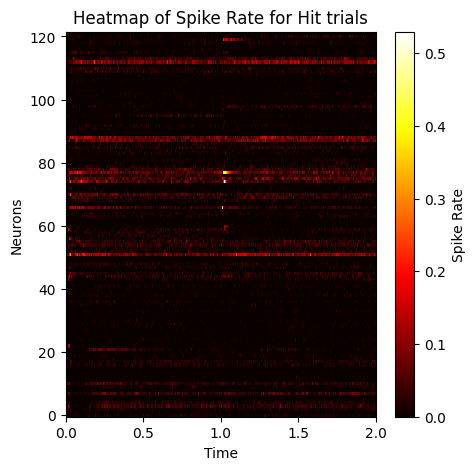

A1, Inh


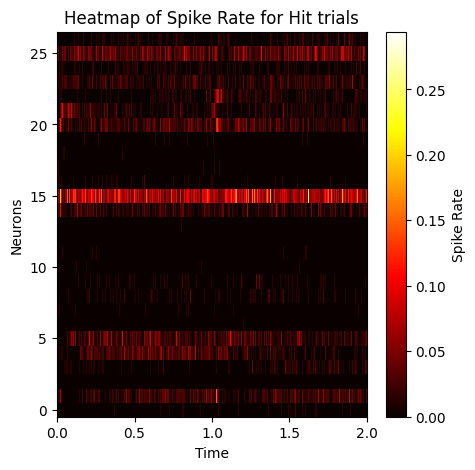

ALM, Exc


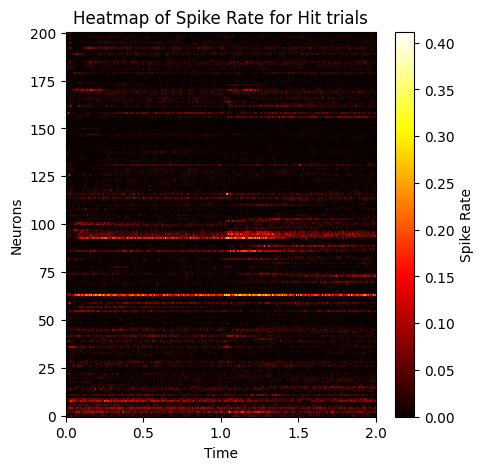

ALM, Inh


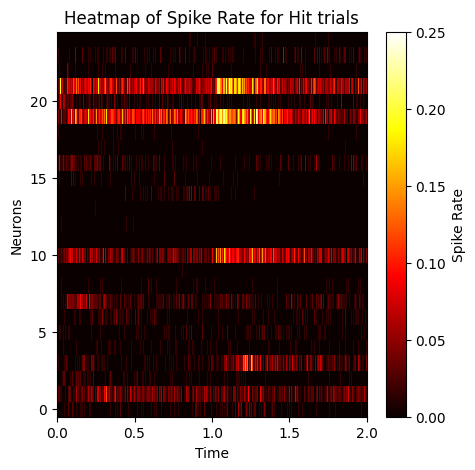

wM2, Exc


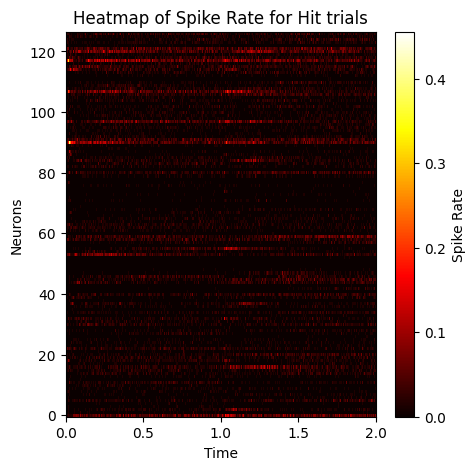

wM2, Inh


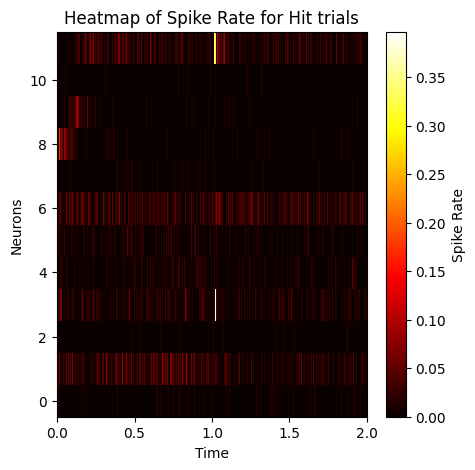

wS1, Exc


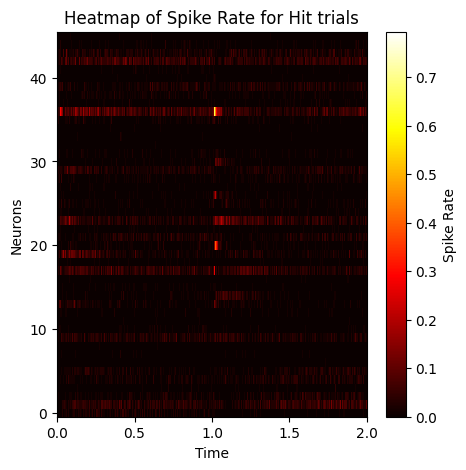

wS1, Inh


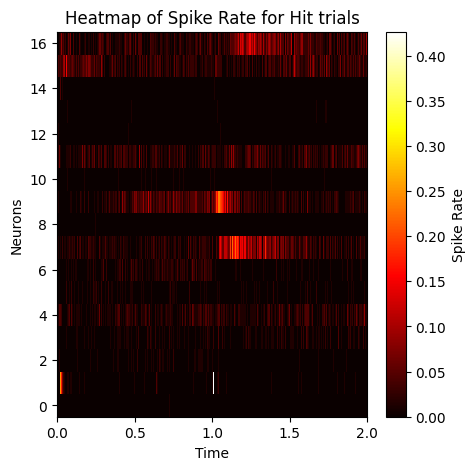

wS2, Exc


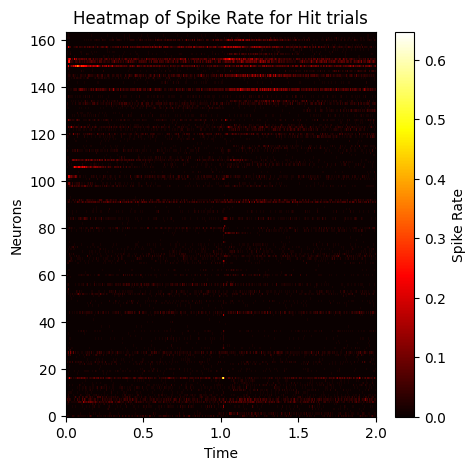

wS2, Inh


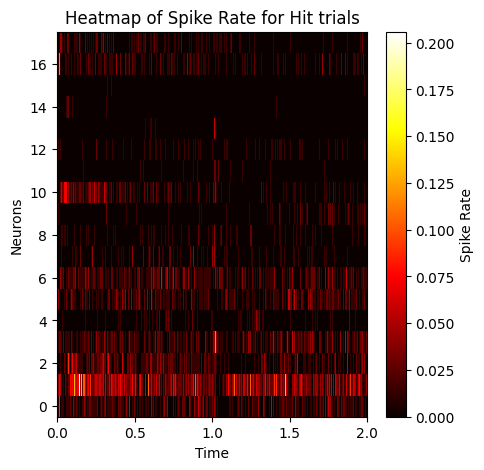

In [117]:
trial_mask = (trial_info['trial_type'] == 1) & (trial_info['lick'] == 1)
display_trial_average_heatmap(trial_mask, title_trial="Hit")

A1, Exc


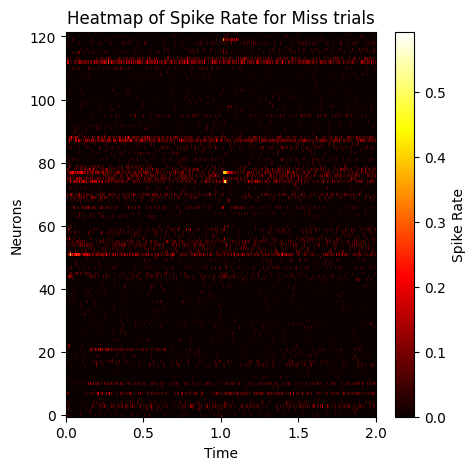

A1, Inh


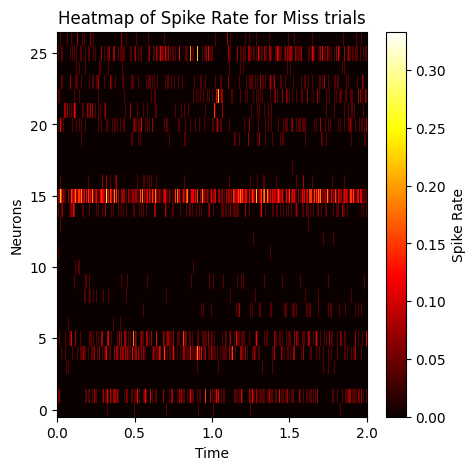

ALM, Exc


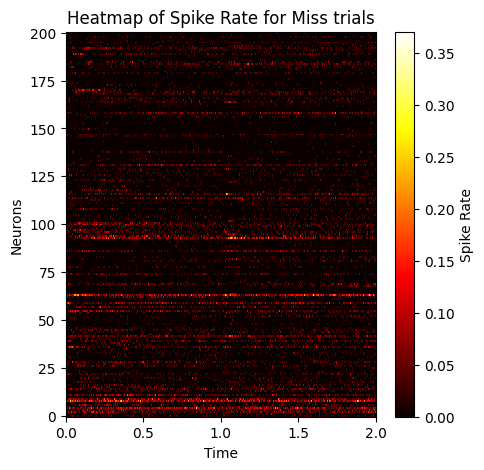

ALM, Inh


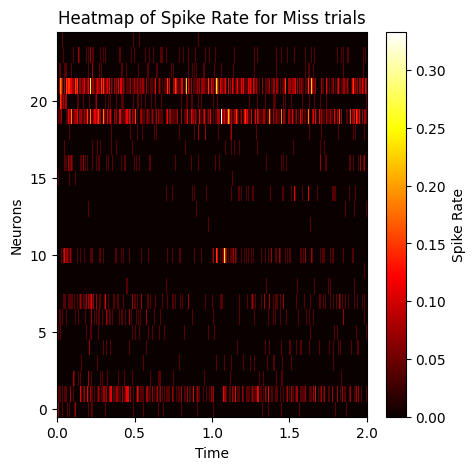

wM2, Exc


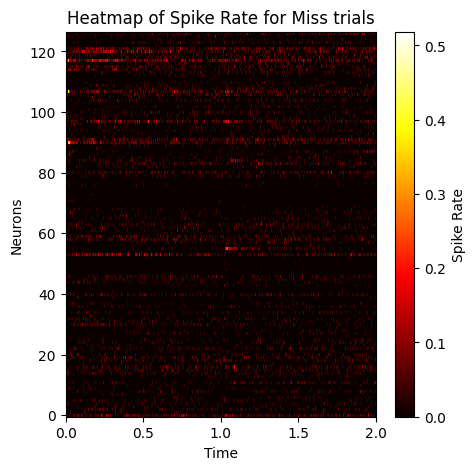

wM2, Inh


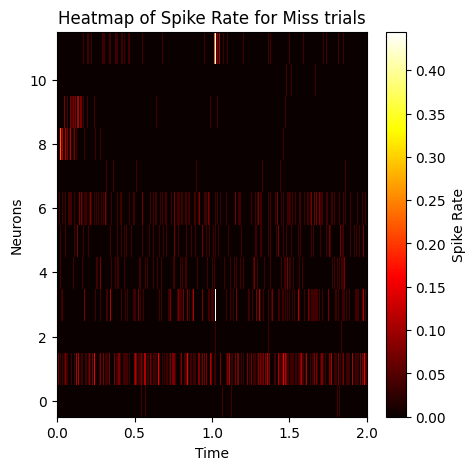

wS1, Exc


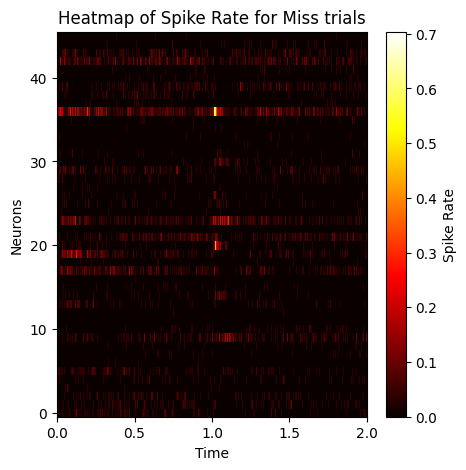

wS1, Inh


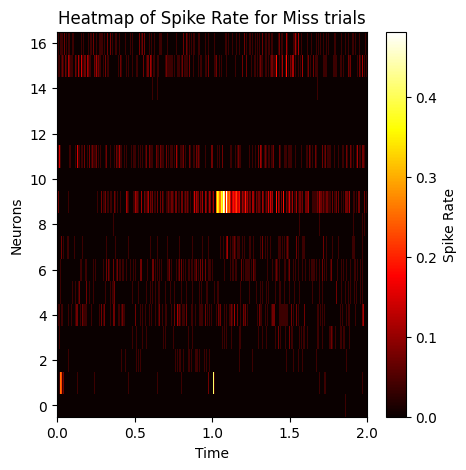

wS2, Exc


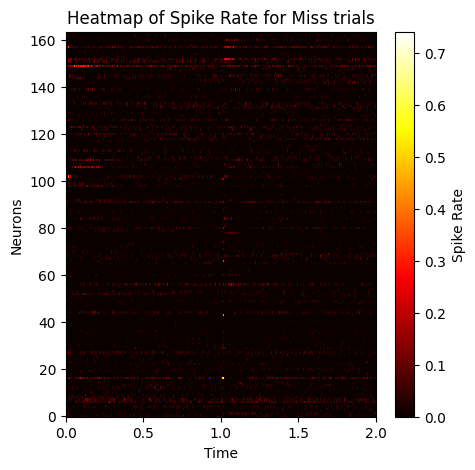

wS2, Inh


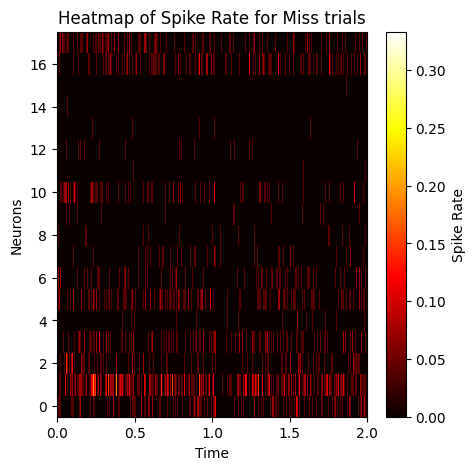

In [118]:
trial_mask = (trial_info['trial_type'] == 1) & (trial_info['lick'] == 0)
display_trial_average_heatmap(trial_mask, title_trial="Miss")

A1, Exc


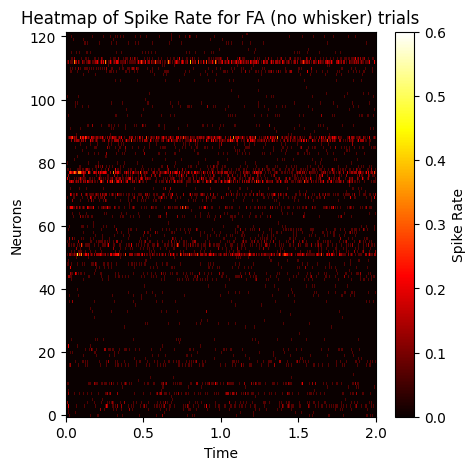

A1, Inh


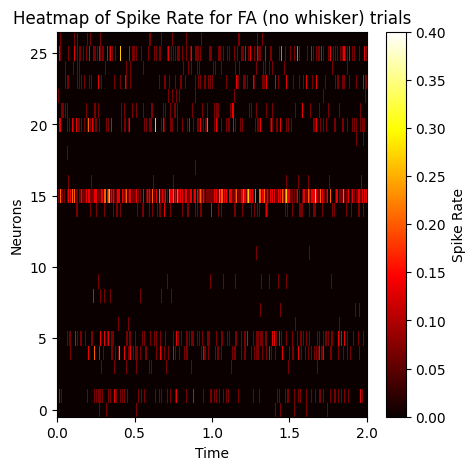

ALM, Exc


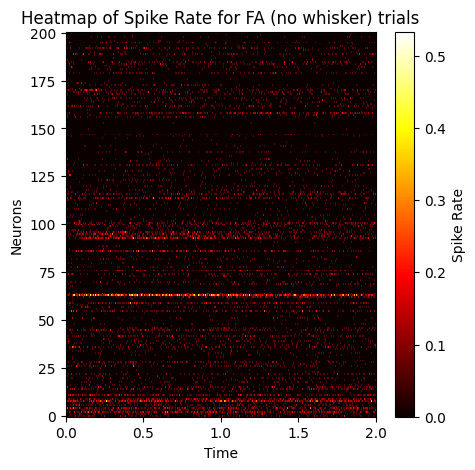

ALM, Inh


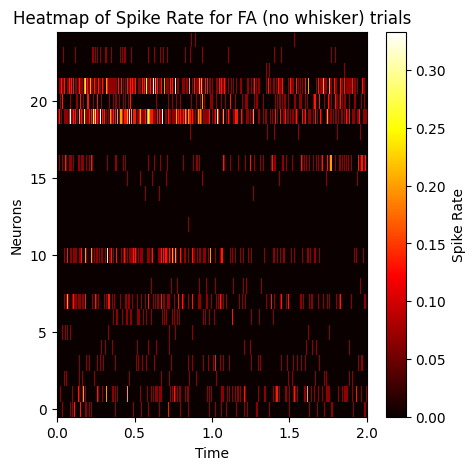

wM2, Exc


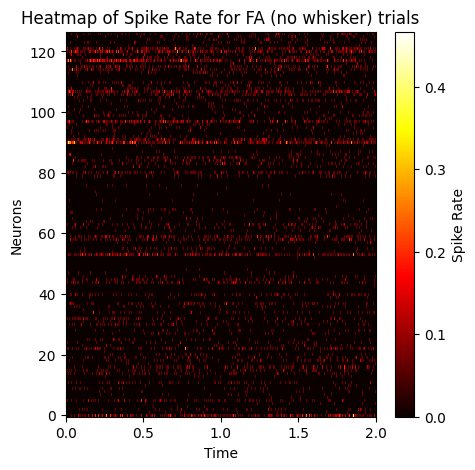

wM2, Inh


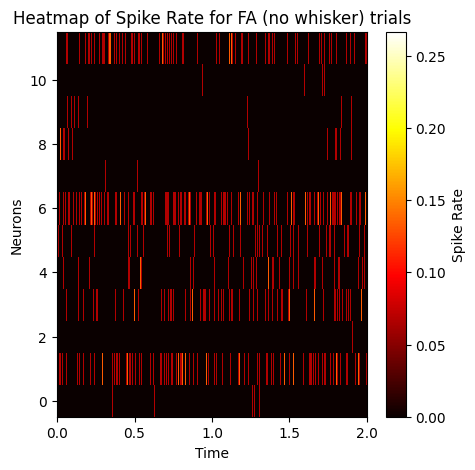

wS1, Exc


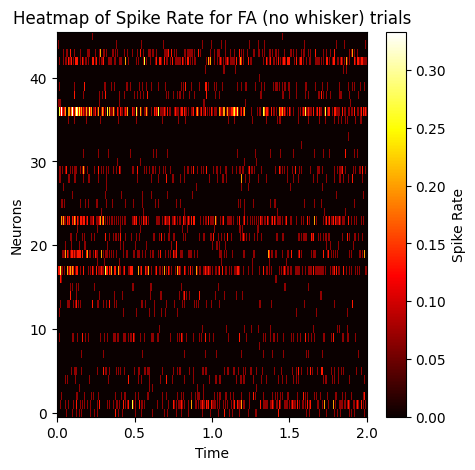

wS1, Inh


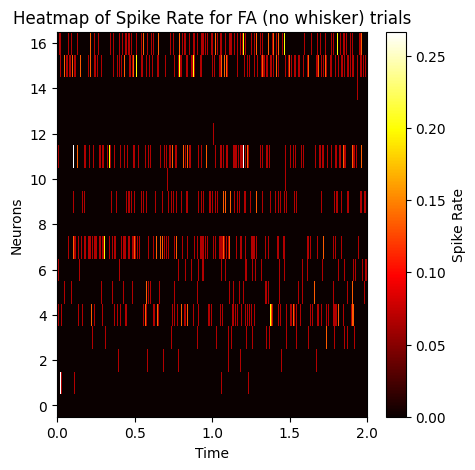

wS2, Exc


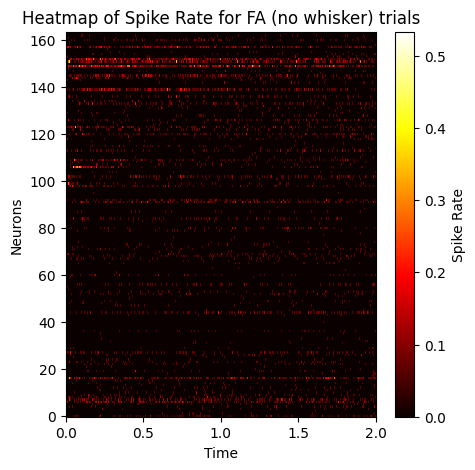

wS2, Inh


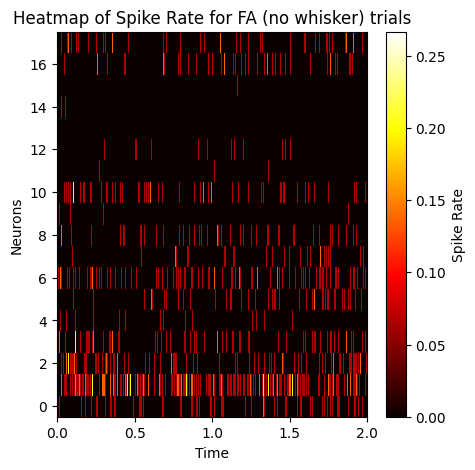

In [120]:
trial_mask = (trial_info['trial_type'] == 2) & (trial_info['lick'] == 1)
display_trial_average_heatmap(trial_mask, title_trial="FA (no whisker)")

A1, Exc


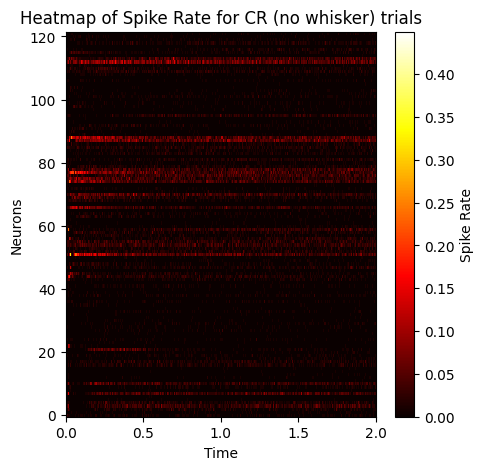

A1, Inh


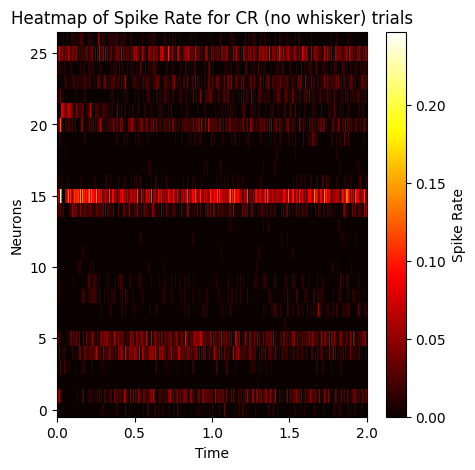

ALM, Exc


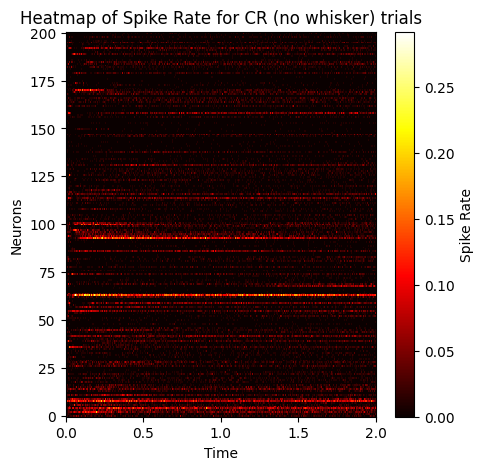

ALM, Inh


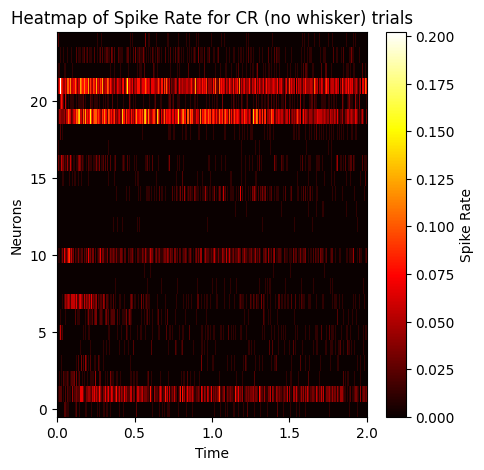

wM2, Exc


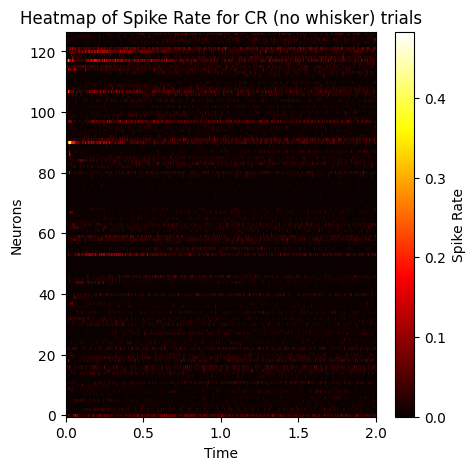

wM2, Inh


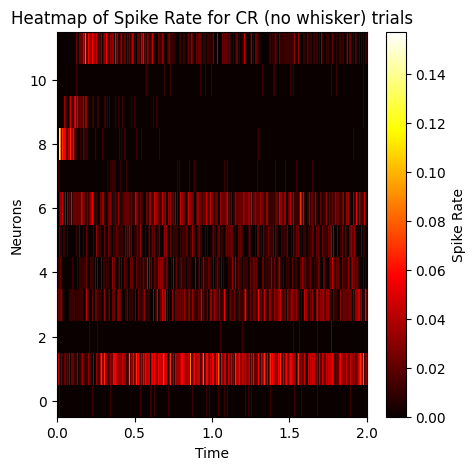

wS1, Exc


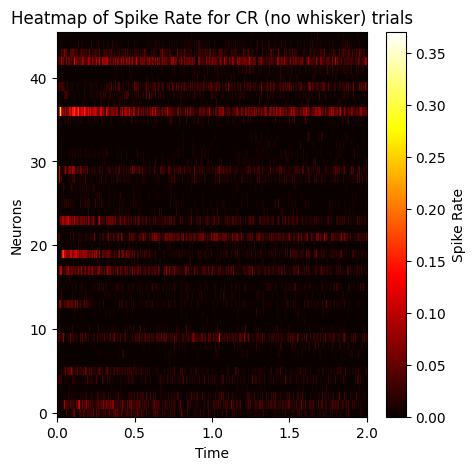

wS1, Inh


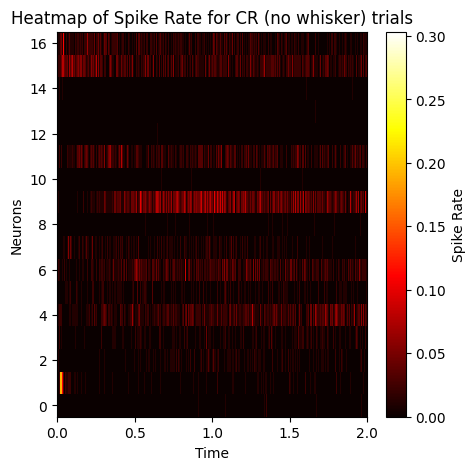

wS2, Exc


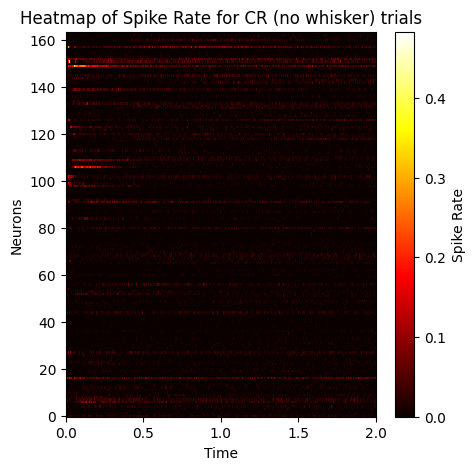

wS2, Inh


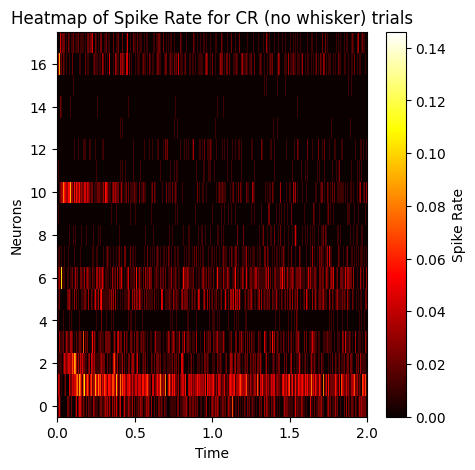

In [121]:
trial_mask = (trial_info['trial_type'] == 2) & (trial_info['lick'] == 0)
display_trial_average_heatmap(trial_mask, title_trial="CR (no whisker)")

A1, Exc


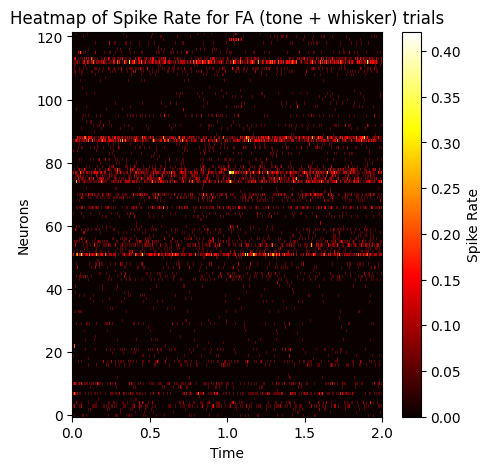

A1, Inh


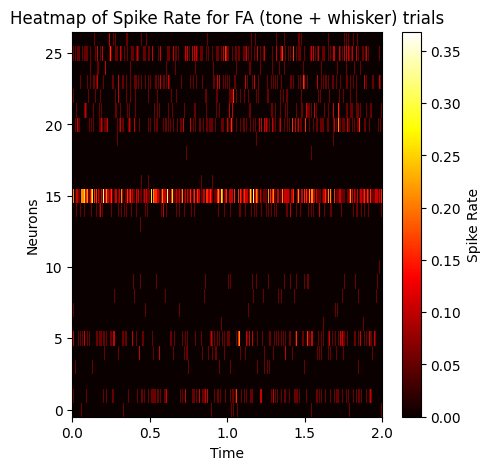

ALM, Exc


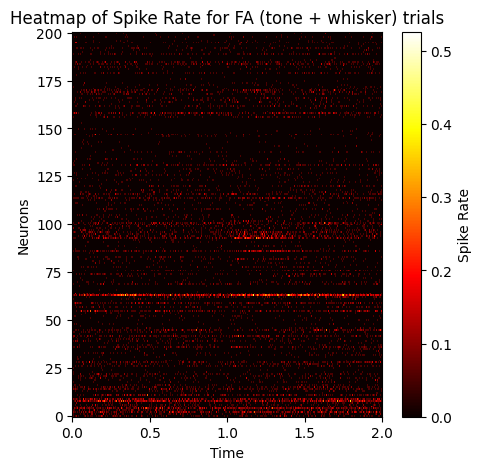

ALM, Inh


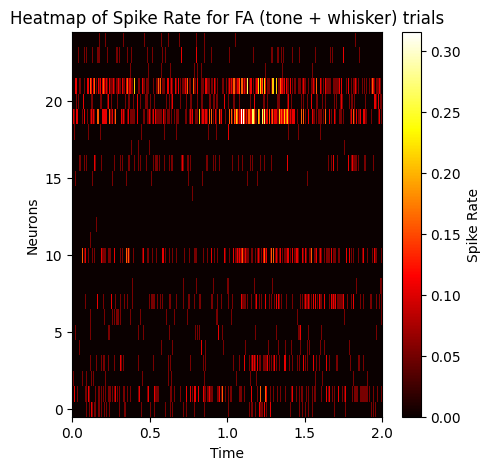

wM2, Exc


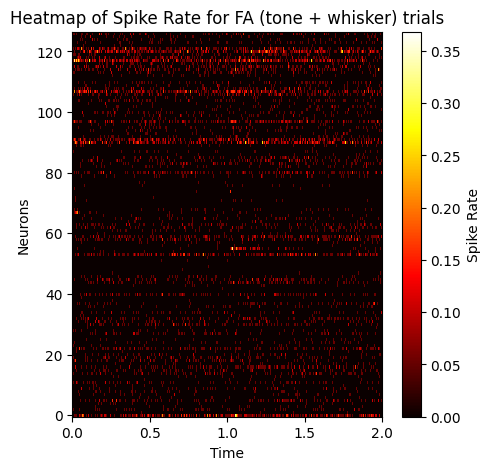

wM2, Inh


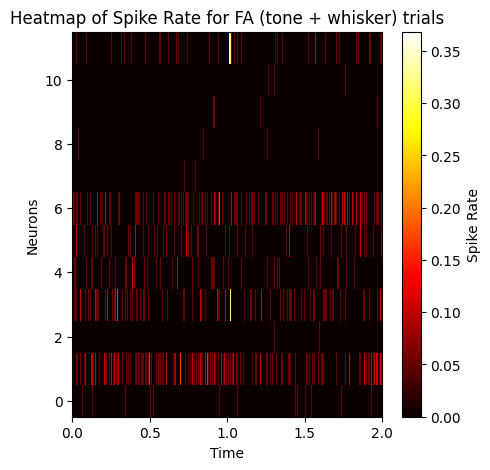

wS1, Exc


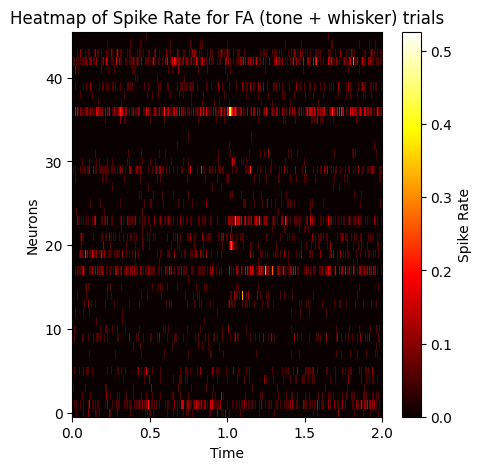

wS1, Inh


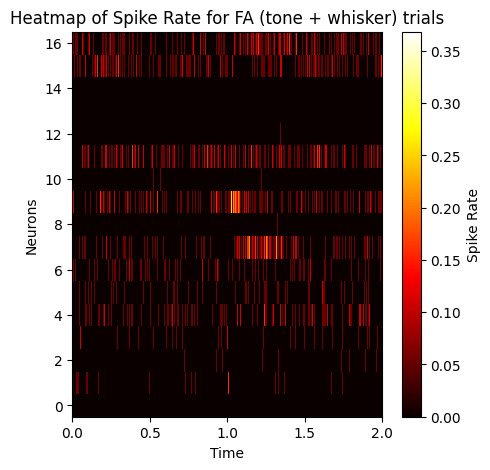

wS2, Exc


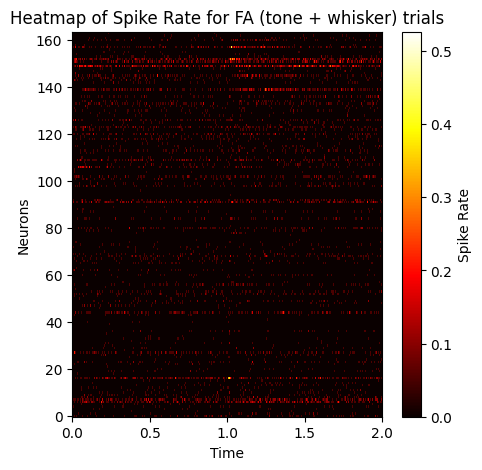

wS2, Inh


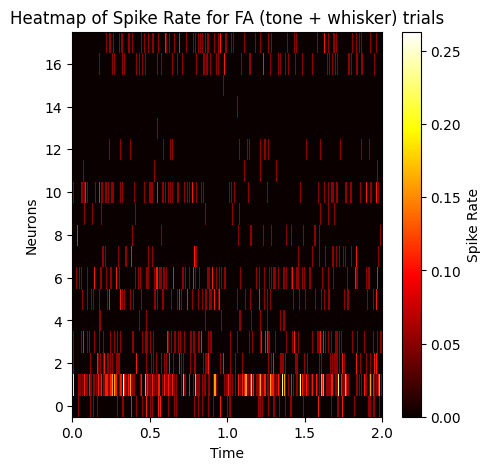

In [122]:
trial_mask = (trial_info['trial_type'] == 3) & (trial_info['lick'] == 1)
display_trial_average_heatmap(trial_mask, title_trial="FA (tone + whisker)")

A1, Exc


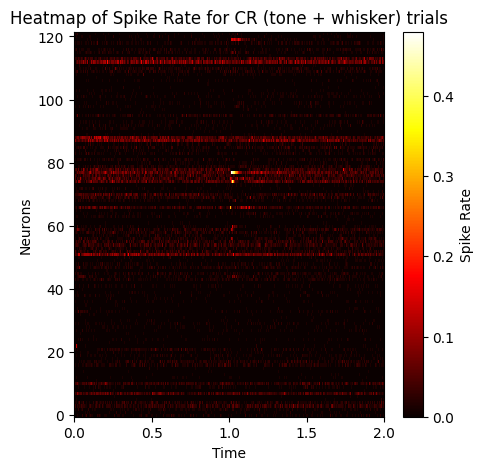

A1, Inh


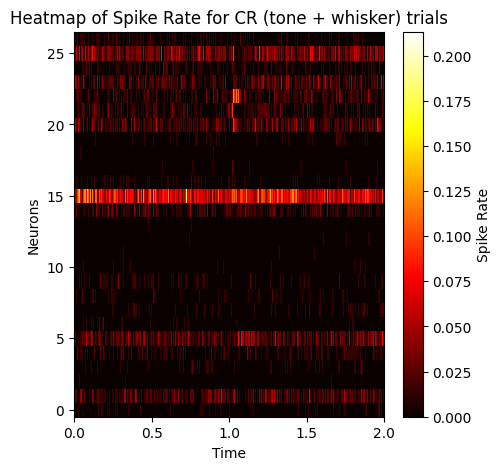

ALM, Exc


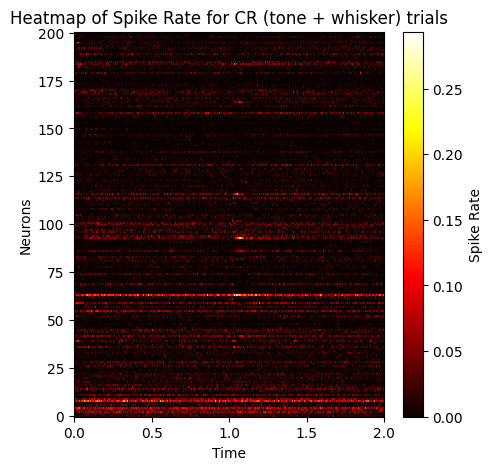

ALM, Inh


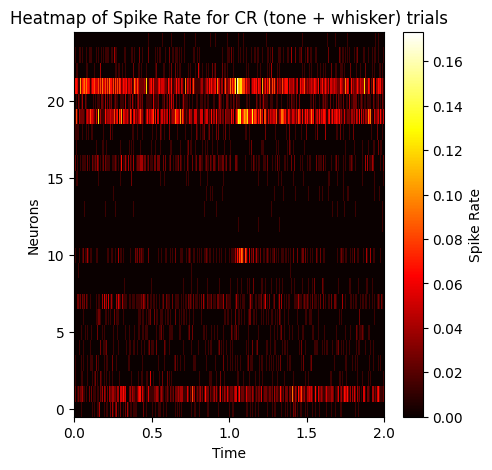

wM2, Exc


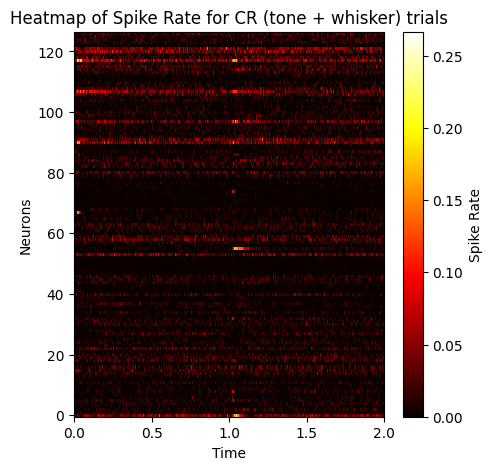

wM2, Inh


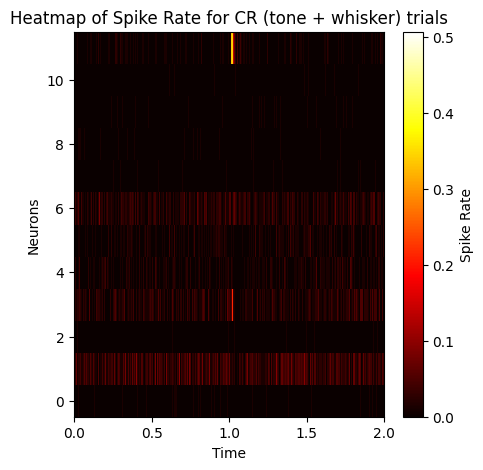

wS1, Exc


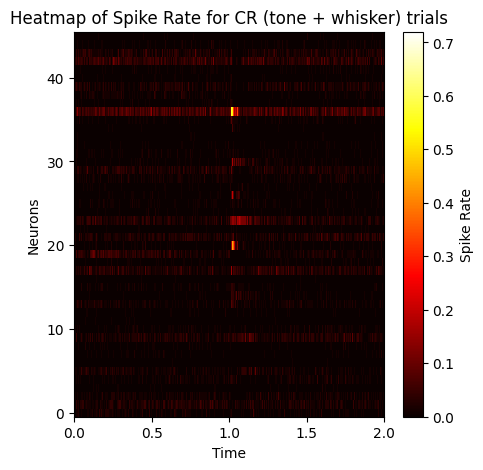

wS1, Inh


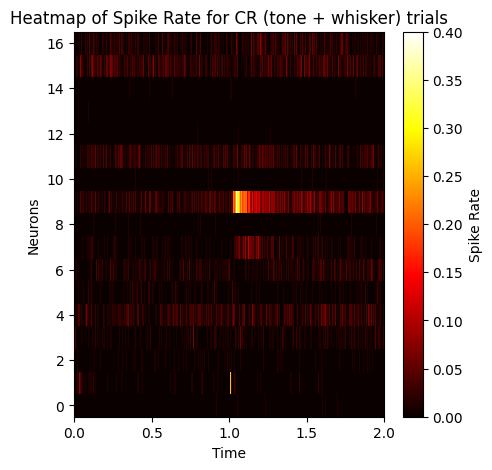

wS2, Exc


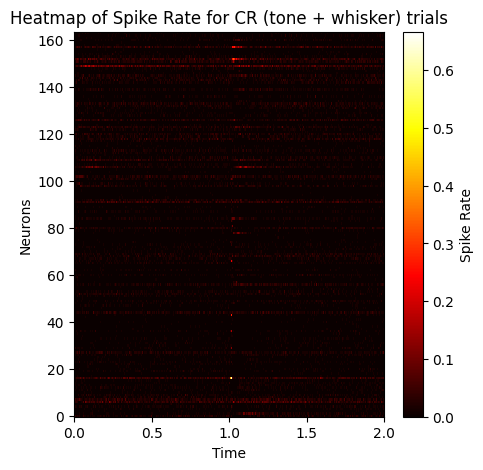

wS2, Inh


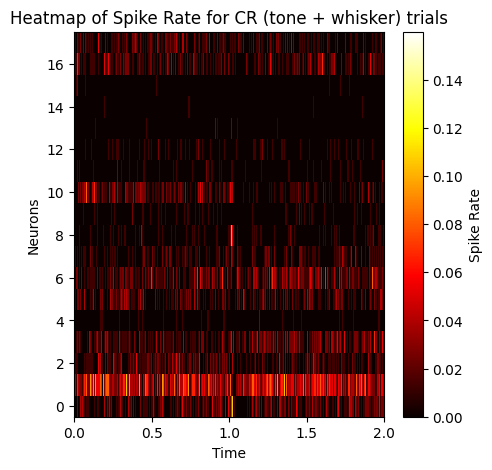

In [123]:
trial_mask = (trial_info['trial_type'] == 3) & (trial_info['lick'] == 0)
display_trial_average_heatmap(trial_mask, title_trial="CR (tone + whisker)")

A1, Exc


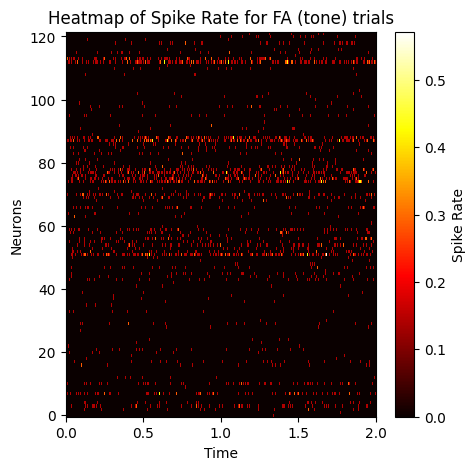

A1, Inh


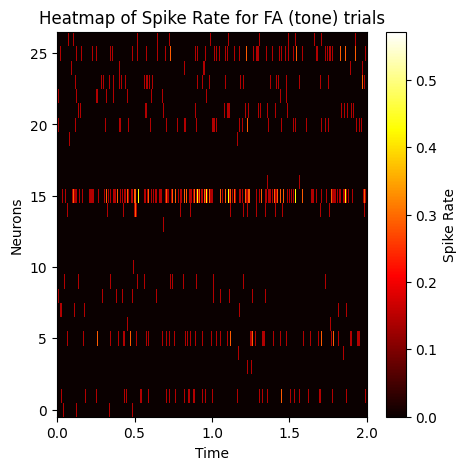

ALM, Exc


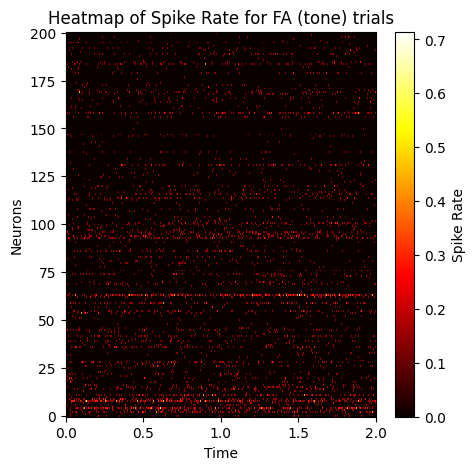

ALM, Inh


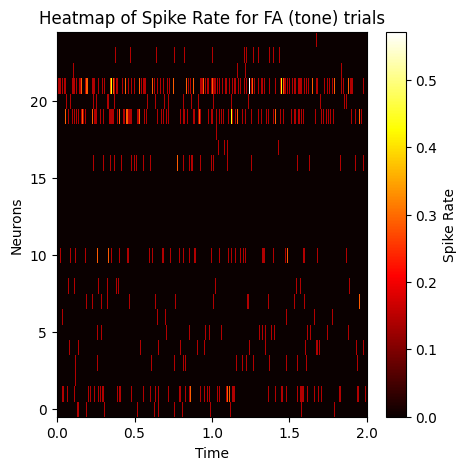

wM2, Exc


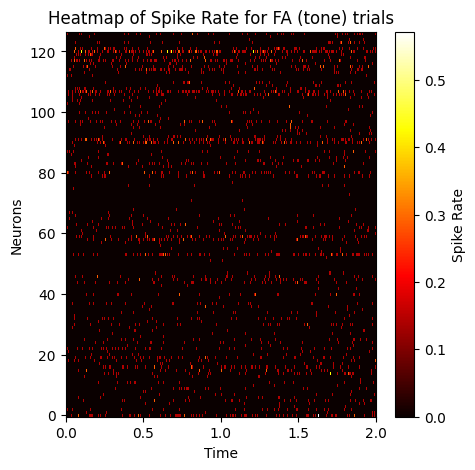

wM2, Inh


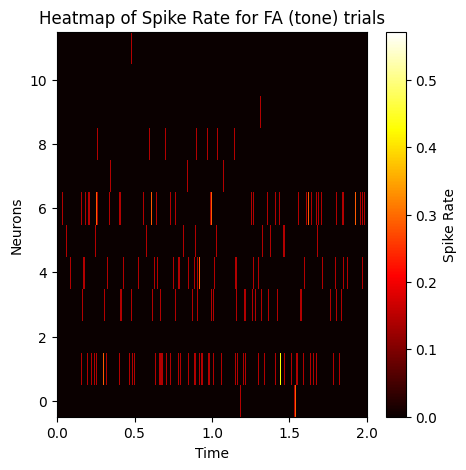

wS1, Exc


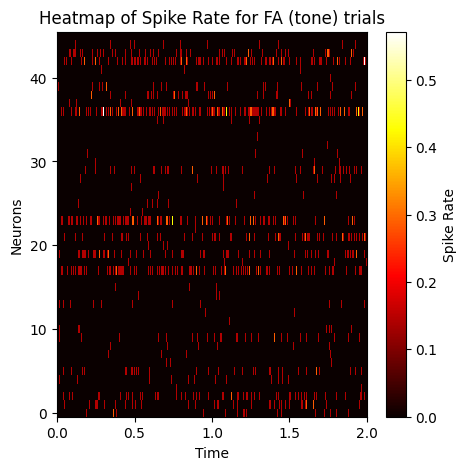

wS1, Inh


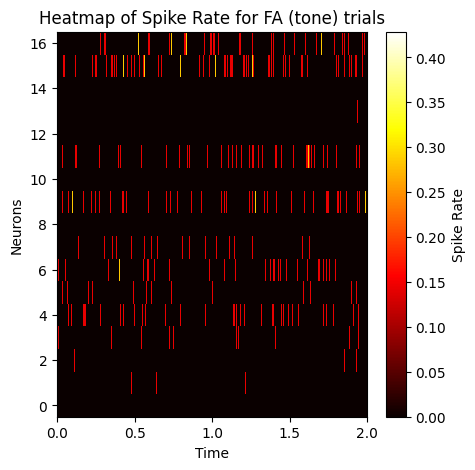

wS2, Exc


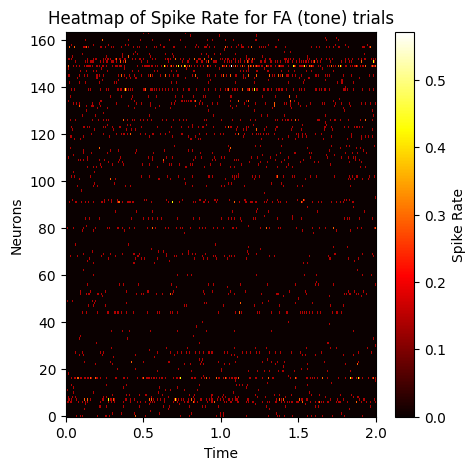

wS2, Inh


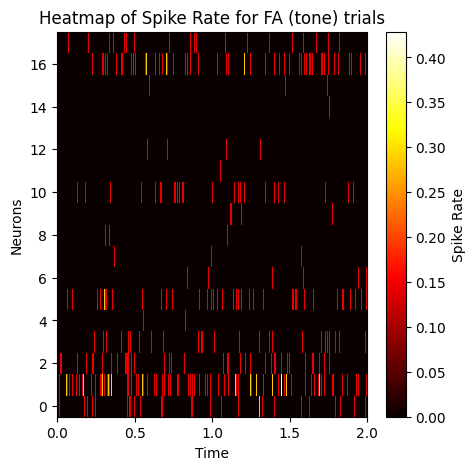

In [124]:
trial_mask = (trial_info['trial_type'] == 4) & (trial_info['lick'] == 1)
display_trial_average_heatmap(trial_mask, title_trial="FA (tone)")

A1, Exc


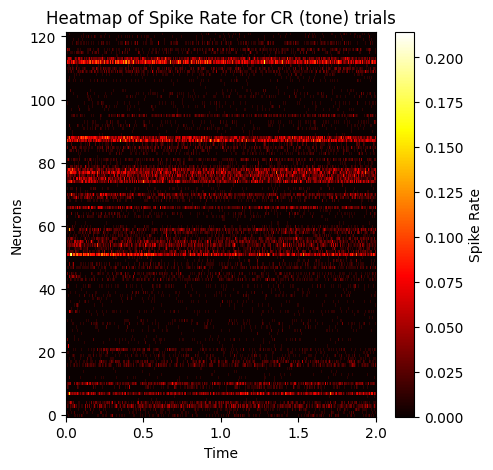

A1, Inh


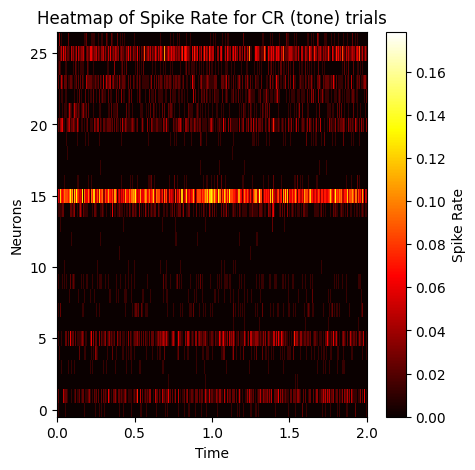

ALM, Exc


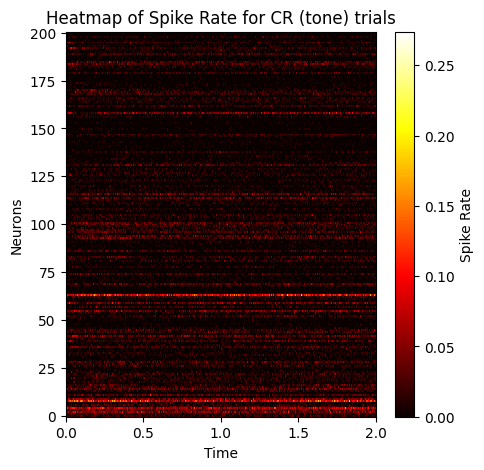

ALM, Inh


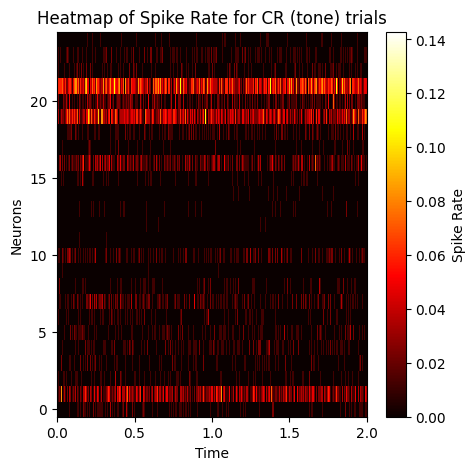

wM2, Exc


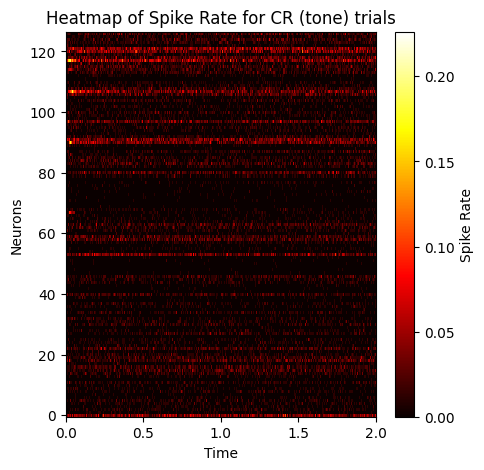

wM2, Inh


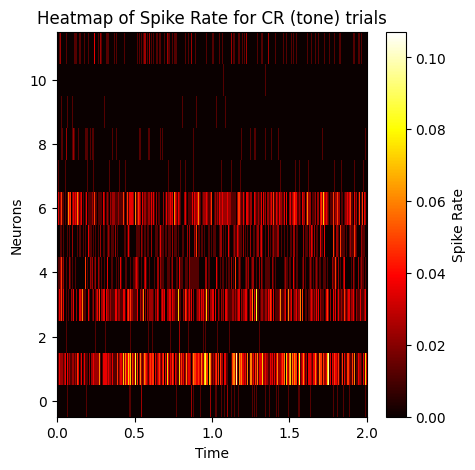

wS1, Exc


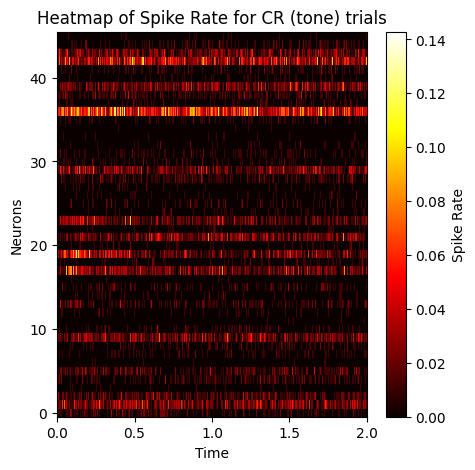

wS1, Inh


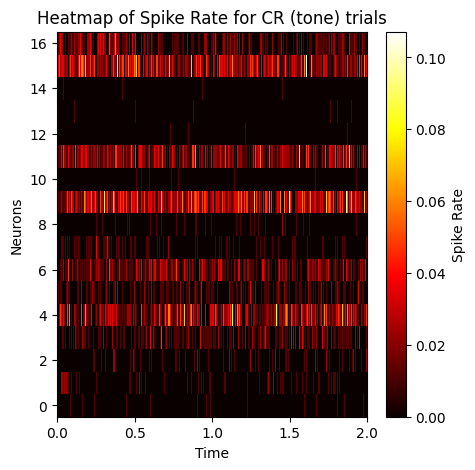

wS2, Exc


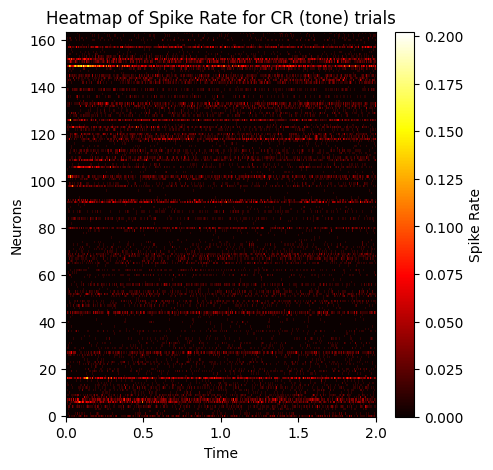

wS2, Inh


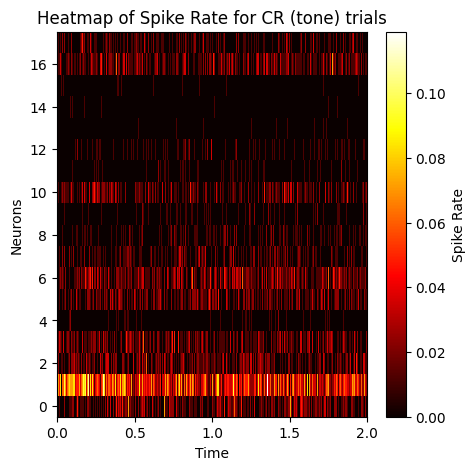

In [125]:
trial_mask = (trial_info['trial_type'] == 4) & (trial_info['lick'] == 0)
display_trial_average_heatmap(trial_mask, title_trial="CR (tone)")

A1, Exc


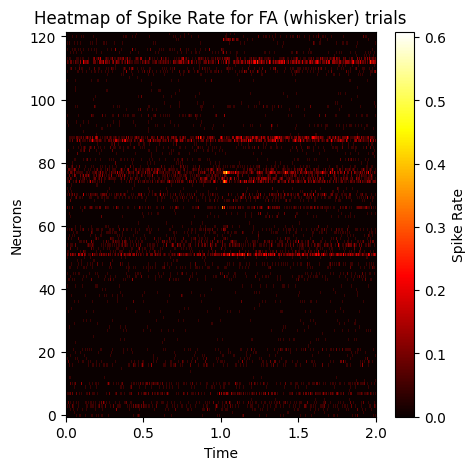

A1, Inh


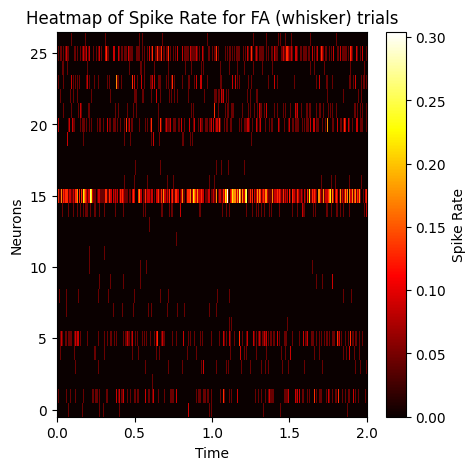

ALM, Exc


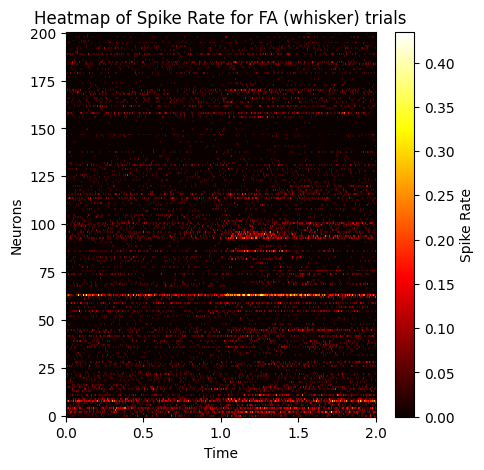

ALM, Inh


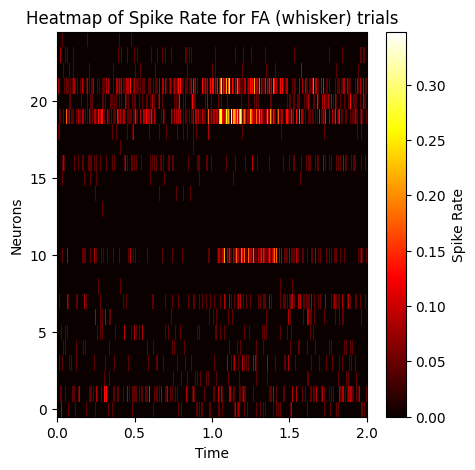

wM2, Exc


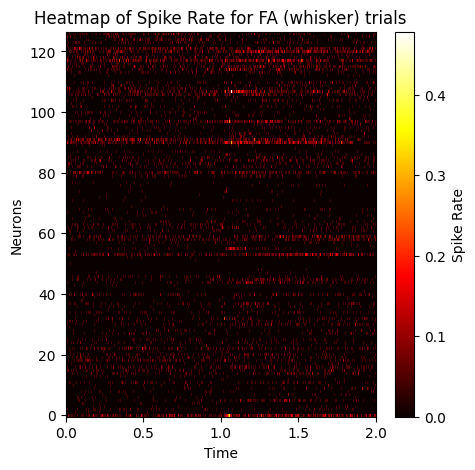

wM2, Inh


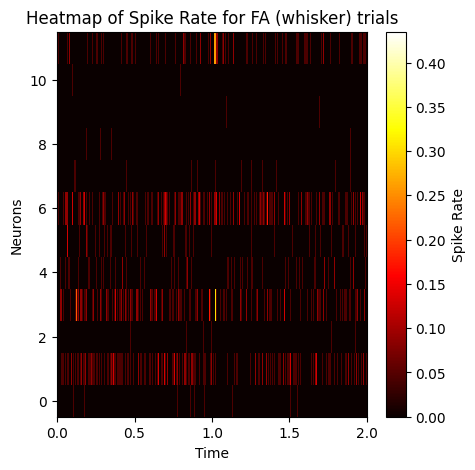

wS1, Exc


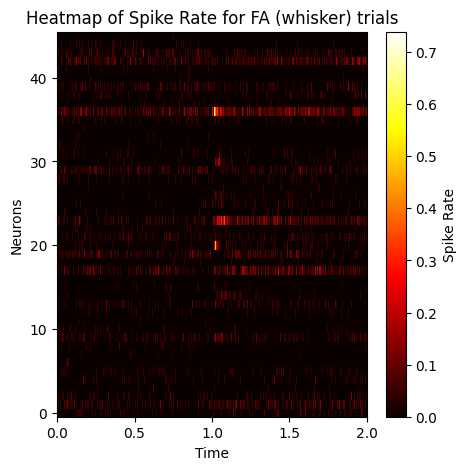

wS1, Inh


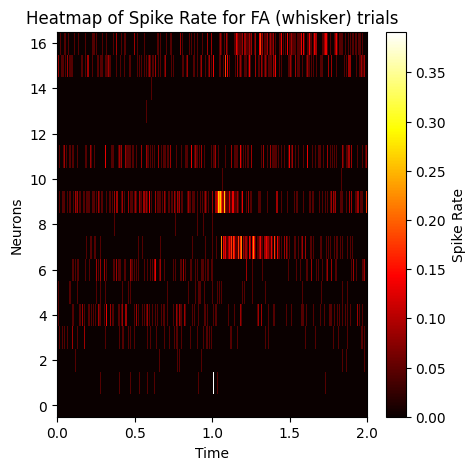

wS2, Exc


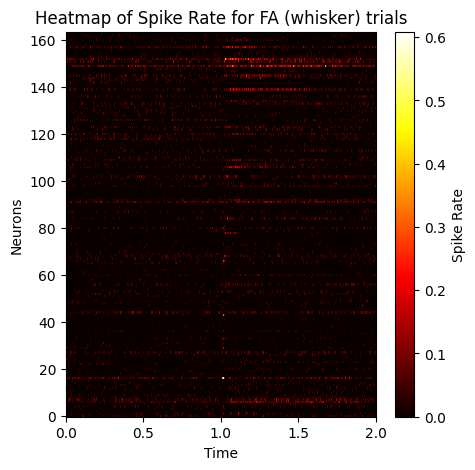

wS2, Inh


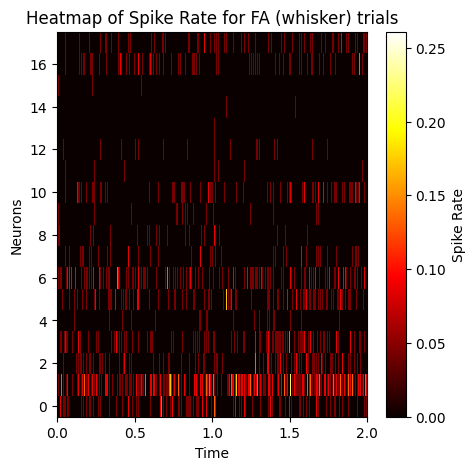

In [126]:
trial_mask = (trial_info['trial_type'] == 5) & (trial_info['lick'] == 1)
display_trial_average_heatmap(trial_mask, title_trial="FA (whisker)")

A1, Exc


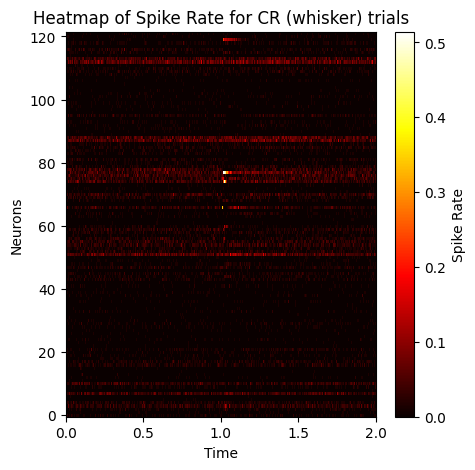

A1, Inh


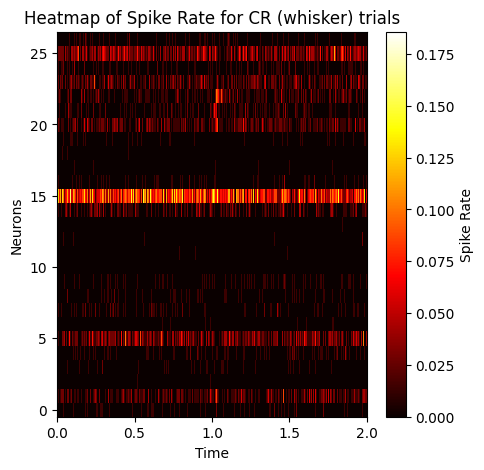

ALM, Exc


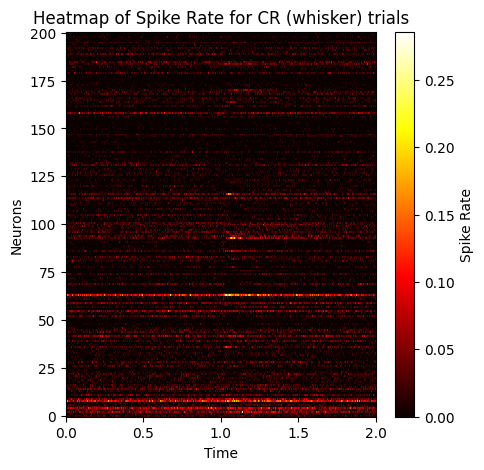

ALM, Inh


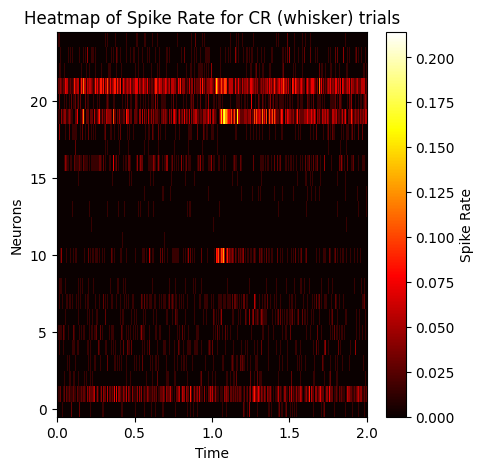

wM2, Exc


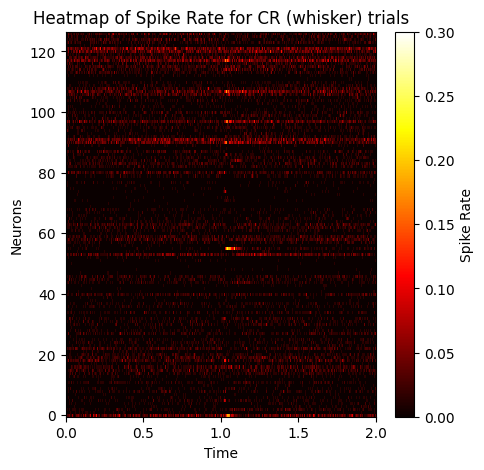

wM2, Inh


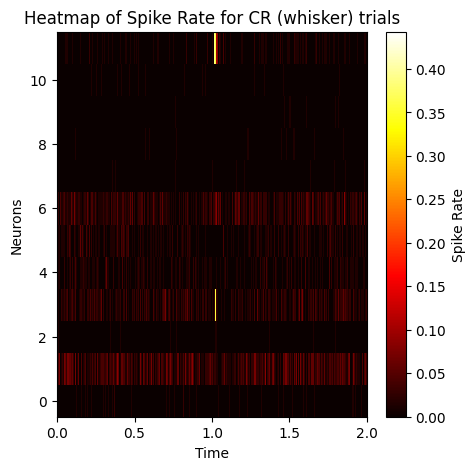

wS1, Exc


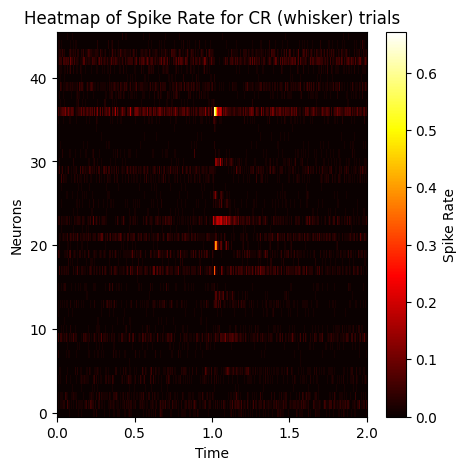

wS1, Inh


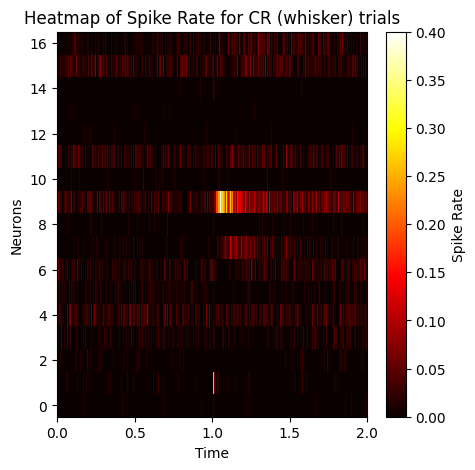

wS2, Exc


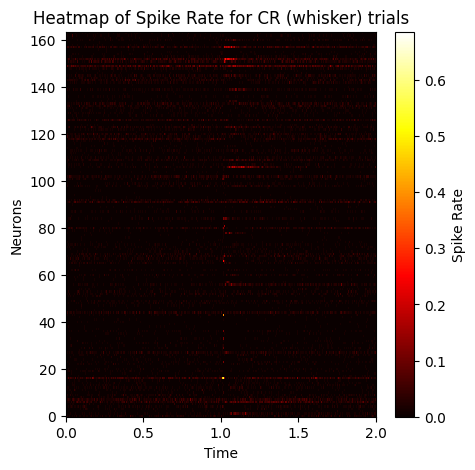

wS2, Inh


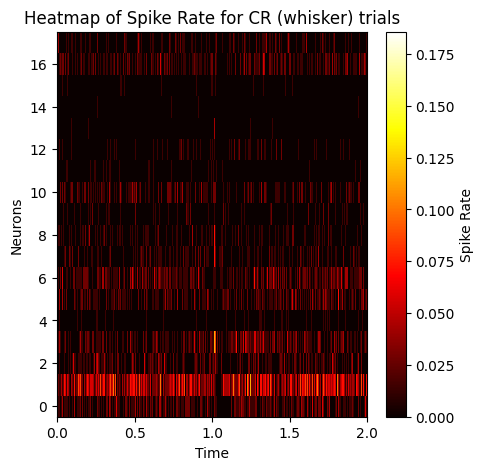

In [127]:
trial_mask = (trial_info['trial_type'] == 5) & (trial_info['lick'] == 0)
display_trial_average_heatmap(trial_mask, title_trial="CR (whisker)")

In [162]:
def display_trial_average_differential_heatmap(trial_mask_plus, trial_mask_minus, title_trial=""):
    spikes_trial_avg_plus = np.mean(spikes[trial_mask_plus], axis=0)
    spikes_trial_avg_minus = np.mean(spikes[trial_mask_minus], axis=0)

    areas = np.unique(cluster_info['area'])
    for area in areas:
        area_mask = cluster_info['area'] == area
        abs_max_diff = np.max(np.abs(spikes_trial_avg_plus[area_mask]-spikes_trial_avg_minus[area_mask]))
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))
        for exc, ax in zip([True, False], axes):
            mask = area_mask & (cluster_info['excitatory'] == exc)
            im = ax.imshow(spikes_trial_avg_plus[mask]-spikes_trial_avg_minus[mask], aspect='auto', cmap='RdBu_r', interpolation='nearest',
                           vmin=-abs_max_diff, vmax=abs_max_diff)
            ax.set_xlabel('Time')
            ax.set_ylabel('Neurons')
            ax.set_xticks(ticks=np.linspace(0, spikes_trial_avg_plus.shape[-1], num=5), labels=np.linspace(0, 2, num=5))
            ax.set_title('Exc' if exc else 'Inh')
            ax.invert_yaxis()
        fig.suptitle(f'{area} {title_trial} trials')
        fig.colorbar(im, ax=axes.ravel().tolist(), label='Spike Rate')
        plt.show()

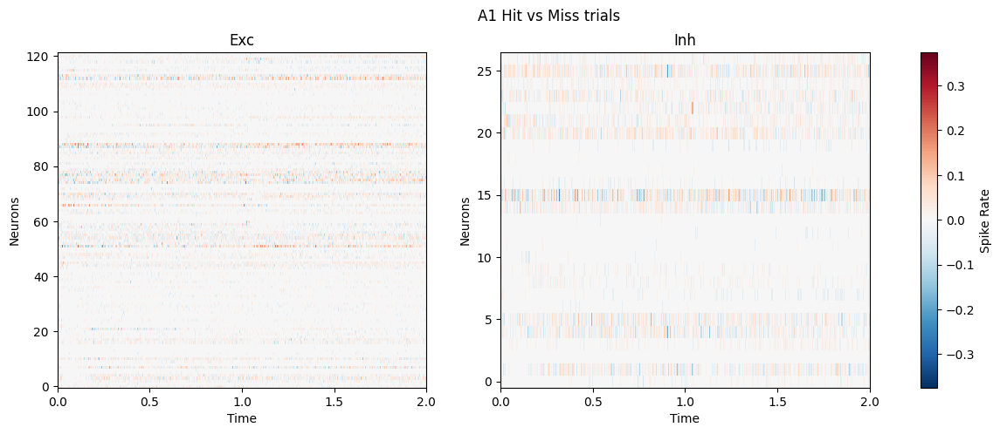

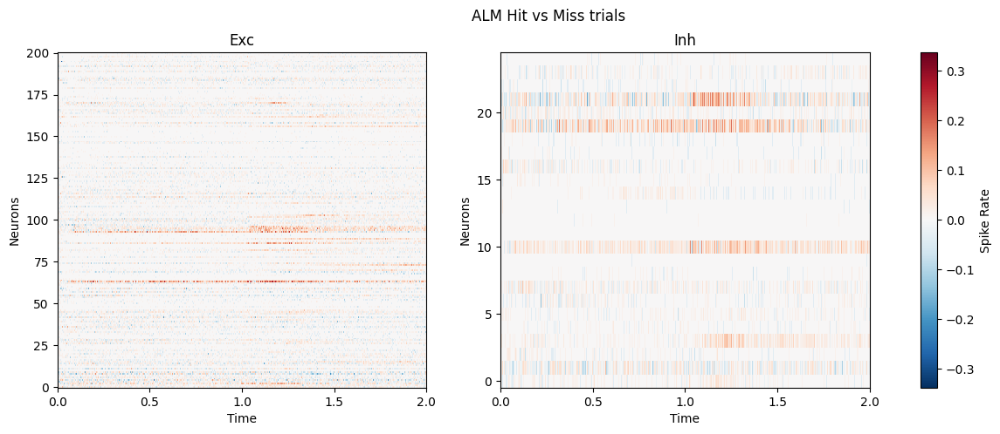

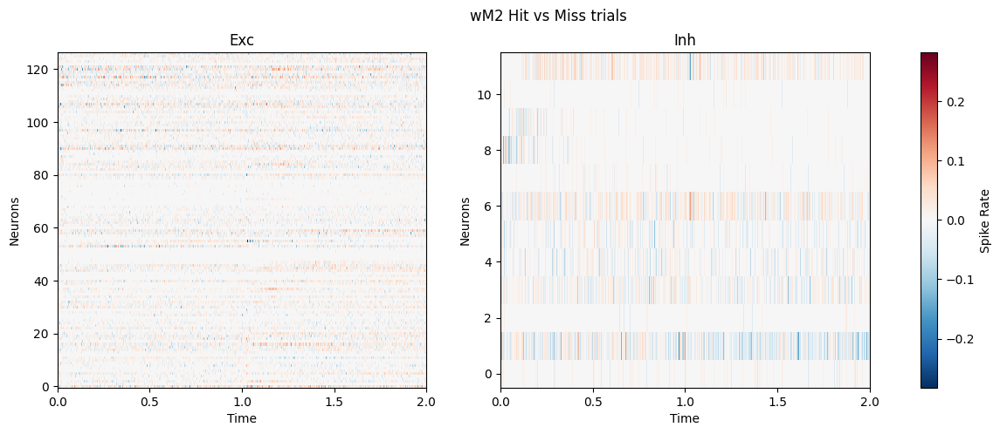

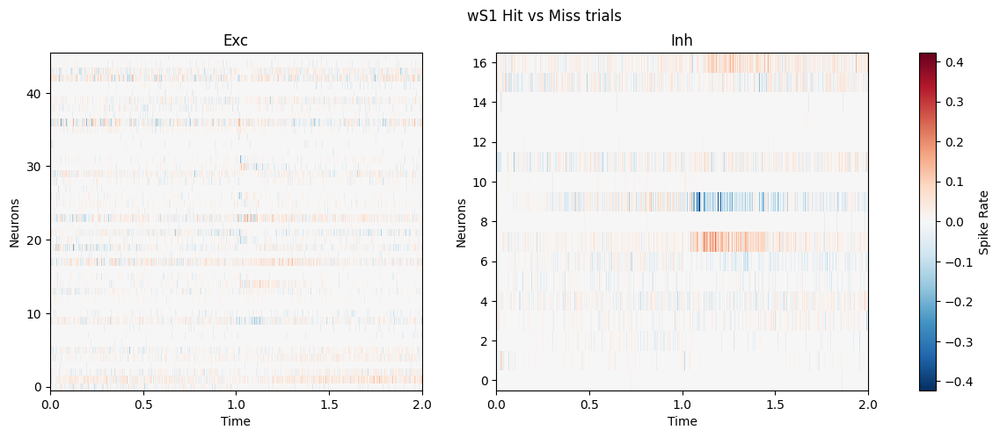

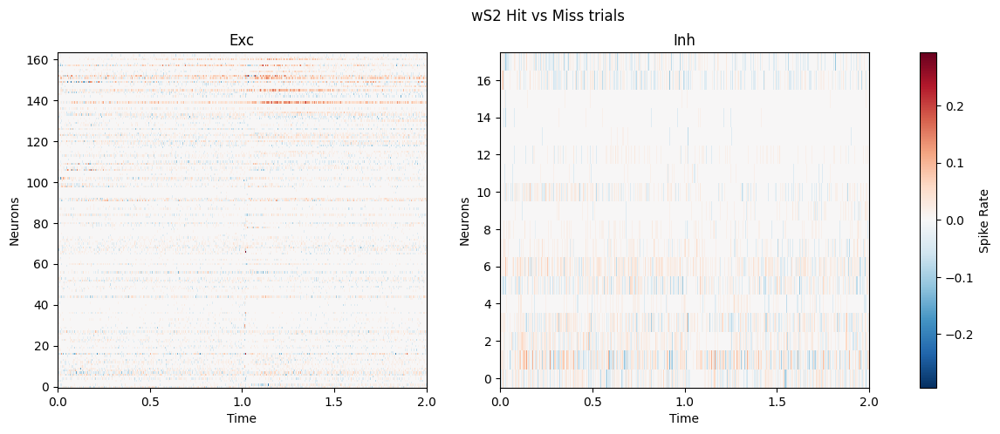

In [163]:
trial_mask_plus = (trial_info['trial_type'] == 1) & (trial_info['lick'] == 1)
trial_mask_minus = (trial_info['trial_type'] == 1) & (trial_info['lick'] == 0)
display_trial_average_differential_heatmap(trial_mask_plus, trial_mask_minus, title_trial="Hit vs Miss")

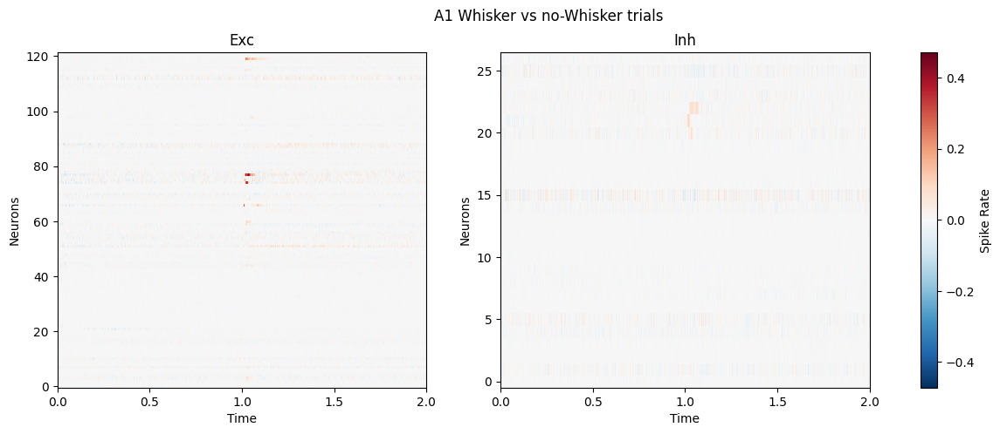

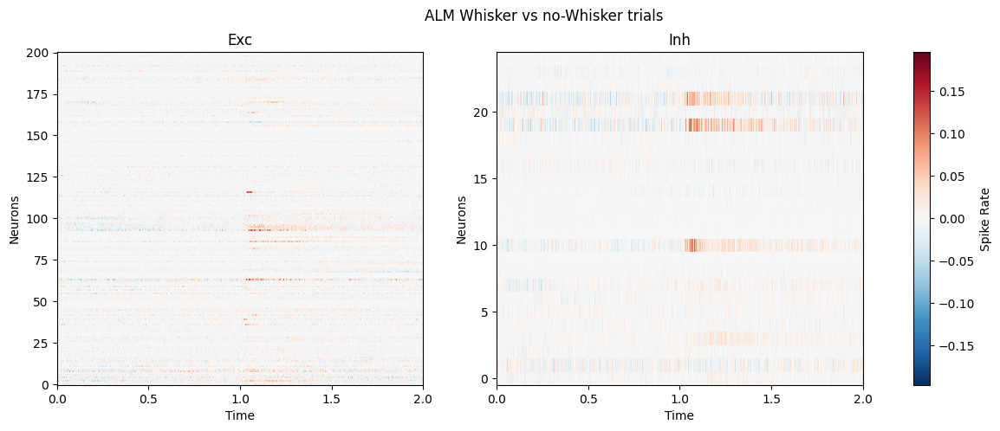

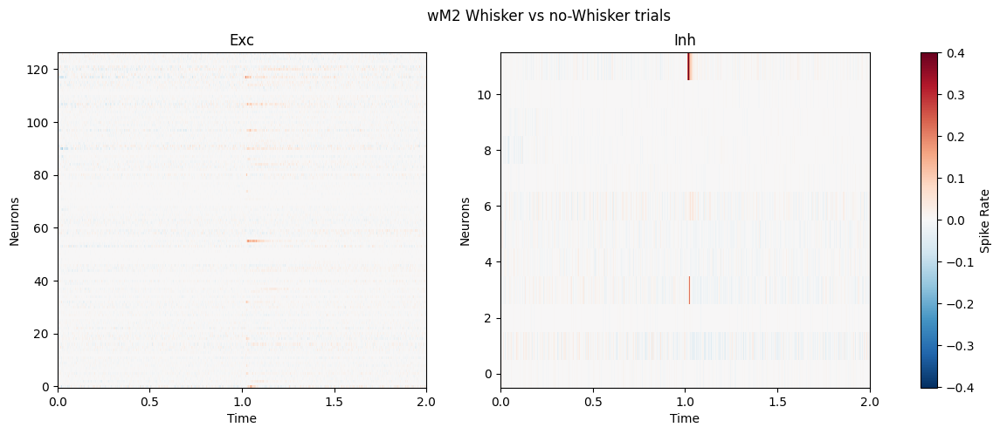

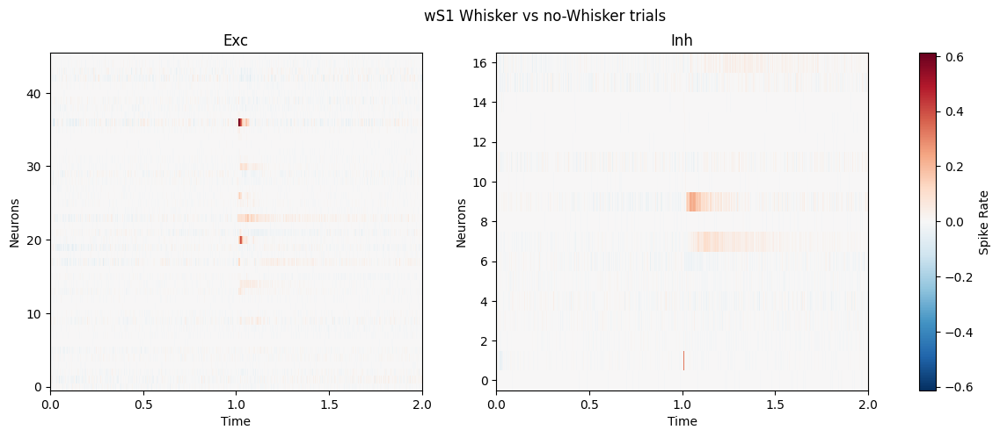

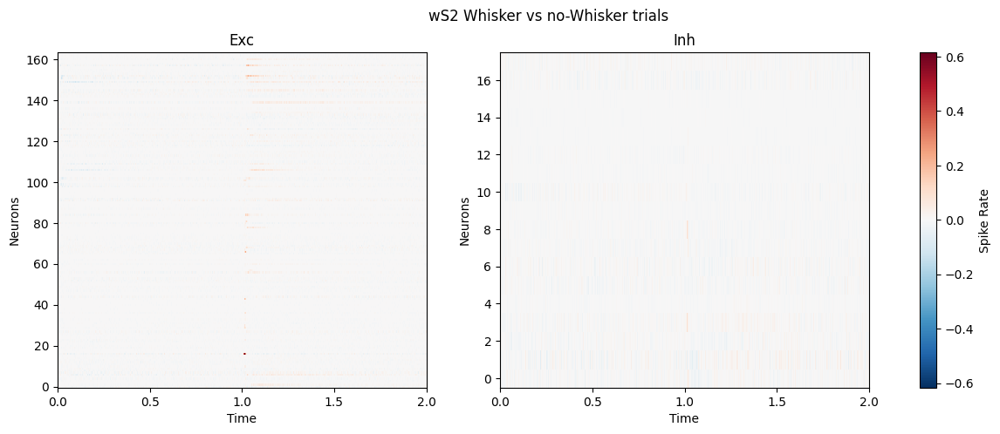

In [164]:
trial_mask_plus = np.isin(trial_info['trial_type'], [1, 3, 5])
trial_mask_minus = np.isin(trial_info['trial_type'], [2, 4])
display_trial_average_differential_heatmap(trial_mask_plus, trial_mask_minus, title_trial="Whisker vs no-Whisker")

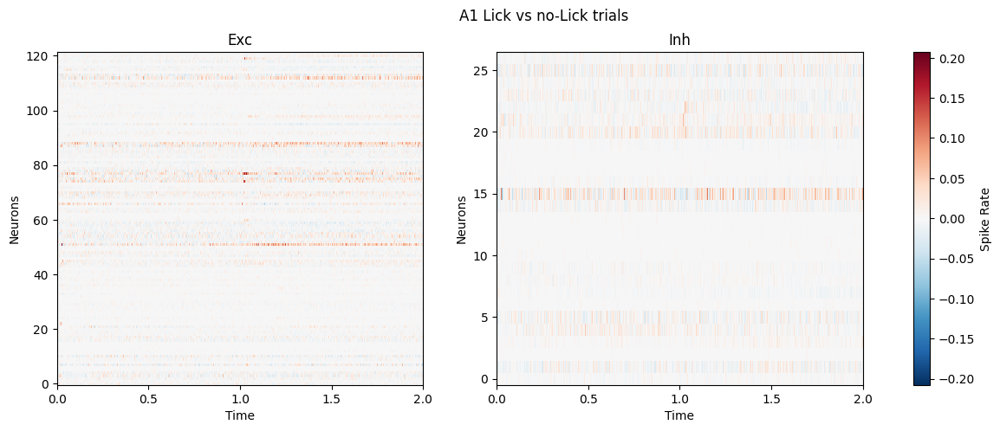

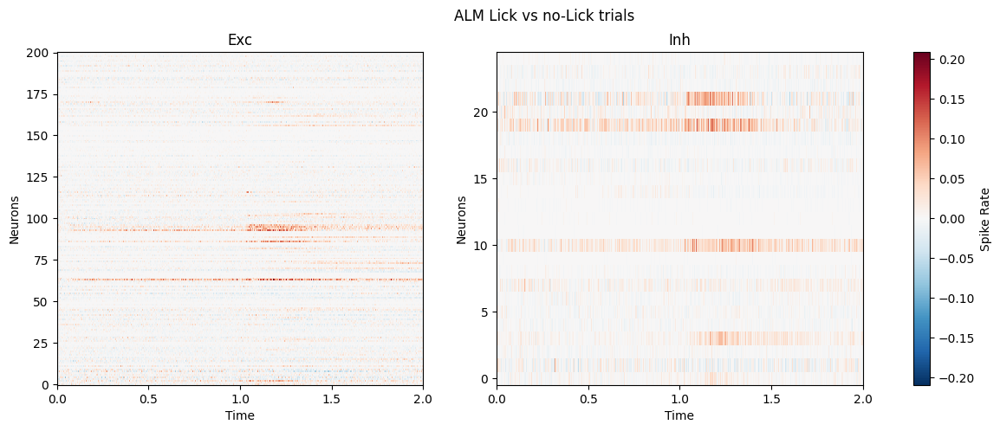

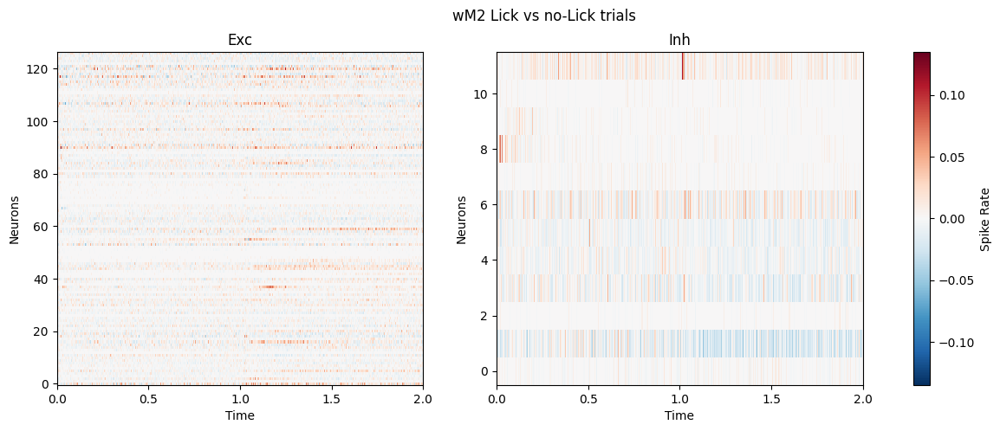

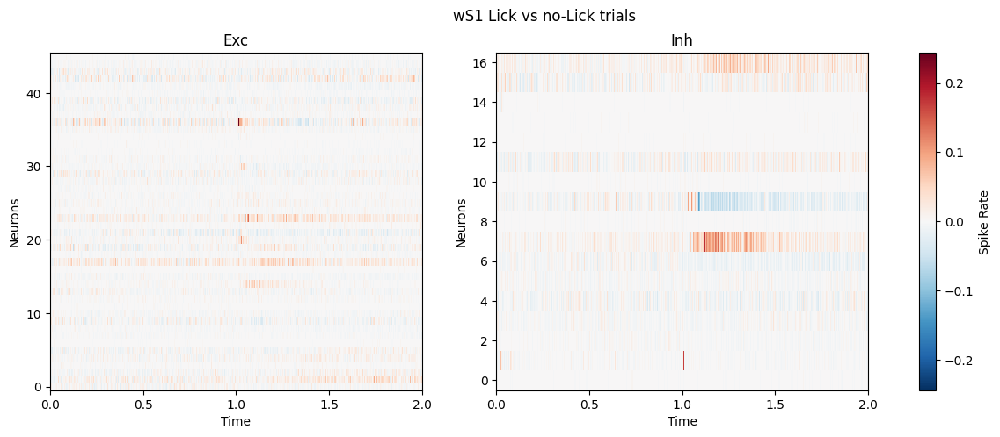

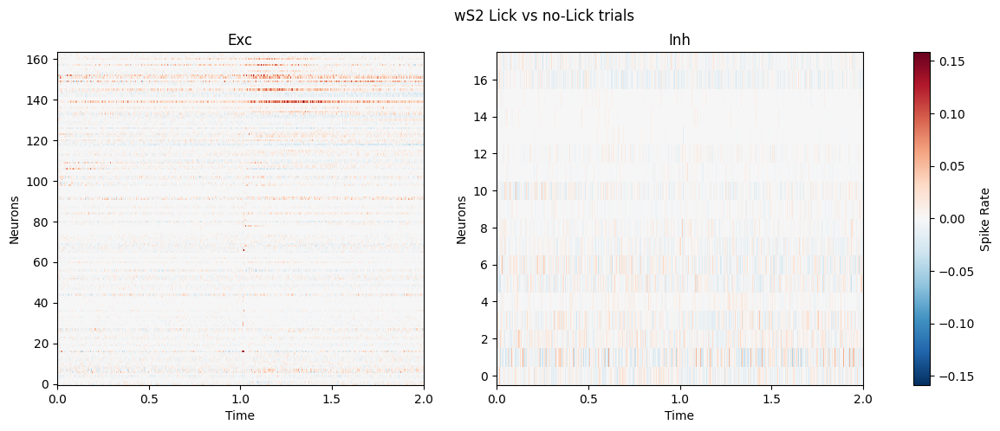

In [165]:
trial_mask_plus = trial_info['lick'] == 1
trial_mask_minus = ~trial_mask_plus
display_trial_average_differential_heatmap(trial_mask_plus, trial_mask_minus, title_trial="Lick vs no-Lick")

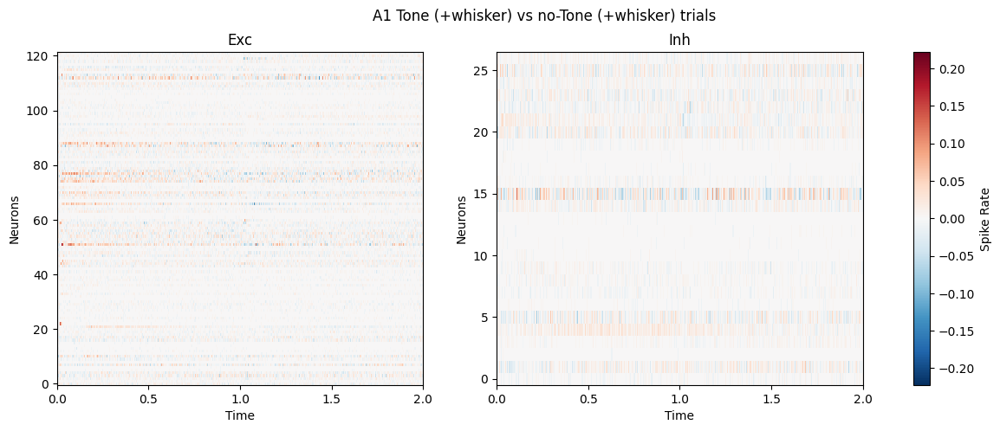

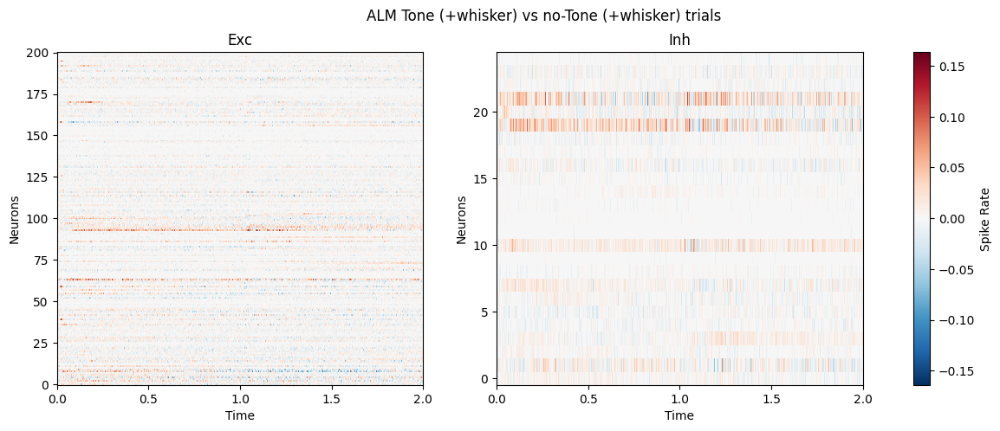

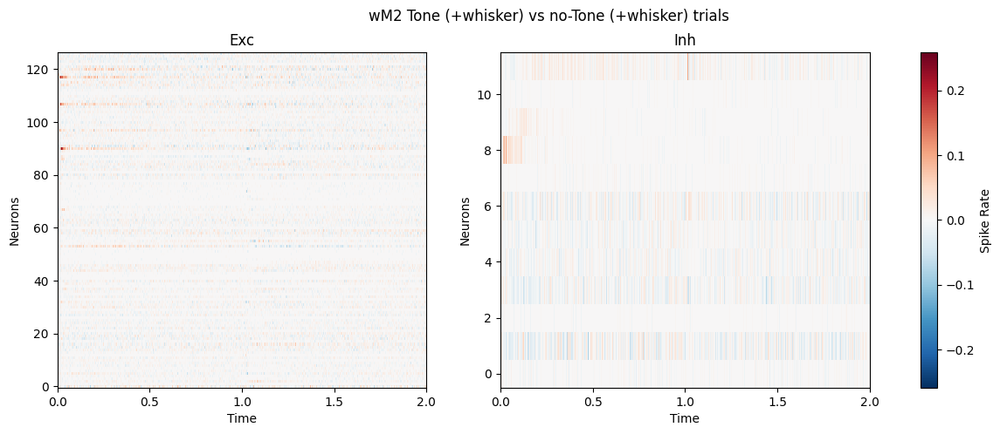

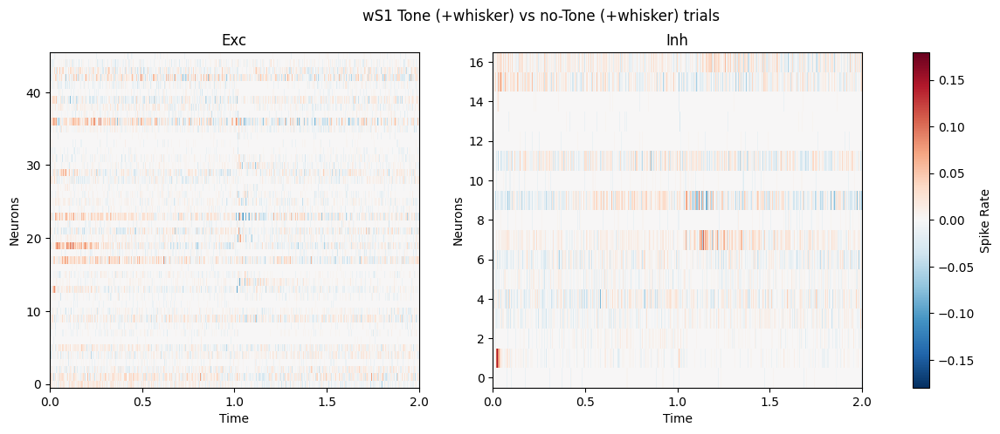

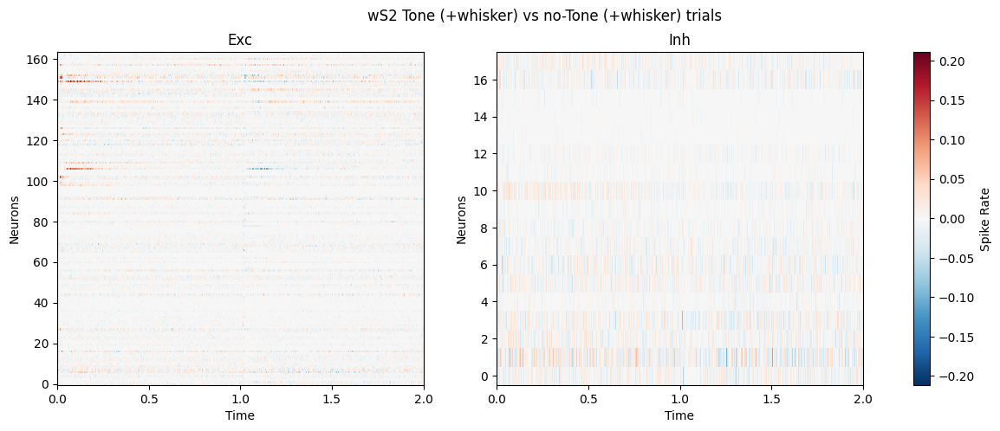

In [167]:
trial_mask_plus = np.isin(trial_info['trial_type'], [1, 3])
trial_mask_minus = np.isin(trial_info['trial_type'], [5])
display_trial_average_differential_heatmap(trial_mask_plus, trial_mask_minus, title_trial="Tone (+whisker) vs no-Tone (+whisker)")

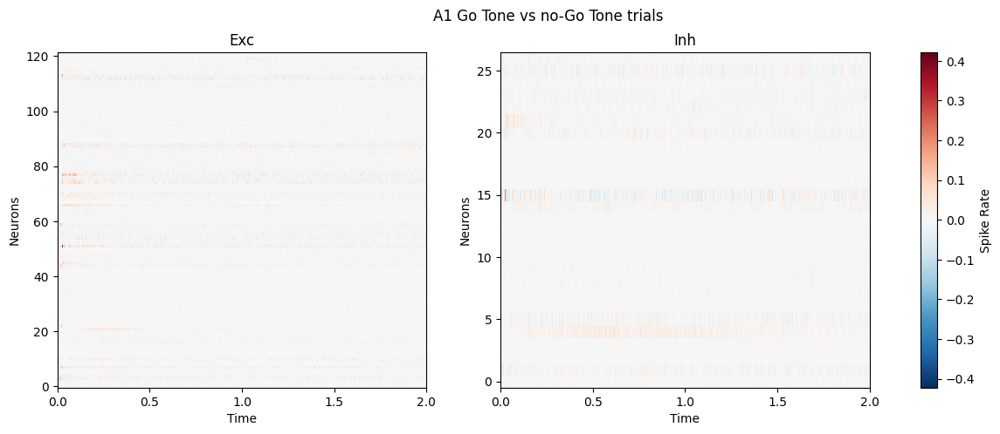

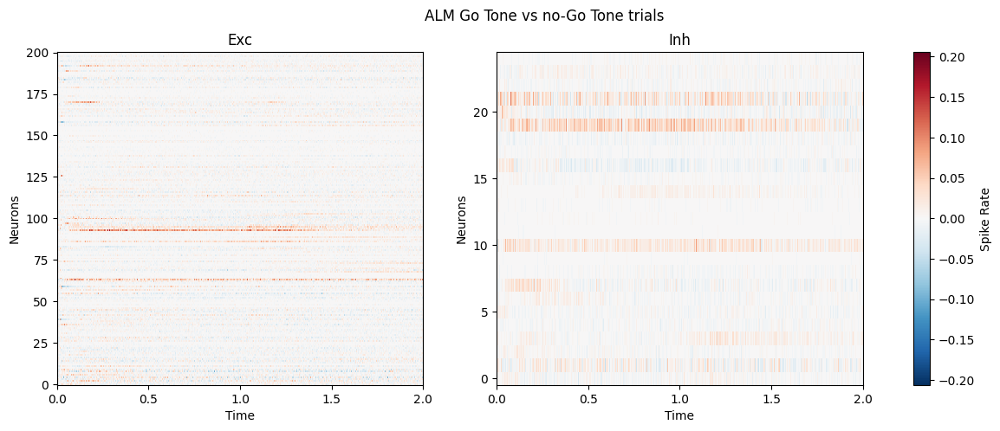

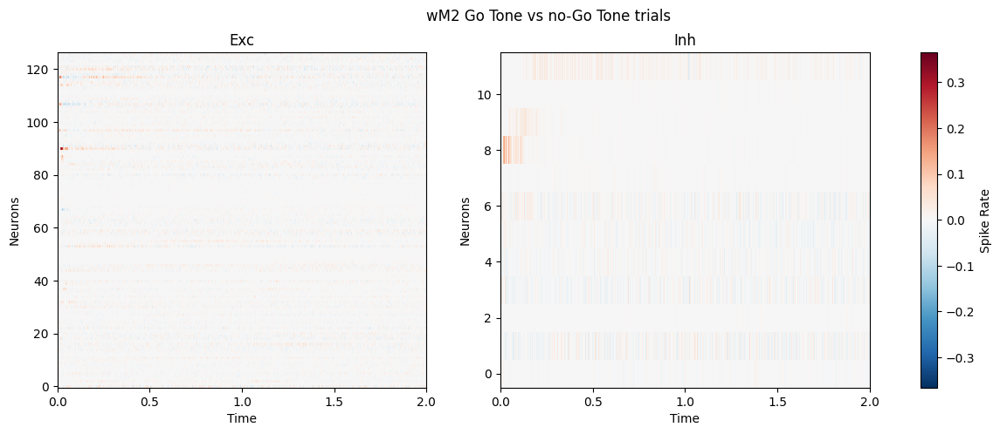

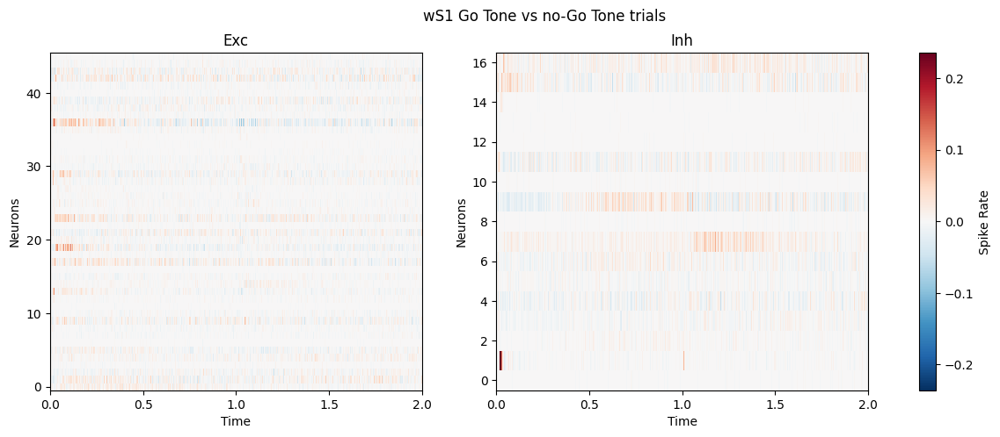

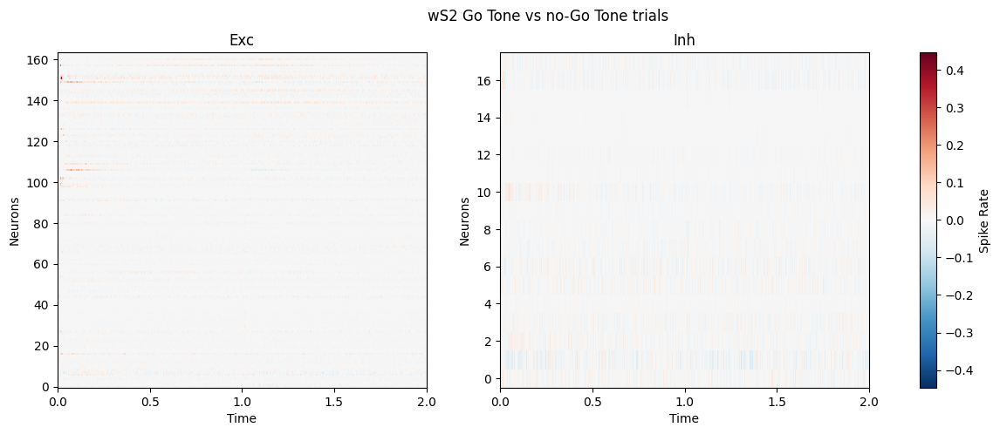

In [168]:
trial_mask_plus = np.isin(trial_info['trial_type'], [1, 2])
trial_mask_minus = np.isin(trial_info['trial_type'], [3, 4])
display_trial_average_differential_heatmap(trial_mask_plus, trial_mask_minus, title_trial="Go Tone vs no-Go Tone")

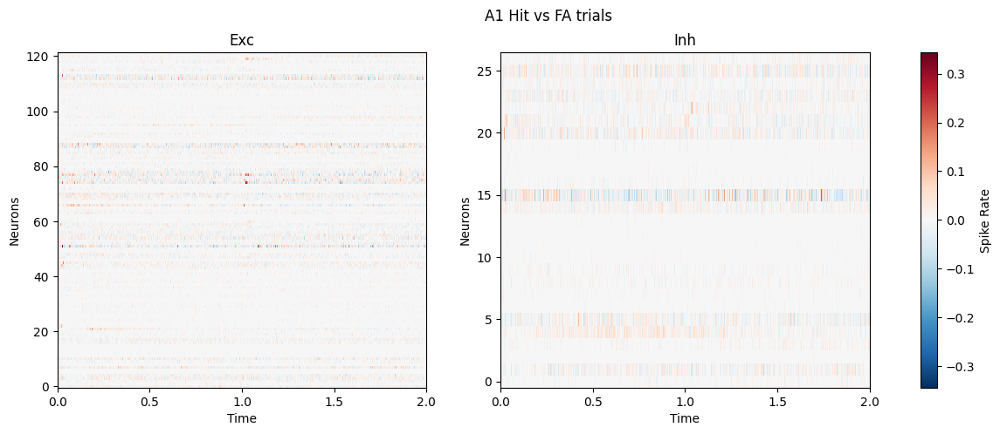

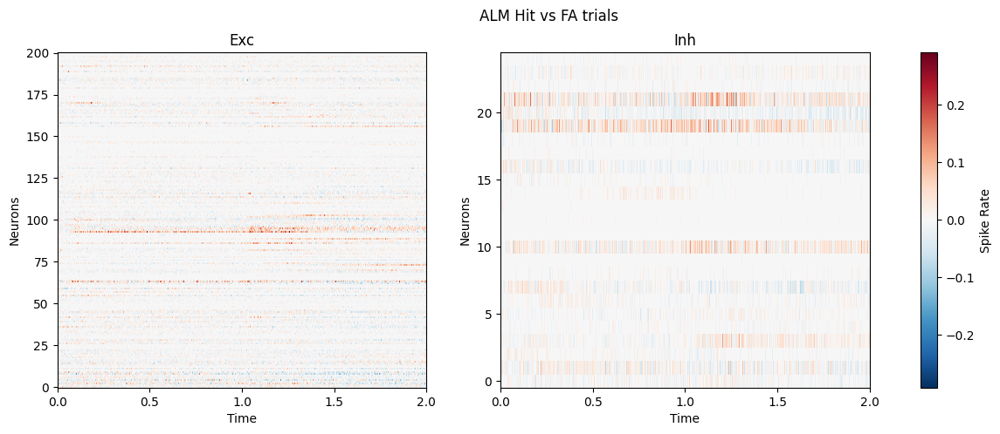

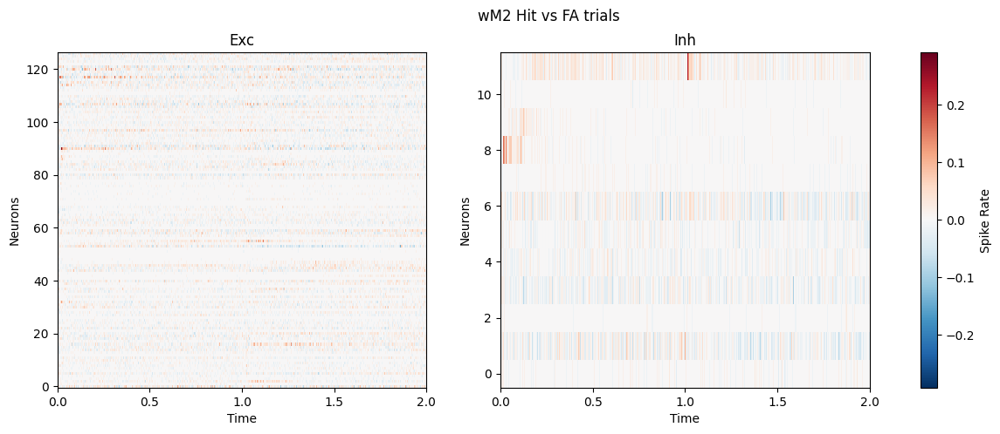

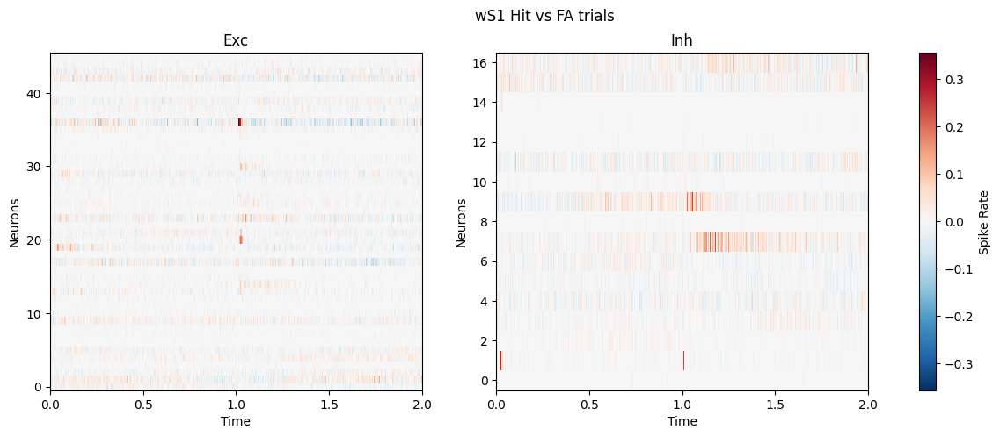

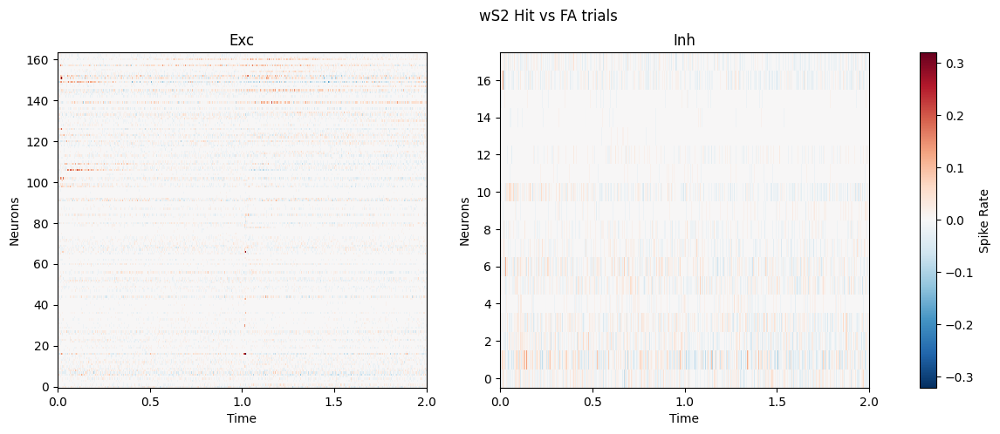

In [170]:
trial_mask_plus = (trial_info['trial_type'] == 1) & (trial_info['lick'] == 1)
trial_mask_minus = np.isin(trial_info['trial_type'], [2, 3, 4, 5]) & trial_info['lick'] == 1
display_trial_average_differential_heatmap(trial_mask_plus, trial_mask_minus, title_trial="Hit vs FA")

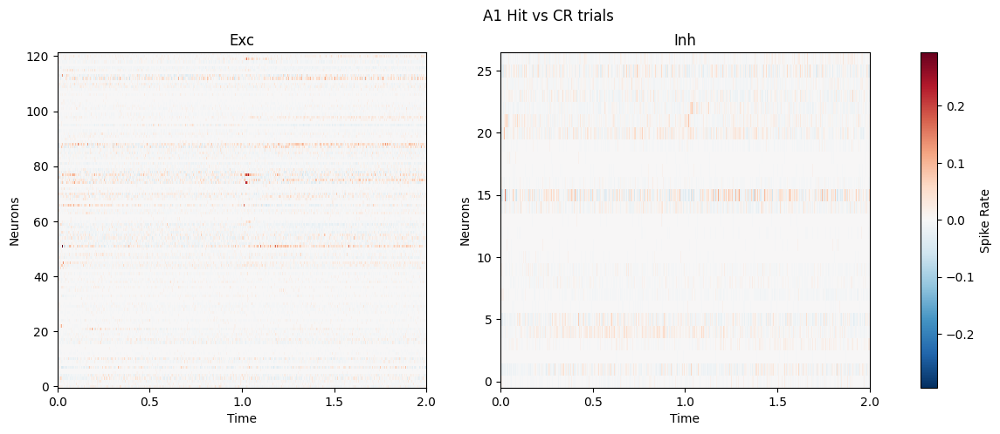

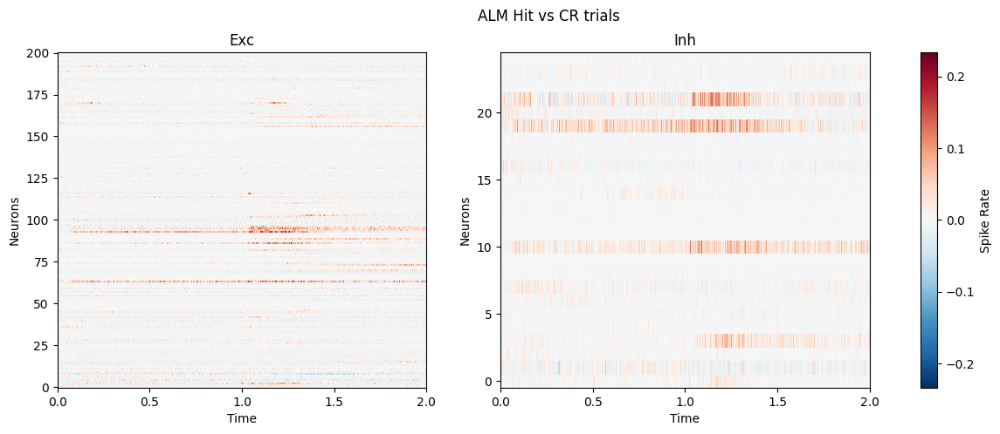

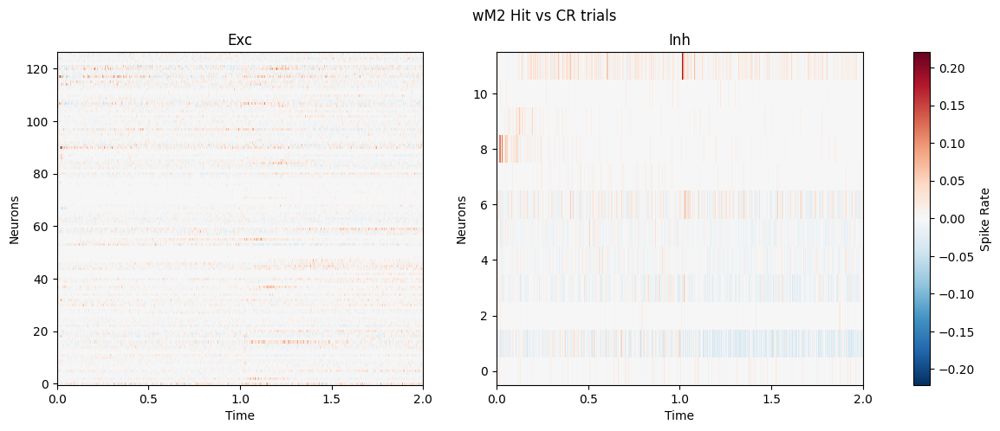

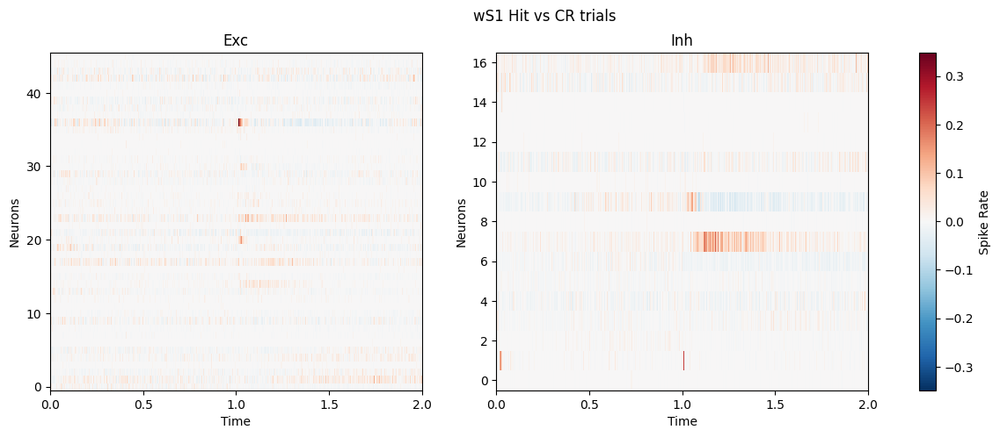

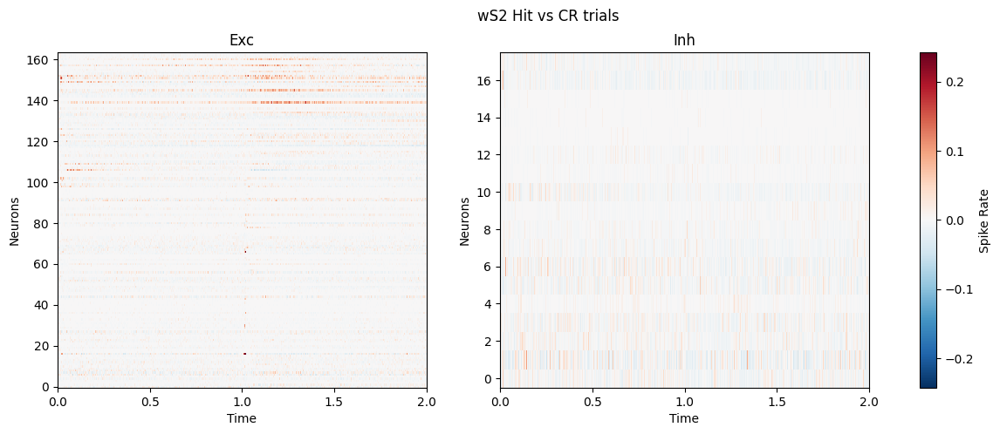

In [171]:
trial_mask_plus = (trial_info['trial_type'] == 1) & (trial_info['lick'] == 1)
trial_mask_minus = np.isin(trial_info['trial_type'], [2, 3, 4, 5]) & trial_info['lick'] == 0
display_trial_average_differential_heatmap(trial_mask_plus, trial_mask_minus, title_trial="Hit vs CR")

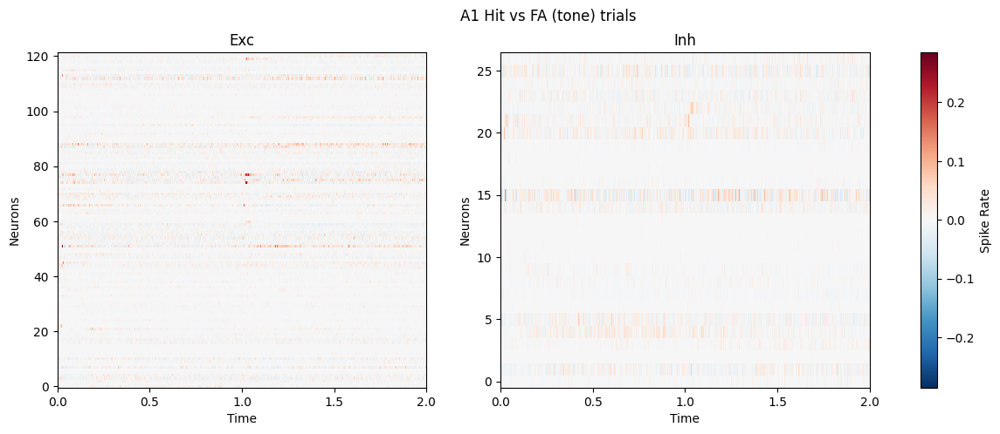

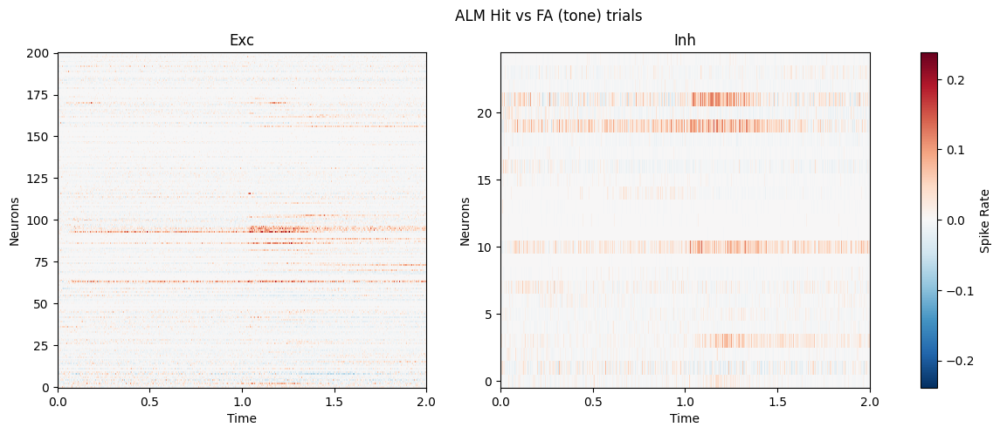

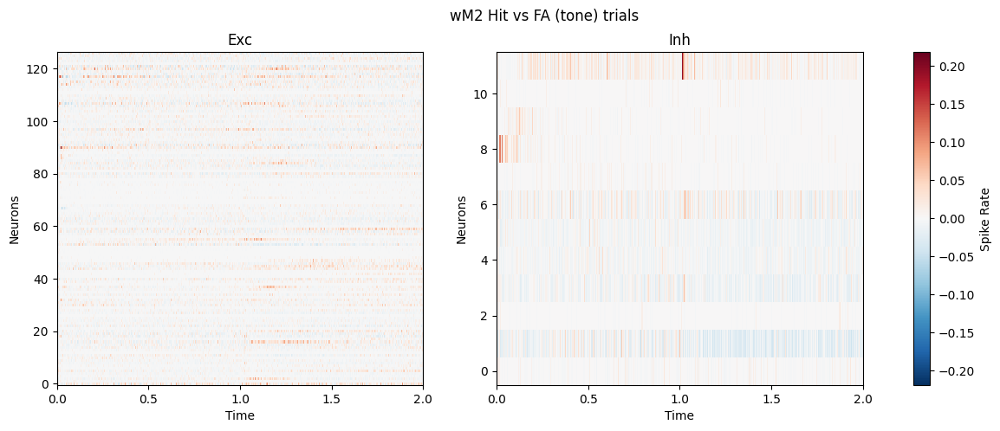

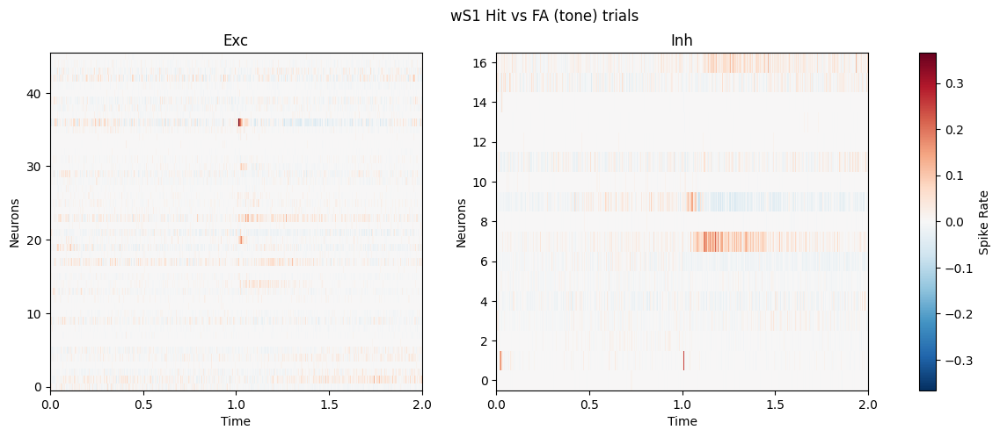

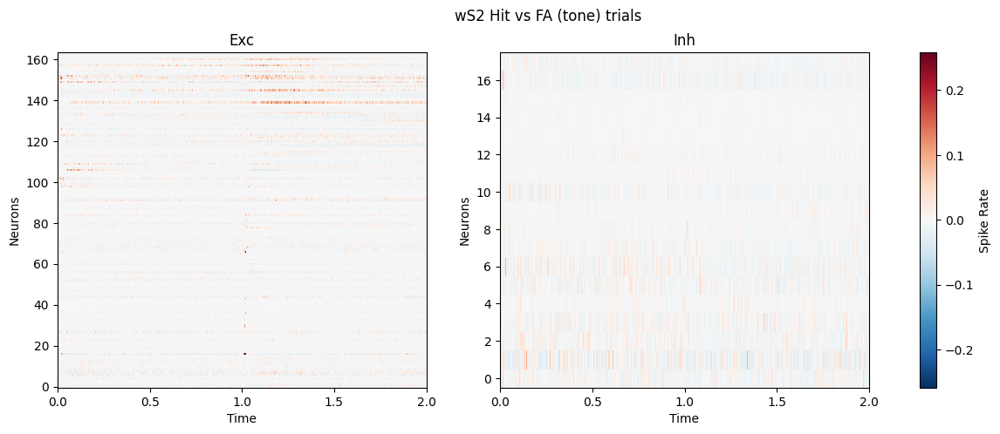

In [173]:
trial_mask_plus = (trial_info['trial_type'] == 1) & (trial_info['lick'] == 1)
trial_mask_minus = np.isin(trial_info['trial_type'], [3, 5]) & trial_info['lick'] == 0
display_trial_average_differential_heatmap(trial_mask_plus, trial_mask_minus, title_trial="Hit vs FA (tone)")

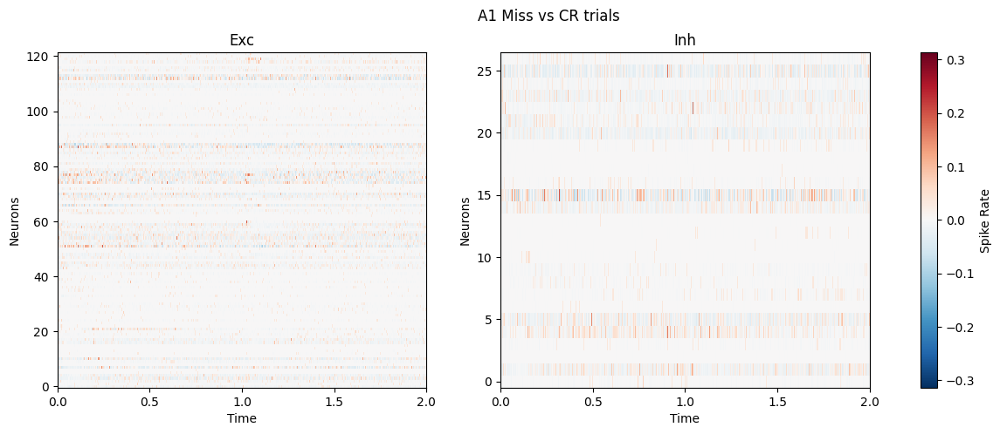

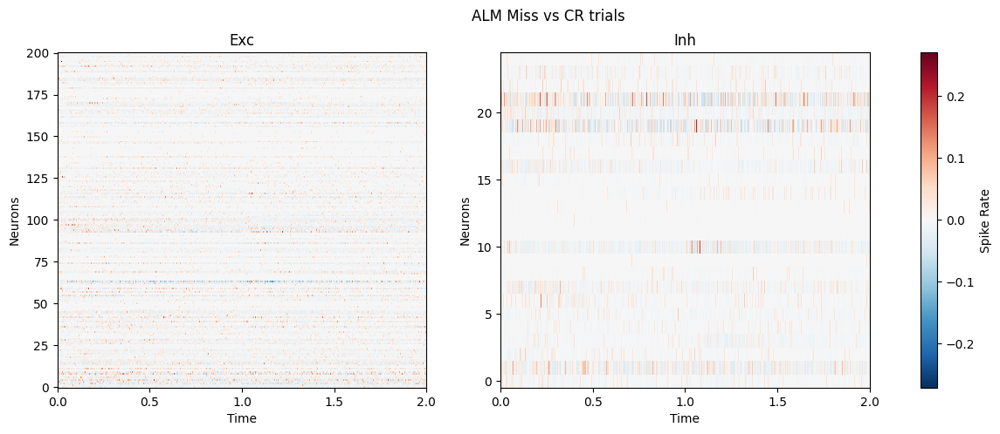

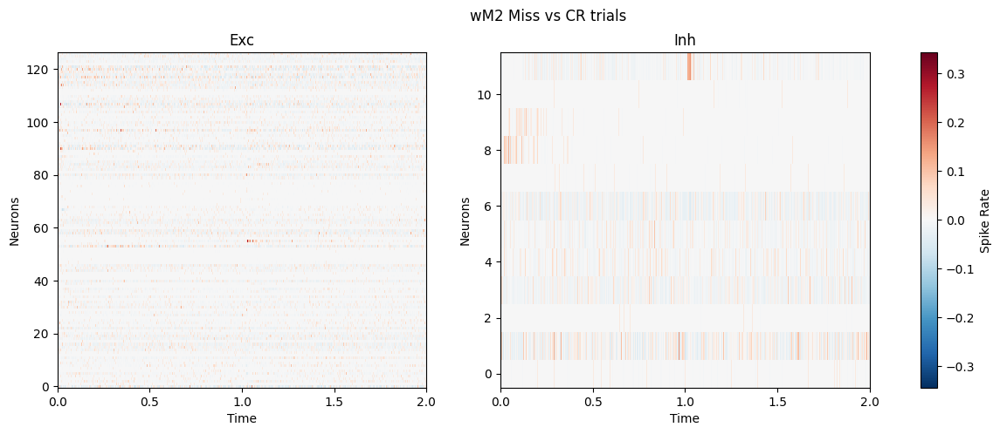

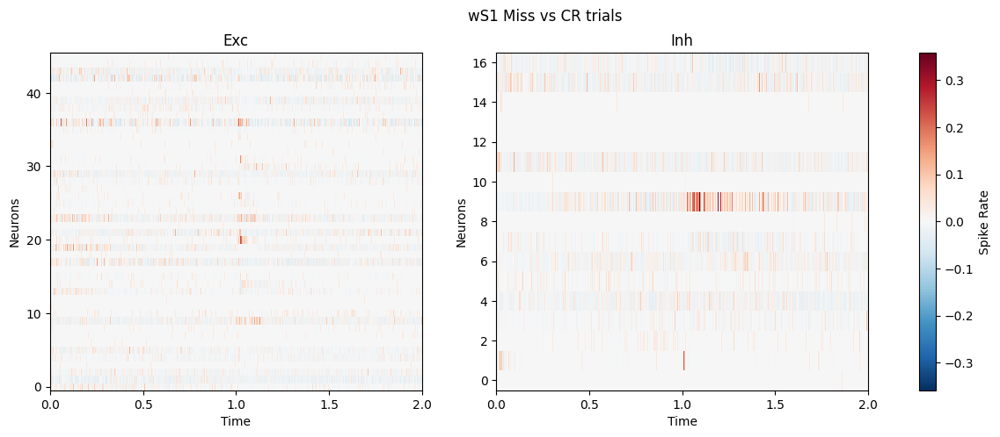

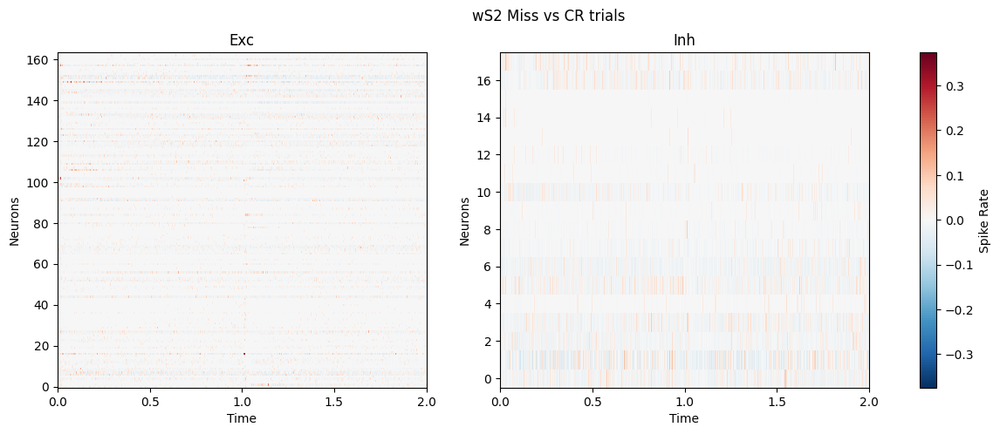

In [174]:
trial_mask_plus = (trial_info['trial_type'] == 1) & (trial_info['lick'] == 0)
trial_mask_minus = np.isin(trial_info['trial_type'], [2, 3, 4, 5]) & trial_info['lick'] == 0
display_trial_average_differential_heatmap(trial_mask_plus, trial_mask_minus, title_trial="Miss vs CR")

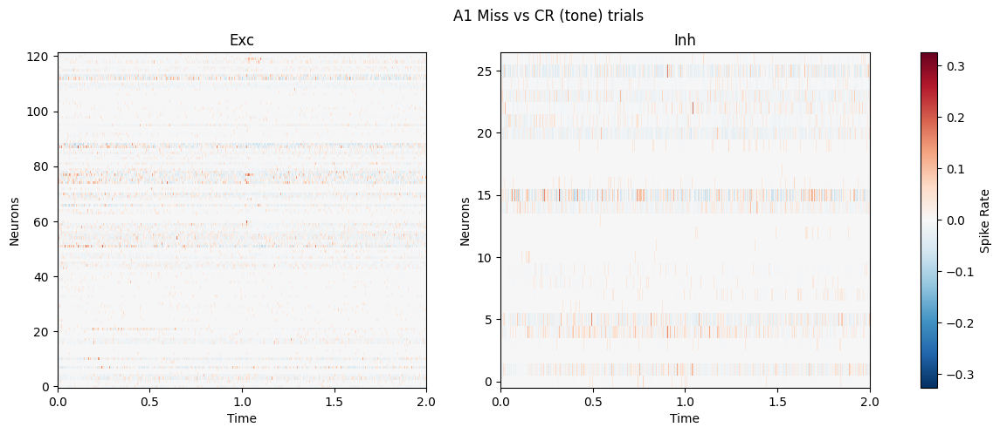

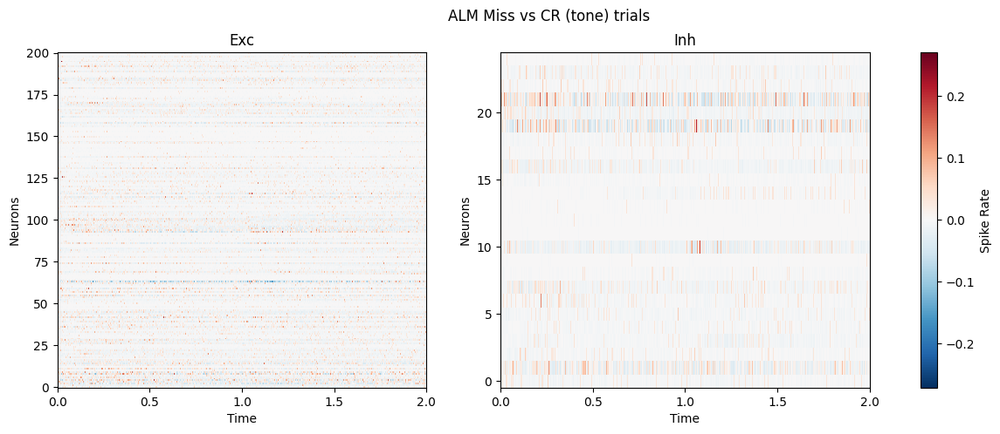

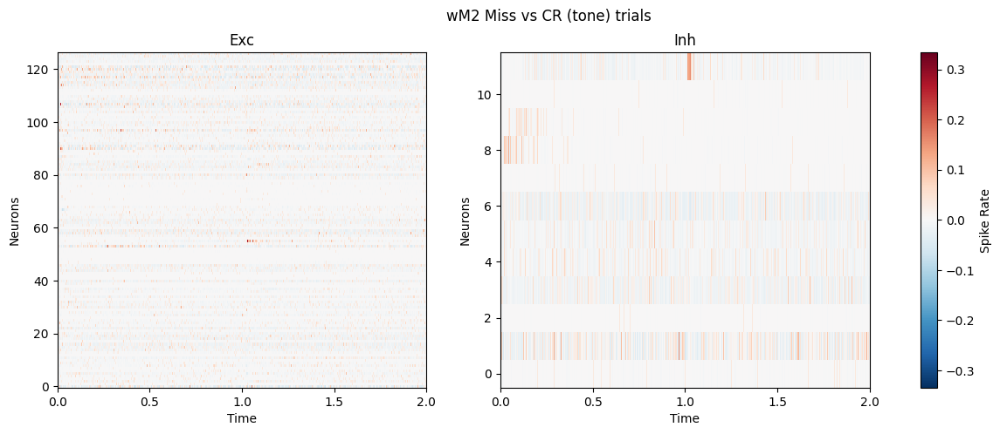

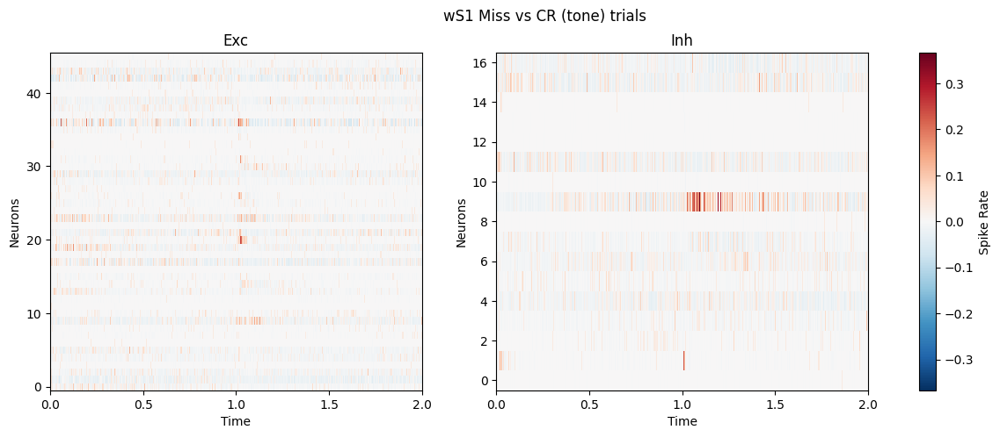

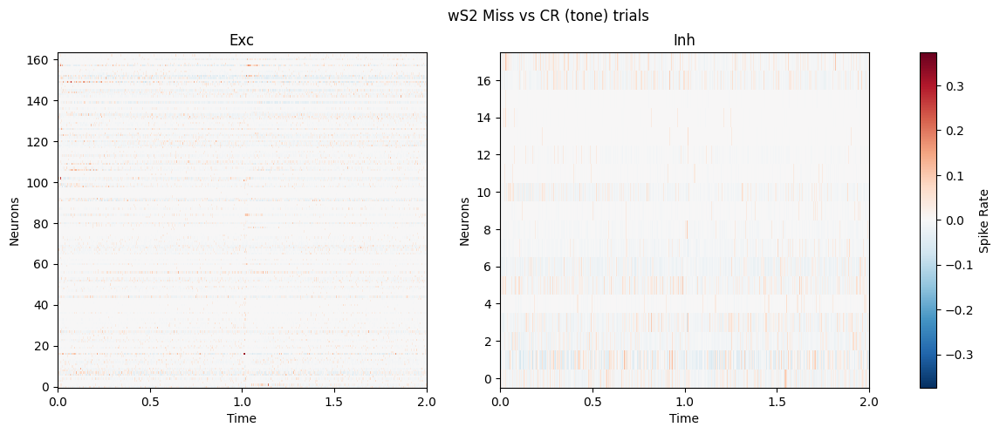

In [177]:
trial_mask_plus = (trial_info['trial_type'] == 1) & (trial_info['lick'] == 0)
trial_mask_minus = np.isin(trial_info['trial_type'], [3, 5]) & trial_info['lick'] == 0
display_trial_average_differential_heatmap(trial_mask_plus, trial_mask_minus, title_trial="Miss vs CR (tone)")

What seems to encode the lick subject to the go tone and whisker stimulation is the sustained activity in ALM (excitatory & inhibitory) (with some increased activity in wS1 inhibitory neuron and post whisker stimulation in wS2), with cumulative response across neurons when adding the whisker stimulation to the audio cue triggered sustained activity. This in turns results in the decrease of activation of inhibitory neuron index 9 in wS1 during the whisker stimulation. In contrast, in miss trials, this inhibitory neuron is more active than when it doesn't choose to lick. Showing a difference in behaviour between miss trials and correct rejection.

Interestingly, increased firing post whisker stimulation in inhibitory neuron in ALM doesn't result in clear observable decreased activity in the excitatory neurons (some neurons fire less overall, possibly due to the overall increased activity of inhibitory for the entire trial duration). Those inhibitory neurons selectively firing more post-whisker stimulation could be explained by Inh $\rightarrow$ Inh $\rightarrow$ Exc, explaining some of the patterned increased and sustained firing activity in excitatory neurons post whisker stimulation

TODO:
- find a way to filter those neurons that fire stastitically more across the compared conditions. Study more precisely their activity in isolation and cluster them
- use the lick time information to pinpoint some of the neurons associated with licking, and show if the averaging is appropriate or if there is licking events occuring at non-systematic times which require to adjust the trigger averaging.
- possibly train predictor to say when the model licks, not just if, we need to compare properly